In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.stats import gaussian_kde
from stockwell import st
np.random.seed(42)


In [2]:
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams.update({
    "font.size": 12,
    "axes.titlesize": 16,
    "axes.labelsize": 14,
    "xtick.labelsize": 12,
    "ytick.labelsize": 12,
    "legend.fontsize": 12,
    "figure.titlesize": 18,
    "figure.figsize": (12, 6)
})

print("Matplotlib style configured.")

Matplotlib style configured.


## NUST functions

In [3]:

def estimate_sampling_density_kde(times, bandwidth=None):
    
    if len(times) < 2:
     
        return None, None
        
    n = len(times)
    std_dev = np.std(times)
    
   
    if bandwidth is None:
        bandwidth = 1.06 * std_dev * (n ** (-1/5))
    
    bw_method = bandwidth / std_dev if std_dev > 0 else 0.1
    
    kde = gaussian_kde(times, bw_method=bw_method)
    
    return kde, bandwidth


In [4]:

def adaptive_window_std(tau, frequency, kde, alpha=1.0, gamma=0.5):
    
    if frequency <= 0 or kde is None:
        return np.inf 
    sigma_base = alpha / abs(frequency)
    
    if gamma == 0:
        return sigma_base

    local_density = max(kde(tau)[0], 1e-10)

    sigma_adaptive = sigma_base * (local_density ** (-gamma))
    
    return sigma_adaptive

print("Core NUST component functions defined.")

Core NUST component functions defined.


In [6]:
def nust(times, data, uncertainties, tau_grid, freq_grid, 
         use_voronoi_weights=False, use_adaptive_window=True,
         alpha=1.0, gamma=0.5, kde_bandwidth=None):
    
    N_tau, N_freq = len(tau_grid), len(freq_grid)
    nust_result = np.zeros((N_tau, N_freq))
    
    measurement_weights = 1.0 / uncertainties**2
    
    voronoi_weights = compute_voronoi_weights_1d(times) if use_voronoi_weights else np.ones_like(times)
    
    kde = None
    if use_adaptive_window:
        kde, _ = estimate_sampling_density_kde(times, bandwidth=kde_bandwidth)

    print(f"Computing NUST ({N_tau}τ x {N_freq}f = {N_tau * N_freq} points)...")
    
    for i, tau in enumerate(tau_grid):
        if (i + 1) % (N_tau // 5) == 0:
            print(f"  Progress: {((i + 1) / N_tau) * 100:.0f}%")
            
        for j, freq in enumerate(freq_grid):
            if freq <= 0:
                continue

            if use_adaptive_window and kde:
                sigma_t = adaptive_window_std(tau, freq, kde, alpha, gamma)
            else: 
                sigma_t = alpha / abs(freq)
            gaussian_weights = np.exp(-0.5 * ((times - tau) / sigma_t)**2)
            
            total_weights = measurement_weights * voronoi_weights * gaussian_weights
            significant_mask = gaussian_weights > 0.001 # Window truncation threshold
            if np.sum(significant_mask) < 5: # Need at least 5 points for a stable fit
                continue
                
            t_local = times[significant_mask]
            y_local = data[significant_mask]
            w_local = total_weights[significant_mask]
            
            omega = 2 * np.pi * freq
            
            try:
                A = np.vstack([np.cos(omega * t_local), np.sin(omega * t_local), np.ones_like(t_local)]).T
                W = np.diag(w_local)
                
                AtWA = A.T @ W @ A
                AtWy = A.T @ W @ y_local
                
                # Coefficients [a, b, c]
                theta = np.linalg.solve(AtWA, AtWy)
                
                y_pred = A @ theta
                residuals = y_local - y_pred
                ss_res = np.sum(w_local * residuals**2)
                
                y_mean_weighted = np.sum(w_local * y_local) / np.sum(w_local)
                ss_tot = np.sum(w_local * (y_local - y_mean_weighted)**2)
                
                if ss_tot > 0:
                    r_squared = 1 - (ss_res / ss_tot)
                    nust_result[i, j] = max(0, r_squared) # Power cannot be negative
                    
            except (np.linalg.LinAlgError, ValueError):
                # This can happen if the matrix is singular, e.g., if all t_local are the same.
                continue
    
    print("NUST computation complete!")
    return nust_result

print("Unified NUST function defined.")

Unified NUST function defined.


In [ ]:
def compute_lomb_scargle(times, data, uncertainties, freq_grid):
    angular_freqs = 2 * np.pi * freq_grid
    
    power = signal.lombscargle(times, data, angular_freqs, precenter=True, normalize=True)
    
    return power

print("Lomb-Scargle helper function defined.")

Lomb-Scargle helper function defined.


## test signals with controlled  random sampling for robustness test

In [8]:
def generate_experiment1_signal_evenly_sampled():
    np.random.seed(42)
    
    duration = 150  # days
    fs = 1.0  # 1 sample per day
    times = np.arange(0, duration, 1/fs)
    N = len(times)
    
    # Persistent signal
    persistent_freq = 0.07  # cycles per day
    persistent_signal = 0.4 * np.sin(2 * np.pi * persistent_freq * times)
    
    # Transient signal (first 60 days with decay)
    transient_freq = 0.1  # cycles per day
    transient_mask = times < 60
    transient_signal = np.zeros(N)
    if np.any(transient_mask):
        t_trans = times[transient_mask]
        decay = np.exp(-(t_trans - t_trans.min()) / 30)  # 30-day decay
        transient_signal[transient_mask] = 0.8 * decay * np.sin(2 * np.pi * transient_freq * t_trans)
    
    # Combined signal
    signal_clean = persistent_signal + transient_signal
    noise = np.random.normal(0, 0.15, N)
    data = signal_clean + noise
    
    return times, data, fs, {
        'persistent_freq': persistent_freq,
        'transient_freq': transient_freq,
        'description': 'Persistent + Transient (evenly sampled)'
    }


def generate_experiment3_signal_evenly_sampled():
    np.random.seed(456)
    
    duration = 150  # days
    fs = 1.0  # 1 sample per day
    times = np.arange(0, duration, 1/fs)
    N = len(times)
    
    # Linear chirp in middle region
    chirp_mask = (times > 50) & (times < 100)
    signal_clean = np.zeros(N)
    
    if np.any(chirp_mask):
        t_chirp = times[chirp_mask]
        t_norm = (t_chirp - 50) / 50  # Normalize to [0,1]
        
        # Linear chirp: f(t) = f_start + (f_end - f_start) * t
        f_start, f_end = 0.1, 0.15  # cycles per day
        
        phase = 2 * np.pi * (f_start * t_norm + 0.5 * (f_end - f_start) * t_norm**2) * 50
        signal_clean[chirp_mask] = 0.8 * np.sin(phase)
    
    noise = np.random.normal(0, 0.12, N)
    data = signal_clean + noise
    
    return times, data, fs, {
        'f_start': f_start,
        'f_end': f_end,
        'description': 'Linear chirp (evenly sampled)'
    }

#

In [9]:
def generate_experiment1_signal():
    np.random.seed(42)
    
    times = []
    times.extend(np.random.uniform(0, 40, 80))
    times.extend(np.random.uniform(50, 90, 60))
    times.extend(np.random.uniform(100, 150, 40))
    
    times = np.sort(times)
    N = len(times)
    
    # Persistent signal
    persistent_freq = 0.07
    persistent_signal = 0.4 * np.sin(2 * np.pi * persistent_freq * times)
    
    # Transient signal (first 60 days with decay)
    transient_freq = 0.1
    transient_mask = times < 60
    transient_signal = np.zeros(N)
    if np.any(transient_mask):
        t_trans = times[transient_mask]
        decay = np.exp(-(t_trans - t_trans.min()) / 30)  # 30-day decay
        transient_signal[transient_mask] = 0.8 * decay * np.sin(2 * np.pi * transient_freq * t_trans)
    
    # Combined signal
    signal_clean = persistent_signal + transient_signal
    noise = np.random.normal(0, 0.15, N)
    data = signal_clean + noise
    uncertainties = 0.15 * np.ones(N)
    
    return times, data, uncertainties, {
        'persistent_freq': persistent_freq,
        'transient_freq': transient_freq,
        'transient_mask': transient_mask,
        'clean_signal': signal_clean,
        'description': 'Persistent + Transient with realistic gaps'
    }


def generate_experiment3_signal():
    
    np.random.seed(456)
    
    times = []
    times.extend(np.random.uniform(0, 50, 40))        # Moderate early
    times.extend(np.random.uniform(50, 100, 150))     # DENSE middle (chirp region)
    times.extend(np.random.uniform(100, 150, 40))     # Moderate late
    
    times = np.sort(times)
    N = len(times)
    
    # Linear chirp in dense region
    chirp_mask = (times > 50) & (times < 100)
    signal_clean = np.zeros(N)
    
    if np.any(chirp_mask):
        t_chirp = times[chirp_mask]
        t_norm = (t_chirp - 50) / 50  # Normalize to [0,1]
        
        # Linear chirp: f(t) = f_start + (f_end - f_start) * t
        f_start, f_end = 0.1, 0.15
        instantaneous_freq = f_start + (f_end - f_start) * t_norm
        
        phase = 2 * np.pi * (f_start * t_norm + 0.5 * (f_end - f_start) * t_norm**2) * 50
        signal_clean[chirp_mask] = 0.8 * np.sin(phase)
    
    noise = np.random.normal(0, 0.12, N)
    data = signal_clean + noise
    uncertainties = 0.12 * np.ones(N)
    
    return times, data, uncertainties, {
        'f_start': 0.1,
        'f_end': 0.15,
        'chirp_mask': chirp_mask,
        'clean_signal': signal_clean,
        'description': 'Linear chirp in dense region'
    }


In [10]:
def generate_signal_0_even():
    fs = 1.0
    times = np.arange(0, 150, 1/fs)
    N = len(times)
    freq = 0.05
    signal_clean = 0.8 * np.sin(2 * np.pi * freq * times)
    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    return times, data, fs, {'freq': freq, 'description': 'Simple Sinusoid (Even)'}

def generate_signal_0_uneven():
    np.random.seed(42)  # For reproducibility
    times = np.concatenate([
        np.sort(np.random.uniform(0, 50, 70)),
        np.sort(np.random.uniform(100, 150, 70)),
    ])
    N = len(times)
    freq = 0.05
    signal_clean = 0.8 * np.sin(2 * np.pi * freq * times)
    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.2)
    return times, data, uncertainties, {'freq': freq, 'description': 'Simple Sinusoid (Uneven)'}


# --- Test Case 1: Persistent + Transient Signal ---

def generate_signal_1_even():
    """Reusing your evenly sampled experiment 1."""
    return generate_experiment1_signal_evenly_sampled()

def generate_signal_1_uneven():
    """Reusing your unevenly sampled experiment 1."""
    return generate_experiment1_signal()


# --- Test Case 2: High-Frequency Burst in a Sparse Region ---

def generate_signal_2_even():
    """Generates an evenly sampled signal with a high-frequency burst."""
    fs = 1.0
    times = np.arange(0, 200, 1/fs)
    N = len(times)
    burst_mask = (times > 95) & (times < 105)
    signal_clean = np.zeros(N)
    signal_clean[burst_mask] = 1.0 * np.sin(2 * np.pi * 0.4 * times[burst_mask])
    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    return times, data, fs, {'burst_freq': 0.4, 'description': 'HF Burst (Even)'}

def generate_signal_2_uneven():
    """Generates a signal where a high-frequency burst occurs in a sparsely sampled region."""
    times = np.concatenate([
        np.sort(np.random.uniform(0, 90, 120)),      # Dense before
        np.sort(np.random.uniform(90, 110, 15)),     # Sparse during burst
        np.sort(np.random.uniform(110, 200, 120)),   # Dense after
    ])
    N = len(times)
    burst_mask = (times > 95) & (times < 105)
    signal_clean = np.zeros(N)
    signal_clean[burst_mask] = 1.0 * np.sin(2 * np.pi * 0.4 * times[burst_mask])
    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.2)
    return times, data, uncertainties, {'burst_freq': 0.4, 'description': 'HF Burst in Sparse Data (Uneven)'}


# --- Test Case 3: Linear Chirp in a Dense Region ---

def generate_signal_3_even():
    """Reusing your evenly sampled experiment 3."""
    return generate_experiment3_signal_evenly_sampled()

def generate_signal_3_uneven():
    """Reusing your unevenly sampled experiment 3."""
    return generate_experiment3_signal()

print("All signal generation functions defined for 4 test cases.")

All signal generation functions defined for 4 test cases.


## plotting function 1

In [11]:
def run_and_plot_comparison(case_number, even_gen_func, uneven_gen_func, freq_grid, nust_params):
    
    print(f"\n{'='*60}\nRunning Analysis for Test Case {case_number}: {even_gen_func()[3]['description']}\n{'='*60}")
    
    # --- 1. Analyze Evenly Sampled Signal with S-Transform ---
    times_even, data_even, fs, info_even = even_gen_func()
    st_result = st.st(data_even)
    # Power is the squared magnitude, normalized for comparison
    st_power = np.abs(st_result)**2
    st_power_normalized = st_power / np.max(st_power)
    
    # --- 2. Analyze Unevenly Sampled Signal with NUST ---
    times_uneven, data_uneven, uncertainties_uneven, info_uneven = uneven_gen_func()
    tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100) # 100 time steps for NUST
    
    nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, 
                      tau_grid, freq_grid, **nust_params)
    
    # --- 3. Create the Comparison Plot ---
    fig, axes = plt.subplots(2, 2, figsize=(18, 10), gridspec_kw={'height_ratios': [1, 3]})
    fig.suptitle(f'Test Case {case_number}: {info_uneven["description"]}', fontsize=18, fontweight='bold')
    
    # Plot A: Evenly sampled signal
    axes[0, 0].plot(times_even, data_even, 'b-', lw=0.8)
    axes[0, 0].set_title('A) Evenly Sampled Signal')
    axes[0, 0].set_xlabel('Time')
    axes[0, 0].set_ylabel('Amplitude')
    
    # Plot B: Unevenly sampled signal
    axes[0, 1].errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', 
                      markersize=4, alpha=0.6, capsize=2)
    axes[0, 1].set_title('B) Unevenly Sampled Signal')
    axes[0, 1].set_xlabel('Time')
    
    # Plot C: S-Transform of even signal
    ax_st = axes[1, 0]
    st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
    im1 = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                           shading='gouraud', cmap='plasma', vmin=0, vmax=1)
    ax_st.set_title('C) S-Transform (Even Data)')
    ax_st.set_xlabel('Time')
    ax_st.set_ylabel('Frequency (cycles/day)')
    fig.colorbar(im1, ax=ax_st, label='Normalized Power')
    
    # Plot D: NUST of uneven signal
    ax_nust = axes[1, 1]
    im2 = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                            shading='gouraud', cmap='plasma', vmin=0, vmax=1)
    ax_nust.set_title('D) Adaptive NUST (Uneven Data)')
    ax_nust.set_xlabel('Time')
    fig.colorbar(im2, ax=ax_nust, label='NUST Power (R²)')
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

print("Master plotting function defined.")

Master plotting function defined.


## hyperparameter visualisation

In [ ]:

def generate_varied_density_times():
    """should be done for the signals before applying nust"""
    """Generates a time array with clear regions of varying density for visualization."""
    np.random.seed(42)
    times = np.concatenate([
        np.random.uniform(0, 40, 80),      # Dense region
        np.random.uniform(40, 100, 30),    # Sparse region
        np.random.uniform(100, 140, 80),   # Dense region
    ])
    return np.sort(times)
def visualize_parameter_effects(times):
    
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Visualizing NUST Hyperparameter Effects', fontweight='bold')
    
    t_grid = np.linspace(times.min(), times.max(), 400)
    
    # --- Plot 1: Effect of KDE bandwidth (h) ---
    ax1 = axes[0, 0]
    ax1.plot(times, np.zeros_like(times) - 0.0015, 'k|', alpha=0.5, label='Data Points')
    bandwidths_to_test = [3.0, 10.0, 15.0]
    for h in bandwidths_to_test:
        kde, _ = estimate_sampling_density_kde(times, bandwidth=h)
        if kde:
            ax1.plot(t_grid, kde(t_grid), lw=2, label=f'h = {h:.1f}')
    ax1.set_title('Effect of KDE Bandwidth (h) on Density ρ(τ)')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('Estimated Density ρ(τ)')
    ax1.legend()
    ax1.set_ylim(bottom=-0.002)

    # --- Plot 2: Effect of Gamma (γ) on Window Adaptation ---
    ax2 = axes[0, 1]
    gammas_to_test = [0.0, 0.5, 0.7]
    kde_default, h_default = estimate_sampling_density_kde(times, bandwidth=10.0)
    test_freq = 0.1
    alpha_default = 0.25
    sigma_base = alpha_default / test_freq
    ax2.axhline(sigma_base, color='k', ls='--', label=f'Base σ (γ=0)')
    for gamma in gammas_to_test[1:]: # Start from the second gamma, as gamma=0 is the baseline
        window_sizes = [adaptive_window_std(tau, test_freq, kde_default, alpha_default, gamma) for tau in t_grid]
        ax2.plot(t_grid, window_sizes, lw=2, label=f'γ = {gamma:.1f}')
    ax2.set_title(f'Effect of γ on Window Size σ (h={h_default:.1f})')
    ax2.set_xlabel('Time')
    ax2.set_ylabel('Adaptive Window Size σ')
    ax2.legend()

    # --- Plot 3: Effect of Alpha (α) on Window Size ---
    ax3 = axes[1, 0]
    alphas_to_test = [0.5, 1, 2]
    gamma_default = 0.5
    for alpha in alphas_to_test:
        window_sizes = [adaptive_window_std(tau, test_freq, kde_default, alpha, gamma_default) for tau in t_grid]
        ax3.plot(t_grid, window_sizes, lw=2, label=f'α = {alpha:.1f}')
    ax3.set_title(f'Effect of α on Window Size σ (γ={gamma_default:.1f})')
    ax3.set_xlabel('Time')
    ax3.set_ylabel('Adaptive Window Size σ')
    ax3.legend()

    # --- Plot 4: Final Window Shape Comparison ---
    ax4 = axes[1, 1]
    # Configuration 1: No adaptation
    ax4.axhline(sigma_base, color='k', ls='--', label='No Adapt (γ=0)')
    # Configuration 2: Moderate adaptation
    kde_smooth, _ = estimate_sampling_density_kde(times, bandwidth=10.0)
    sigma_moderate = [adaptive_window_std(tau, test_freq, kde_smooth, 1.0, 0.5) for tau in t_grid]
    ax4.plot(t_grid, sigma_moderate, lw=2, label='Moderate Adapt (h=10, γ=0.5)')
    # Configuration 3: Strong adaptation
    kde_sharp, _ = estimate_sampling_density_kde(times, bandwidth=5.0)
    sigma_strong = [adaptive_window_std(tau, test_freq, kde_sharp, 1.0, 1.0) for tau in t_grid]
    ax4.plot(t_grid, sigma_strong, lw=2, label='Strong Adapt (h=5, γ=1.0)')
    ax4.set_title('Combined Effect on Final Window Shape')
    ax4.set_xlabel('Time')
    ax4.set_ylabel('Adaptive Window Size σ')
    ax4.legend()

    plt.tight_layout(rect=[0, 0.03, 1, 0.96])
    plt.show()

# --- Execute the visualization ---
visualization_times = generate_varied_density_times()
visualize_parameter_effects(visualization_times)

## Test-results- 1


Running Analysis for Test Case 0: Simple Sinusoid (Even)
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


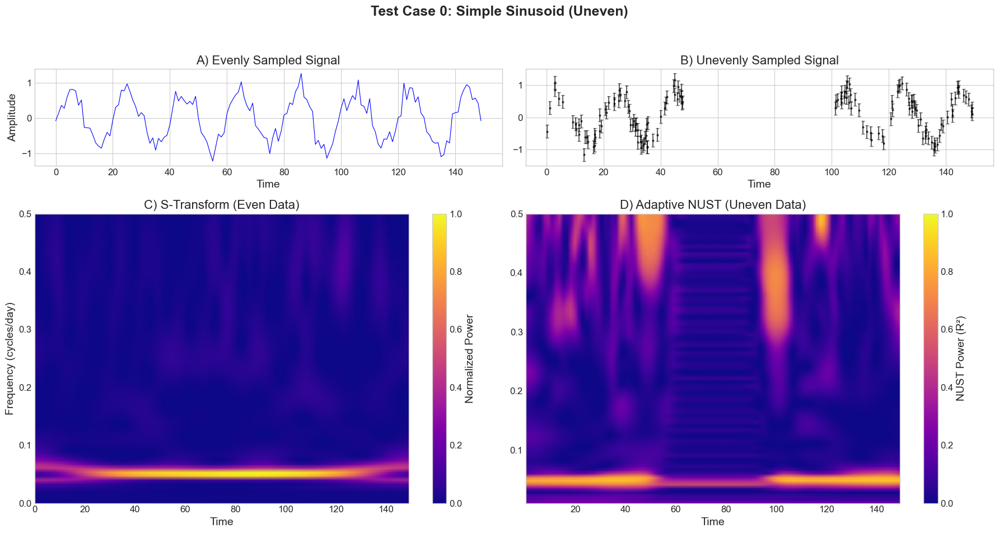

In [61]:
# Cell 17: Run Test Case 0
freq_grid_0 = np.linspace(0.01, 0.5, 80)
nust_params_0 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.09, 
    'gamma': 0.5, 
    'kde_bandwidth': 5.0
}

run_and_plot_comparison(0, generate_signal_0_even, generate_signal_0_uneven, freq_grid_0, nust_params_0)


Running Analysis for Test Case 1: Persistent + Transient (evenly sampled)
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


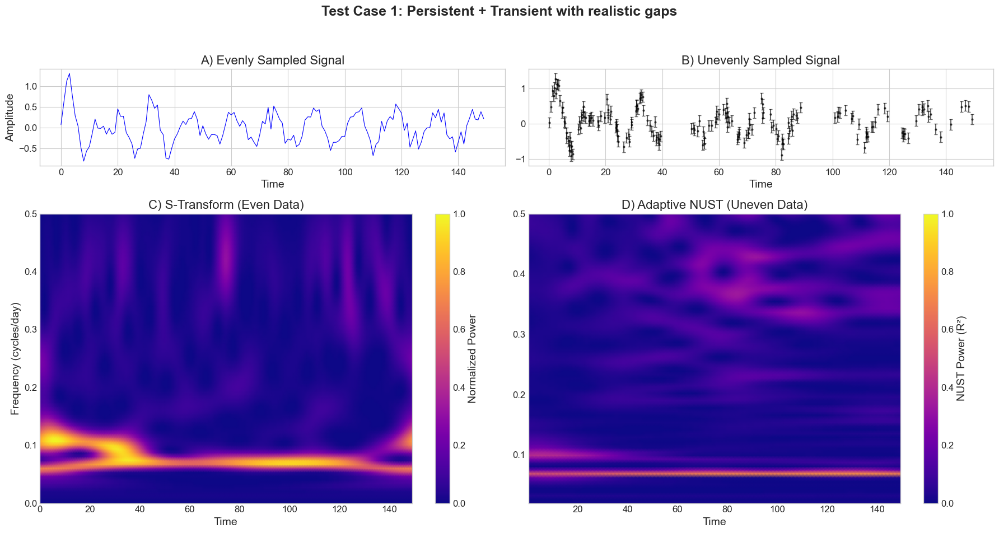

In [36]:
# Cell 19: Run Test Case 1
freq_grid_1 = np.linspace(0.02, 0.5, 80)
nust_params_1 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.25, 
    'gamma': 0.5, 
    'kde_bandwidth': 10.0
}

run_and_plot_comparison(1, generate_signal_1_even, generate_signal_1_uneven, freq_grid_1, nust_params_1)


Running Analysis for Test Case 2: HF Burst (Even)
Computing NUST (100τ x 80f = 8000 points)...


  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


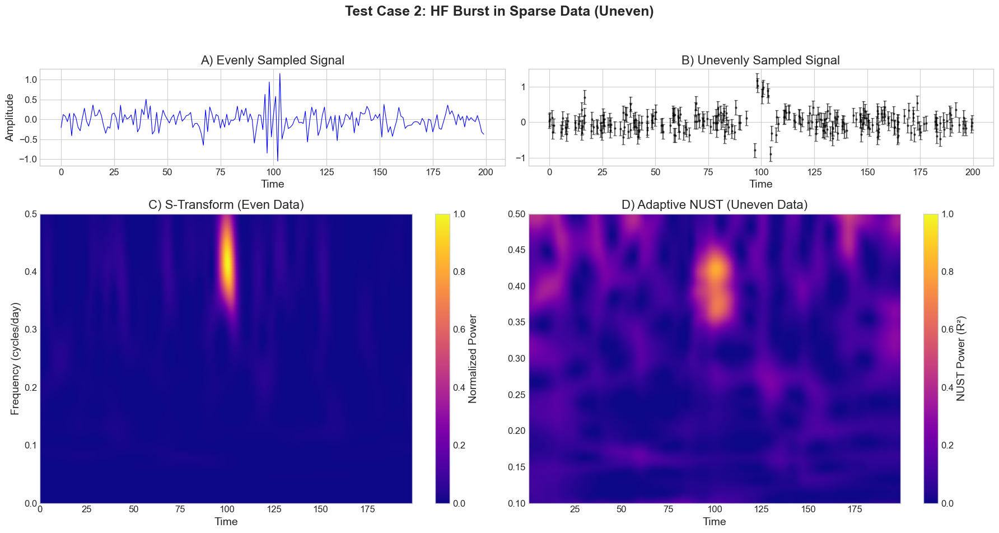

In [44]:
# Cell 21: Run Test Case 2
freq_grid_2 = np.linspace(0.1, 0.5, 80)
nust_params_2 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.15, 
    'gamma': 0.5, # Higher gamma for stronger adaptation
    'kde_bandwidth': 3.0
}

run_and_plot_comparison(2, generate_signal_2_even, generate_signal_2_uneven, freq_grid_2, nust_params_2)


Running Analysis for Test Case 3: Linear chirp (evenly sampled)
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


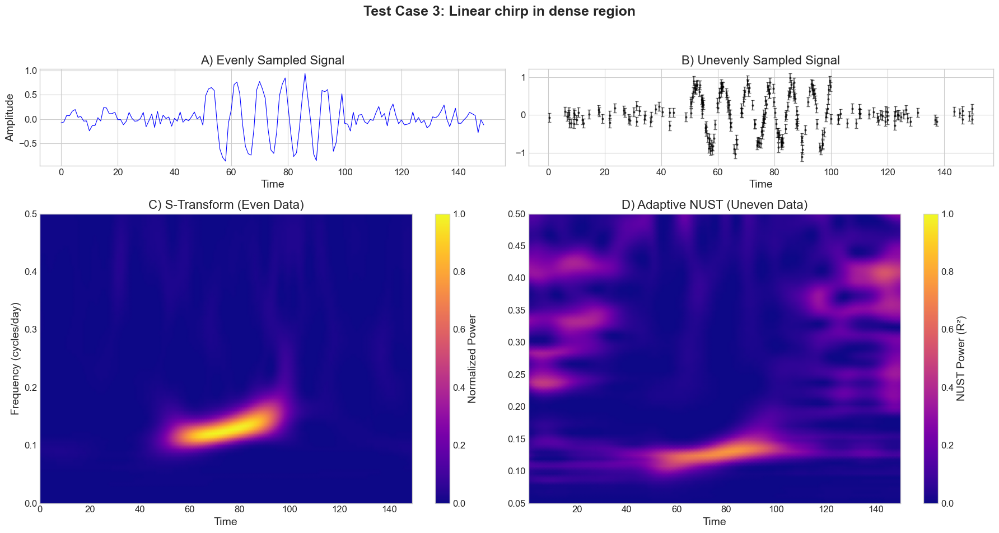

In [49]:
# Cell 23: Run Test Case 3
freq_grid_3 = np.linspace(0.05, 0.5, 80)
nust_params_3 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.18, # Smaller alpha for better time resolution
    'gamma': 0.5, 
    'kde_bandwidth': 5.0
}

run_and_plot_comparison(3, generate_signal_3_even, generate_signal_3_uneven, freq_grid_3, nust_params_3)

## more signals to test-1

In [12]:
# --- Test Case 4: Amplitude-Modulated Signal ---

def generate_signal_4_even():
    fs = 1.0
    times = np.arange(0, 250, 1/fs)
    N = len(times)
    
    carrier_freq = 0.1
    mod_freq = 0.02
    
    # Amplitude modulation envelope
    amplitude_envelope = 0.5 * (1 + np.sin(2 * np.pi * mod_freq * times))
    signal_clean = amplitude_envelope * np.sin(2 * np.pi * carrier_freq * times)
    
    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    return times, data, fs, {'carrier_freq': carrier_freq, 'mod_freq': mod_freq, 'description': 'Amplitude Modulation (Even)'}

def generate_signal_4_uneven():
    # Simulate observing runs with gaps in between
    np.random.seed(42)
    times = np.array([])
    for i in range(5):
        # 30-day observing run
        run_start = i * 50
        times = np.concatenate([times, np.sort(np.random.uniform(run_start, run_start + 30, 40))])
        
    N = len(times)
    carrier_freq = 0.1
    mod_freq = 0.02
    
    amplitude_envelope = 0.5 * (1 + np.sin(2 * np.pi * mod_freq * times))
    signal_clean = amplitude_envelope * np.sin(2 * np.pi * carrier_freq * times)
    
    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.2)
    return times, data, uncertainties, {'carrier_freq': carrier_freq, 'mod_freq': mod_freq, 'description': 'Amplitude Modulation (Uneven)'}


# --- Test Case 5: Two Closely Spaced Frequencies ---

def generate_signal_5_even():
    fs = 1.0
    times = np.arange(0, 300, 1/fs)
    N = len(times)
    
    freq1 = 0.1
    freq2 = 0.11 # Frequencies are close
    
    signal1 = 0.6 * np.sin(2 * np.pi * freq1 * times)
    signal2 = 0.6 * np.sin(2 * np.pi * freq2 * times)
    signal_clean = signal1 + signal2
    
    noise = np.random.normal(0, 0.3, N)
    data = signal_clean + noise
    return times, data, fs, {'freq1': freq1, 'freq2': freq2, 'description': 'Two Close Frequencies (Even)'}

def generate_signal_5_uneven():
    np.random.seed(42)
    times = np.concatenate([
        np.sort(np.random.uniform(0, 120, 100)),
        np.sort(np.random.uniform(180, 300, 100)),
    ])
    N = len(times)
    
    freq1 = 0.1
    freq2 = 0.11
    
    signal1 = 0.6 * np.sin(2 * np.pi * freq1 * times)
    signal2 = 0.6 * np.sin(2 * np.pi * freq2 * times)
    signal_clean = signal1 + signal2
    
    noise = np.random.normal(0, 0.3, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.3)
    return times, data, uncertainties, {'freq1': freq1, 'freq2': freq2, 'description': 'Two Close Frequencies (Uneven)'}


# --- Test Case 6: Signal with Abrupt Frequency Change (Frequency Hop) ---

def generate_signal_6_even():
    
    fs = 1.0
    times = np.arange(0, 200, 1/fs)
    N = len(times)
    
    freq_before = 0.08
    freq_after = 0.15
    hop_time = 100.0
    
    mask_before = times < hop_time
    mask_after = times >= hop_time
    
    signal_clean = np.zeros(N)
    signal_clean[mask_before] = 0.8 * np.sin(2 * np.pi * freq_before * times[mask_before])
    signal_clean[mask_after] = 0.8 * np.sin(2 * np.pi * freq_after * times[mask_after])

    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    return times, data, fs, {'freq_before': freq_before, 'freq_after': freq_after, 'hop_time': hop_time, 'description': 'Frequency Hop (Even)'}

def generate_signal_6_uneven():
    """Generates an unevenly sampled signal with a frequency hop in a sparse region."""
    np.random.seed(42)
    times = np.concatenate([
        np.sort(np.random.uniform(0, 95, 100)),      # Dense before hop
        np.sort(np.random.uniform(95, 105, 10)),     # Sparse around hop
        np.sort(np.random.uniform(105, 200, 100)),   # Dense after hop
    ])
    N = len(times)

    freq_before = 0.08
    freq_after = 0.15
    hop_time = 100.0
    
    mask_before = times < hop_time
    mask_after = times >= hop_time
    
    signal_clean = np.zeros(N)
    signal_clean[mask_before] = 0.8 * np.sin(2 * np.pi * freq_before * times[mask_before])
    signal_clean[mask_after] = 0.8 * np.sin(2 * np.pi * freq_after * times[mask_after])

    noise = np.random.normal(0, 0.2, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.2)
    return times, data, uncertainties, {'freq_before': freq_before, 'freq_after': freq_after, 'hop_time': hop_time, 'description': 'Frequency Hop (Uneven)'}

print("Advanced signal generation functions (Cases 4, 5, 6) defined.")

Advanced signal generation functions (Cases 4, 5, 6) defined.


## more signals test reults-1


Running Analysis for Test Case 4: Amplitude Modulation (Even)
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


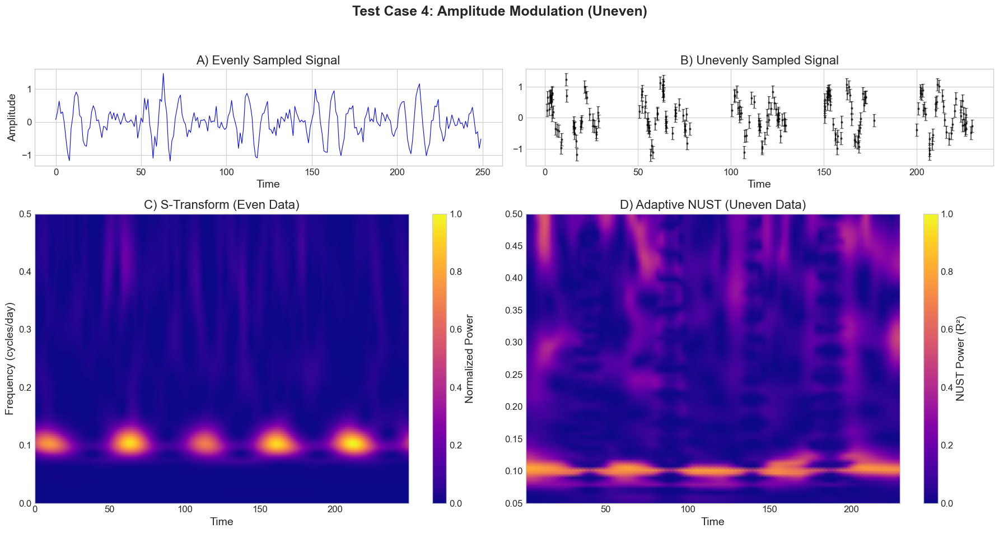

In [58]:
# --- Run Test Case 4 ---
freq_grid_4 = np.linspace(0.05, 0.5, 80)
nust_params_4 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.13, 
    'gamma': 0.5, 
    'kde_bandwidth': 5.0 # Gappy data might need a smaller bandwidth
}

run_and_plot_comparison(4, generate_signal_4_even, generate_signal_4_uneven, freq_grid_4, nust_params_4)


Running Analysis for Test Case 5: Two Close Frequencies (Even)
Computing NUST (100τ x 150f = 15000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


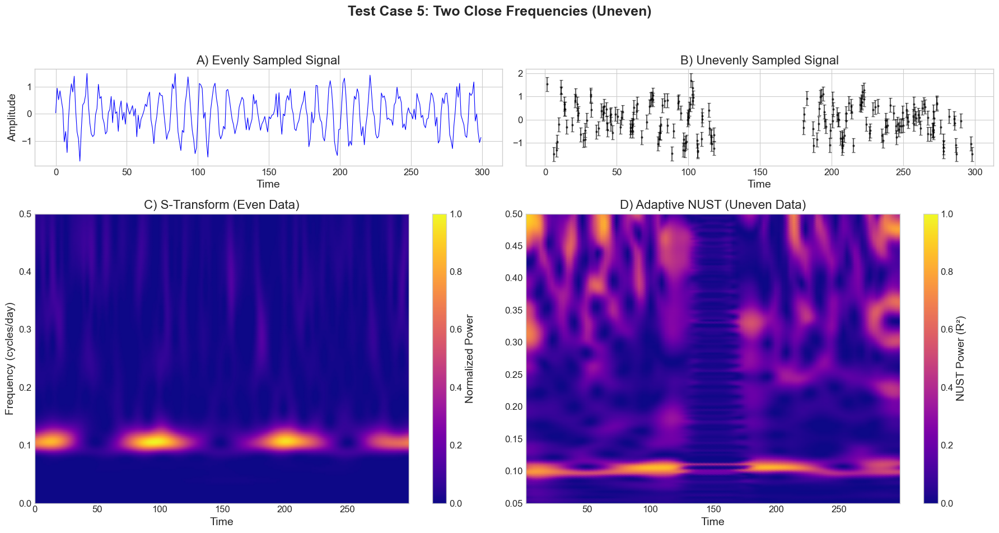

In [75]:
# --- Run Test Case 5 ---
freq_grid_5 = np.linspace(0.05, 0.5, 150)
nust_params_5 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.13, 
    'gamma': 0.5, 
    'kde_bandwidth': 8.0 
}

run_and_plot_comparison(5, generate_signal_5_even, generate_signal_5_uneven, freq_grid_5, nust_params_5)


Running Analysis for Test Case 6: Frequency Hop (Even)
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


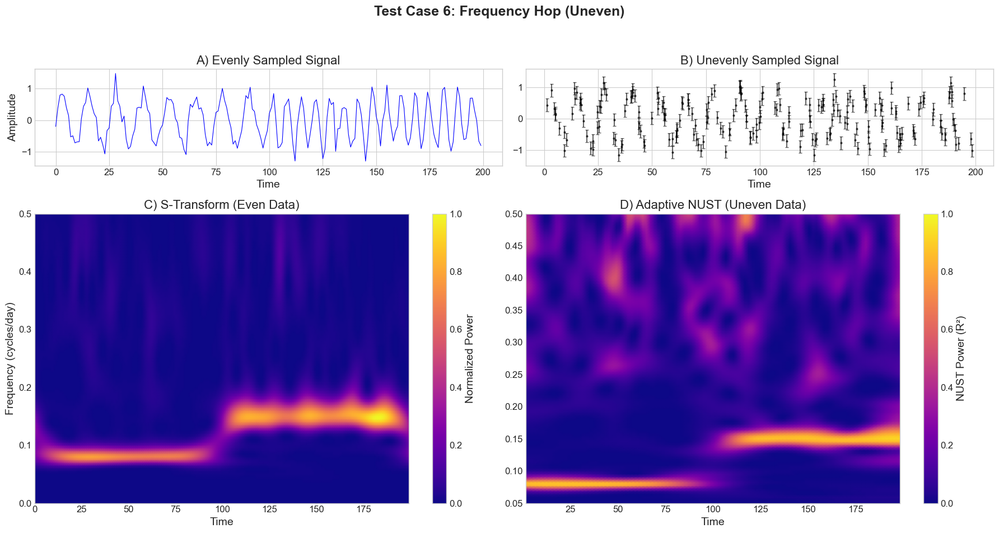

In [76]:
# --- Run Test Case 6 ---
freq_grid_6 = np.linspace(0.05, 0.5, 100)
nust_params_6 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.13, 
    'gamma': 0.5, 
    'kde_bandwidth': 15.0 # Gappy data might need a smaller bandwidth
}

run_and_plot_comparison(6, generate_signal_6_even, generate_signal_6_uneven, freq_grid_6, nust_params_6)

## hyperparameter visualisation with constant time


Generating Hyperparameter Impact on Frequency Slices


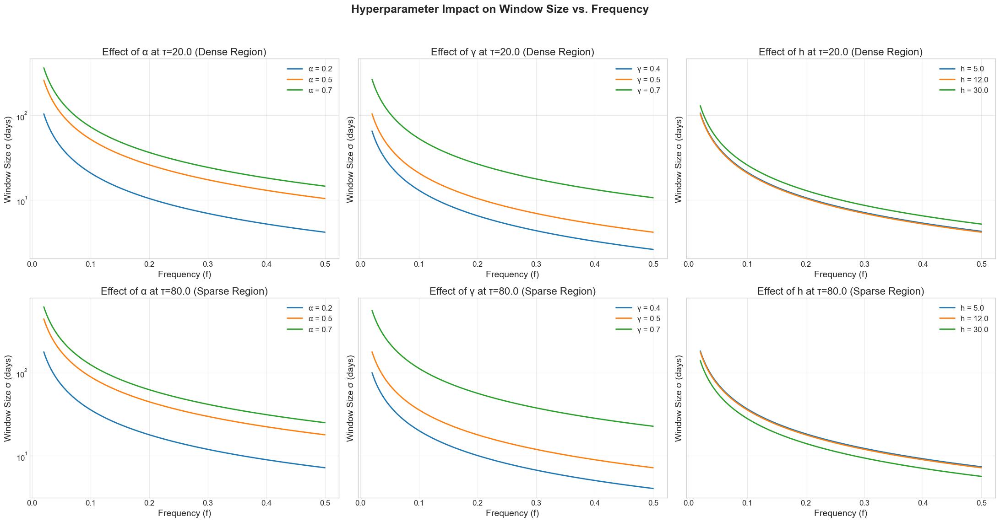

In [13]:
def visualize_hyperparameter_frequency_slices(times):
    
    print(f"\n{'='*60}\nGenerating Hyperparameter Impact on Frequency Slices\n{'='*60}")

    # --- 1. Define Grids, Fixed Points, and Parameters ---
    freq_grid = np.linspace(0.02, 0.5, 200)
    
    time_dense = 20.0  # A point in a dense region
    time_sparse = 80.0 # A point in a sparse region
    
    baseline_params = {'alpha': 0.2, 'gamma': 0.5, 'h': 12.0}

    # --- 2. Create the Figure ---
    fig, axes = plt.subplots(2, 3, figsize=(22, 12), sharey='row')
    fig.suptitle('Hyperparameter Impact on Window Size vs. Frequency', fontsize=18, fontweight='bold')
    for row, (fixed_time, time_label) in enumerate([(time_dense, "Dense Region"), (time_sparse, "Sparse Region")]):
        
        # --- Pre-compute KDEs for different h values ---
        kde_h_base, _ = estimate_sampling_density_kde(times, bandwidth=baseline_params['h'])
        kde_h_var1, _ = estimate_sampling_density_kde(times, bandwidth=5.0) # Spiky
        kde_h_var2, _ = estimate_sampling_density_kde(times, bandwidth=30.0) # Smooth
        
        # == PANEL 1: Effect of Alpha (α) ==
        ax1 = axes[row, 0]
        ax1.set_title(f'Effect of α at τ={fixed_time} ({time_label})')
        alphas_to_test = [0.2, 0.5, 0.7]
        for alpha in alphas_to_test:
            sigmas = [adaptive_window_std(fixed_time, f, kde_h_base, alpha, baseline_params['gamma']) for f in freq_grid]
            ax1.plot(freq_grid, sigmas, lw=2, label=f'α = {alpha}')

        # == PANEL 2: Effect of Gamma (γ) ==
        ax2 = axes[row, 1]
        ax2.set_title(f'Effect of γ at τ={fixed_time} ({time_label})')
        gammas_to_test = [0.4, 0.5, 0.7]
        for gamma in gammas_to_test:
            sigmas = [adaptive_window_std(fixed_time, f, kde_h_base, baseline_params['alpha'], gamma) for f in freq_grid]
            ax2.plot(freq_grid, sigmas, lw=2, label=f'γ = {gamma}')

        # == PANEL 3: Effect of KDE Bandwidth (h) ==
        ax3 = axes[row, 2]
        ax3.set_title(f'Effect of h at τ={fixed_time} ({time_label})')
        h_to_test = [(5.0, kde_h_var1), (12.0, kde_h_base), (30.0, kde_h_var2)]
        for h, kde in h_to_test:
            sigmas = [adaptive_window_std(fixed_time, f, kde, baseline_params['alpha'], baseline_params['gamma']) for f in freq_grid]
            ax3.plot(freq_grid, sigmas, lw=2, label=f'h = {h}')

    # --- Formatting ---
    for ax in axes.flat:
        ax.set_xlabel("Frequency (f)")
        ax.set_ylabel("Window Size σ (days)")
        ax.set_yscale('log')
        ax.legend()
        ax.grid(True, alpha=0.4)
        
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

visualization_times = generate_varied_density_times()
visualize_hyperparameter_frequency_slices(visualization_times)

## plotting function 2

In [14]:
def create_ls_nust_even_uneven_comparison(case_number, even_gen_func, uneven_gen_func, freq_grid, nust_params):
    print(f"\n{'='*60}\nGenerating LS vs NUST-Even vs NUST-Uneven Comparison for Case {case_number}\n{'='*60}")
    
    # --- 1. Generate Signals ---
    times_even, data_even, _, info_even = even_gen_func()
    uncertainties_even = np.ones_like(data_even) * np.std(data_even - np.mean(data_even)) # Estimate uncertainties
    times_uneven, data_uneven, uncertainties_uneven, info_uneven = uneven_gen_func()

    # --- 2. Run Analyses ---
    # Lomb-Scargle on uneven data
    ls_power = compute_lomb_scargle(times_uneven, data_uneven, uncertainties_uneven, freq_grid)
    
    # NUST on EVEN data
    print("Running NUST on EVENLY sampled data...")
    tau_grid_even = np.linspace(times_even.min(), times_even.max(), 100)
    nust_even_power = nust(times_even, data_even, uncertainties_even, 
                           tau_grid_even, freq_grid, **nust_params)
    
    # NUST on UNEVEN data
    print("\nRunning NUST on UNEVENLY sampled data...")
    tau_grid_uneven = np.linspace(times_uneven.min(), times_uneven.max(), 100)
    nust_uneven_power = nust(times_uneven, data_uneven, uncertainties_uneven, 
                             tau_grid_uneven, freq_grid, **nust_params)

    # --- 3. Create the Plot ---
    fig, axes = plt.subplots(1, 3, figsize=(22, 7), sharey=True)
    fig.suptitle(f'Test Case {case_number}: LS vs. NUST on Even and Uneven Data', fontsize=18, fontweight='bold')

    cmap = 'plasma'
    vmin, vmax = 0, 1

    # Panel A: Lomb-Scargle Periodogram (Uneven Data)
    axes[0].set_title('A) Lomb-Scargle (Uneven Data)', fontsize=14)
    axes[0].plot(ls_power, freq_grid, 'b-', lw=2)
    axes[0].set_xlabel('LS Power')
    axes[0].set_ylabel('Frequency (cycles/day)')
    axes[0].set_xlim(0, 1)
    
    # Panel B: NUST (Even Data)
    axes[1].set_title('B) NUST on Evenly Sampled Data', fontsize=14)
    axes[1].pcolormesh(tau_grid_even, freq_grid, nust_even_power.T, 
                       shading='gouraud', cmap=cmap, vmin=vmin, vmax=vmax)
    axes[1].set_xlabel('Time (days)')
    
    # Panel C: NUST (Uneven Data)
    im = axes[2].pcolormesh(tau_grid_uneven, freq_grid, nust_uneven_power.T, 
                           shading='gouraud', cmap=cmap, vmin=vmin, vmax=vmax)
    axes[2].set_title('C) NUST on Unevenly Sampled Data', fontsize=14)
    axes[2].set_xlabel('Time (days)')

    fig.subplots_adjust(right=0.9, wspace=0.15)
    cbar_ax = fig.add_axes([0.91, 0.15, 0.015, 0.7])
    fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()

# # --- Execute for Test Case 1 (Persistent + Transient) ---
# freq_grid_1 = np.linspace(0.02, 0.5, 80)
# nust_params_1 = {
#     'use_voronoi_weights': True, 
#     'use_adaptive_window': True,
#     'alpha': 0.25, 
#     'gamma': 0.5, 
#     'kde_bandwidth': 10.0
# }
# create_ls_nust_even_uneven_comparison(1, generate_signal_1_even, generate_signal_1_uneven, freq_grid_1, nust_params_1)

## results with plotting function 2


Generating LS vs NUST-Even vs NUST-Uneven Comparison for Case 2
Running NUST on EVENLY sampled data...
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running NUST on UNEVENLY sampled data...
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


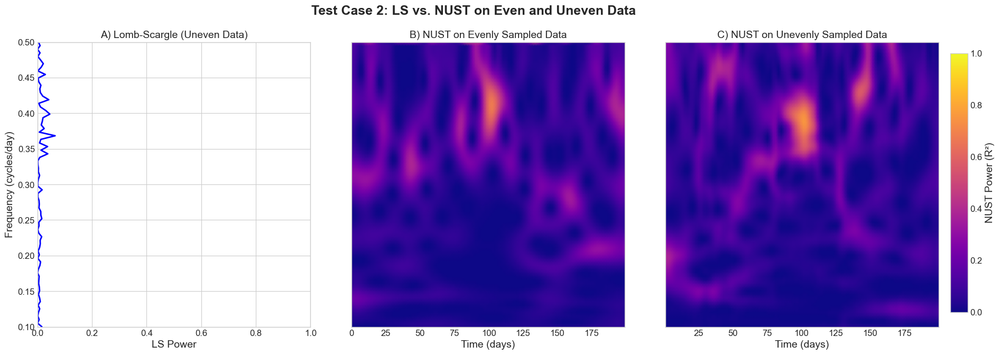

In [53]:
freq_grid_2 = np.linspace(0.1, 0.5, 80)
nust_params_2 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.15, 
    'gamma': 0.5, 
    'kde_bandwidth': 3.0
}
create_ls_nust_even_uneven_comparison(2, generate_signal_2_even, generate_signal_2_uneven, freq_grid_2, nust_params_2)


Generating LS vs NUST-Even vs NUST-Uneven Comparison for Case 3
Running NUST on EVENLY sampled data...
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running NUST on UNEVENLY sampled data...
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


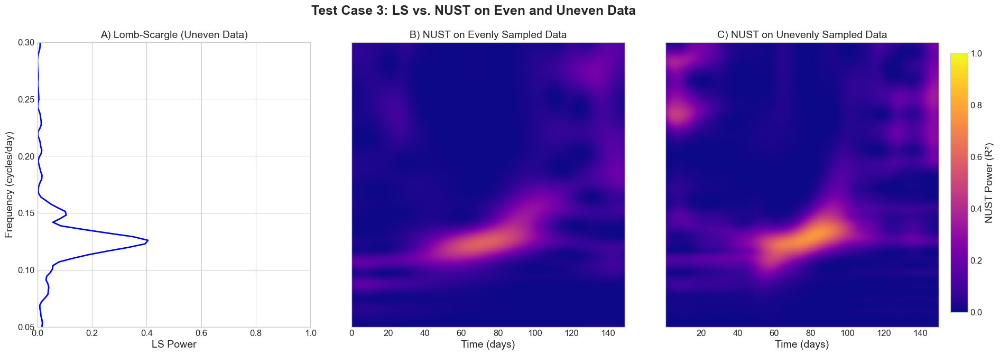

In [86]:
freq_grid_3 = np.linspace(0.05, 0.3, 80)
nust_params_3 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.18, 
    'gamma': 0.5, 
    'kde_bandwidth': 5.0
}
create_ls_nust_even_uneven_comparison(3, generate_signal_3_even, generate_signal_3_uneven, freq_grid_3, nust_params_3)


Generating LS vs NUST-Even vs NUST-Uneven Comparison for Case 4
Running NUST on EVENLY sampled data...
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running NUST on UNEVENLY sampled data...
Computing NUST (100τ x 80f = 8000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


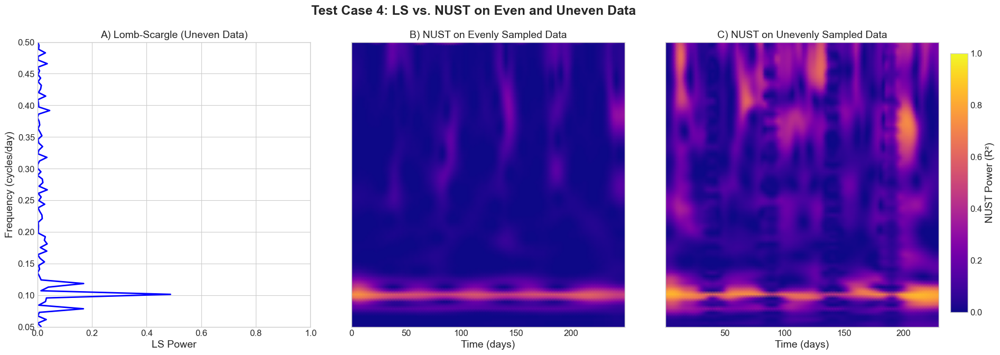

In [87]:
freq_grid_4 = np.linspace(0.05, 0.5, 80)
nust_params_4 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.13, 
    'gamma': 0.5, 
    'kde_bandwidth': 5.0
}
create_ls_nust_even_uneven_comparison(4, generate_signal_4_even, generate_signal_4_uneven, freq_grid_4, nust_params_4)


Generating LS vs NUST-Even vs NUST-Uneven Comparison for Case 5
Running NUST on EVENLY sampled data...
Computing NUST (100τ x 130f = 13000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running NUST on UNEVENLY sampled data...
Computing NUST (100τ x 130f = 13000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


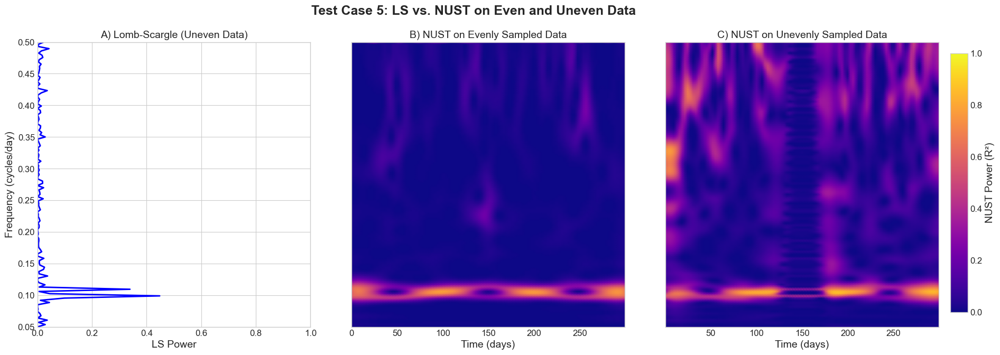

In [88]:
freq_grid_5 = np.linspace(0.05, 0.5, 130)
nust_params_5 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.13, 
    'gamma': 0.5, 
    'kde_bandwidth': 8.0
}
create_ls_nust_even_uneven_comparison(5, generate_signal_5_even, generate_signal_5_uneven, freq_grid_5, nust_params_5)


Generating LS vs NUST-Even vs NUST-Uneven Comparison for Case 6
Running NUST on EVENLY sampled data...
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running NUST on UNEVENLY sampled data...
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


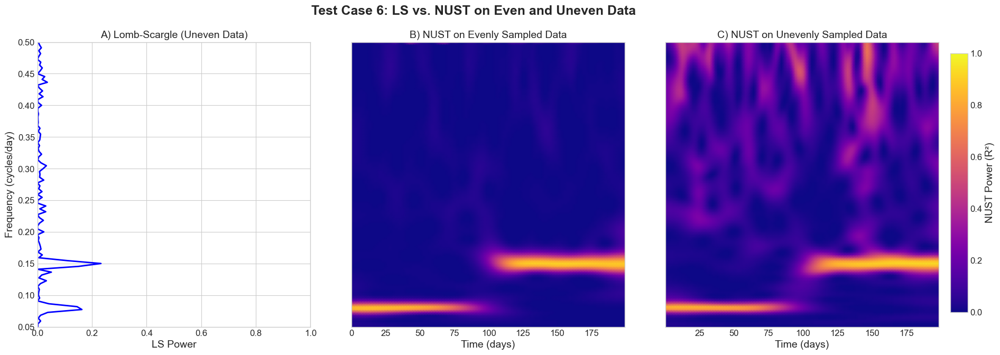

In [89]:
freq_grid_6 = np.linspace(0.05, 0.5, 100)
nust_params_6 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.13, 
    'gamma': 0.5, 
    'kde_bandwidth': 15.0
}
create_ls_nust_even_uneven_comparison(6, generate_signal_6_even, generate_signal_6_uneven, freq_grid_6, nust_params_6)

## controlled , random sampling & SNR test for 3-component sum signal

In [15]:
def generate_signal_7_even():
    fs = 1.0
    times = np.arange(0, 300, 1/fs)
    N = len(times)
    
    freq1, freq2, freq3 = 0.05, 0.12, 0.2
    signal_clean = (0.6 * np.sin(2 * np.pi * freq1 * times) +
                    0.8 * np.sin(2 * np.pi * freq2 * times) +
                    0.7 * np.sin(2 * np.pi * freq3 * times))
    
    noise = np.random.normal(0, 0.3, N)
    data = signal_clean + noise
    return times, data, fs, {'freqs': [freq1, freq2, freq3], 'description': 'Simple 3-Component Sum (Even)'}

def generate_signal_7_uneven():
    times = np.array([])
    # 50-day observing runs with 20-day gaps
    for i in range(5):
        run_start = i * 70
        times = np.concatenate([times, np.sort(np.random.uniform(run_start, run_start + 50, 60))])
        
    N = len(times)
    freq1, freq2, freq3 = 0.05, 0.12, 0.2
    signal_clean = (0.6 * np.sin(2 * np.pi * freq1 * times) +
                    0.8 * np.sin(2 * np.pi * freq2 * times) +
                    0.7 * np.sin(2 * np.pi * freq3 * times))

    noise = np.random.normal(0, 0.3, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.3)
    return times, data, uncertainties, {'freqs': [freq1, freq2, freq3], 'description': 'Simple 3-Component Sum (Uneven Gaps)'}


# --- Test Case 8: Additive Signal with Purely Random Sampling ---

def generate_signal_8_even(): # Same as Case 7 even
    return generate_signal_7_even()

def generate_signal_8_uneven():
    """The 3-component signal with purely random sampling times."""
    # 300 total points, completely randomly distributed
    num_points = 300
    times = np.sort(np.random.uniform(0, 300, num_points))
        
    N = len(times)
    freq1, freq2, freq3 = 0.05, 0.12, 0.2
    signal_clean = (0.6 * np.sin(2 * np.pi * freq1 * times) +
                    0.8 * np.sin(2 * np.pi * freq2 * times) +
                    0.7 * np.sin(2 * np.pi * freq3 * times))

    noise = np.random.normal(0, 0.3, N)
    data = signal_clean + noise
    uncertainties = np.full(N, 0.3)
    return times, data, uncertainties, {'freqs': [freq1, freq2, freq3], 'description': '3-Component Sum (Purely Random Sampling)'}



Running Analysis for Test Case 7: Simple 3-Component Sum (Even)
Computing NUST (100τ x 150f = 15000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


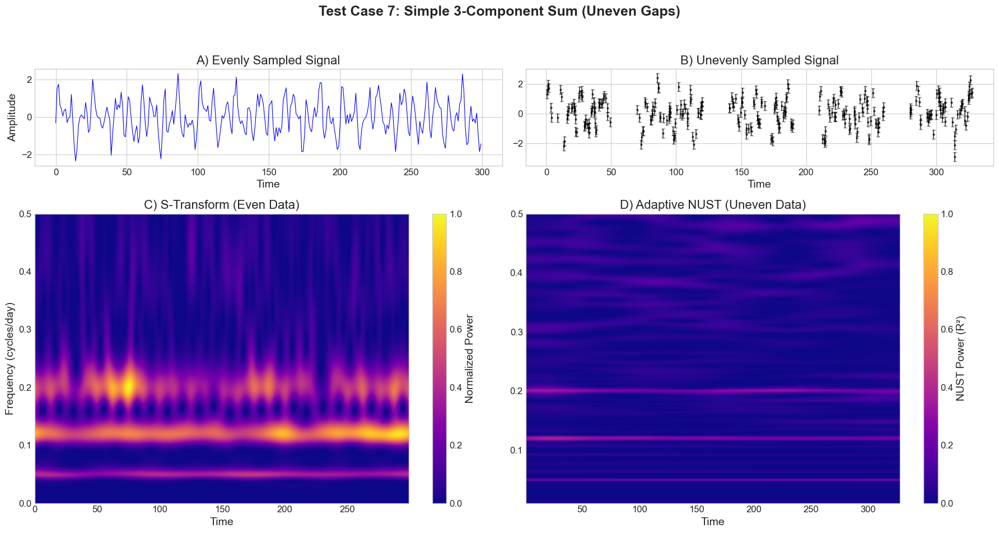

In [32]:
# --- Run Test Case 7 ---
freq_grid_7 = np.linspace(0.01, 0.5, 150)
nust_params_7 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.28, 
    'gamma': 0.6, 
    'kde_bandwidth': 20.0 
}

run_and_plot_comparison(7, generate_signal_7_even, generate_signal_7_uneven, freq_grid_7, nust_params_7)
#create_ls_nust_even_uneven_comparison(7, generate_signal_7_even, generate_signal_7_uneven, freq_grid_7, nust_params_7)



Running Analysis for Test Case 8: Simple 3-Component Sum (Even)
Computing NUST (100τ x 150f = 15000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


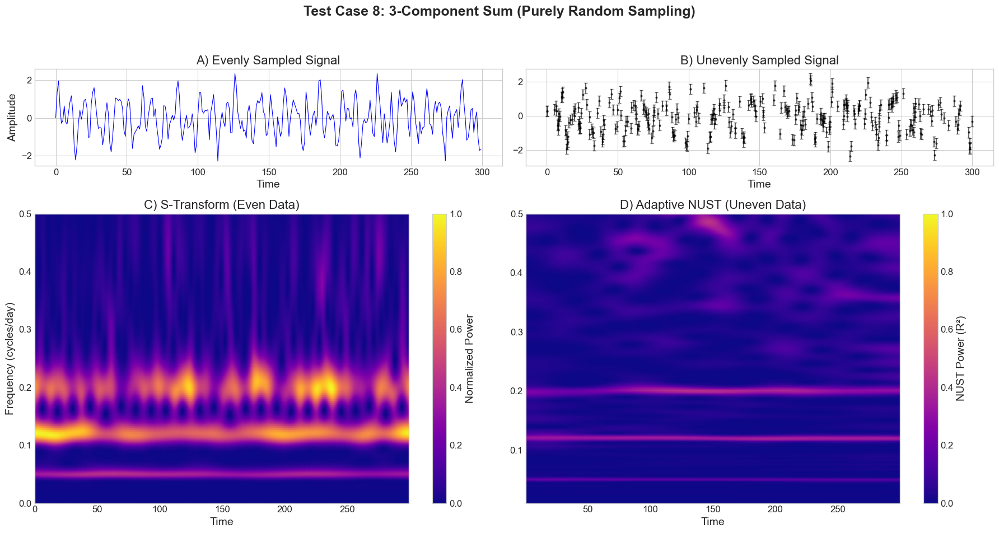

In [35]:
# --- Run Test Case 8 ---
freq_grid_8 = np.linspace(0.01, 0.5, 150)
nust_params_8 = {
    'use_voronoi_weights': True, 
    'use_adaptive_window': True,
    'alpha': 0.28, 
    'gamma': 0.5, 
    'kde_bandwidth': 18.0 
}

run_and_plot_comparison(8, generate_signal_8_even, generate_signal_8_uneven, freq_grid_8, nust_params_8)
#create_ls_nust_even_uneven_comparison(8, generate_signal_8_even, generate_signal_8_uneven, freq_grid_8, nust_params_8)

In [48]:
def generate_signal_with_snr(times, clean_signal_func, snr):
    signal_clean = clean_signal_func(times)
    
    signal_variance = np.var(signal_clean)
    print(f"Signal Variance: {signal_variance:.4f}")
    noise_variance = signal_variance / snr

    noise_std = np.sqrt(noise_variance)

    noise = np.random.normal(0, noise_std, len(times))
 
    data = signal_clean + noise
    uncertainties = np.full_like(data, noise_std)
    
    return data, uncertainties, signal_clean

print("SNR-based signal generation helper is ready.")

SNR-based signal generation helper is ready.


In [17]:
def clean_signal_func_7(times):
    freq1, freq2, freq3 = 0.05, 0.12, 0.2
    signal = (0.6 * np.sin(2 * np.pi * freq1 * times) +
              0.8 * np.sin(2 * np.pi * freq2 * times) +
              0.7 * np.sin(2 * np.pi * freq3 * times))
    return signal

def generate_signal_7_snr(snr=5.0):
    # We'll use the standard gappy time sampling for this test
    times = np.array([])
    for i in range(5):
        run_start = i * 70
        times = np.concatenate([times, np.sort(np.random.uniform(run_start, run_start + 50, 60))])
        
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_7, snr)
    
    info = {
        'freqs': [0.05, 0.12, 0.2],
        'snr': snr,
        'description': f'3-Component Sum (Uneven Gaps, SNR={snr})'
    }
    
    # For the 'even' generator slot, we need to return fs as well. We can estimate it.
    fs_est = len(times) / (times.max() - times.min())
    
    return times, data, uncertainties, info, fs_est

print("SNR-controlled generator for Test Case 7 is ready.")

SNR-controlled generator for Test Case 7 is ready.



Running analysis for SNR = 10...
Signal Variance: 0.7452
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running analysis for SNR = 5...
Signal Variance: 0.7659
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running analysis for SNR = 0.5...
Signal Variance: 0.6426
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


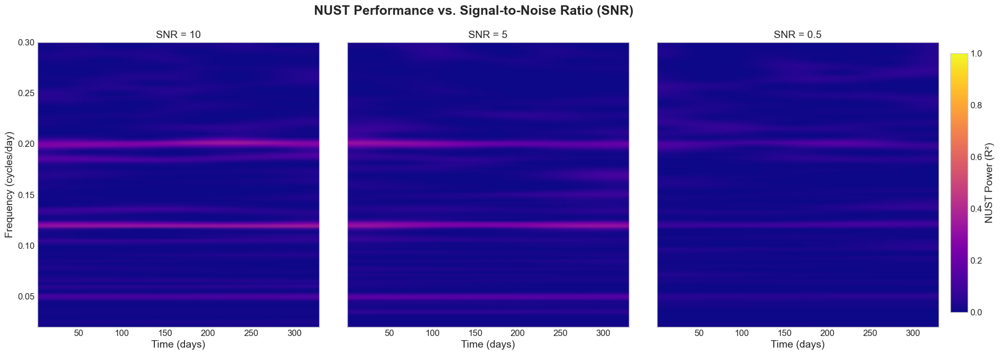

In [47]:
def run_snr_comparison():
    snr_levels = [10, 5, 0.5] # High, Medium, Low SNR
    
    fig, axes = plt.subplots(1, 3, figsize=(22, 7), sharey=True)
    fig.suptitle('NUST Performance vs. Signal-to-Noise Ratio (SNR)', fontsize=18, fontweight='bold')

    freq_grid = np.linspace(0.02, 0.3, 100)
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 1, 'gamma': 0.4, 'kde_bandwidth': 30.0
    }

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning analysis for SNR = {snr}...")
        
        # --- Generate Data ---
        times, data, uncertainties, info, _ = generate_signal_7_snr(snr=snr)
        
        # --- Run NUST ---
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        # --- Plot ---
        ax = axes[i]
        im = ax.pcolormesh(tau_grid, freq_grid, nust_power.T, shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        ax.set_title(f"SNR = {snr}", fontsize=14)
        ax.set_xlabel("Time (days)")
        
            
    axes[0].set_ylabel("Frequency (cycles/day)")
    
    fig.subplots_adjust(right=0.9, wspace=0.1)
    cbar_ax = fig.add_axes([0.91, 0.15, 0.015, 0.7])
    fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()

# --- Execute the SNR comparison ---
run_snr_comparison()

## SNR test for multi-tansient signal

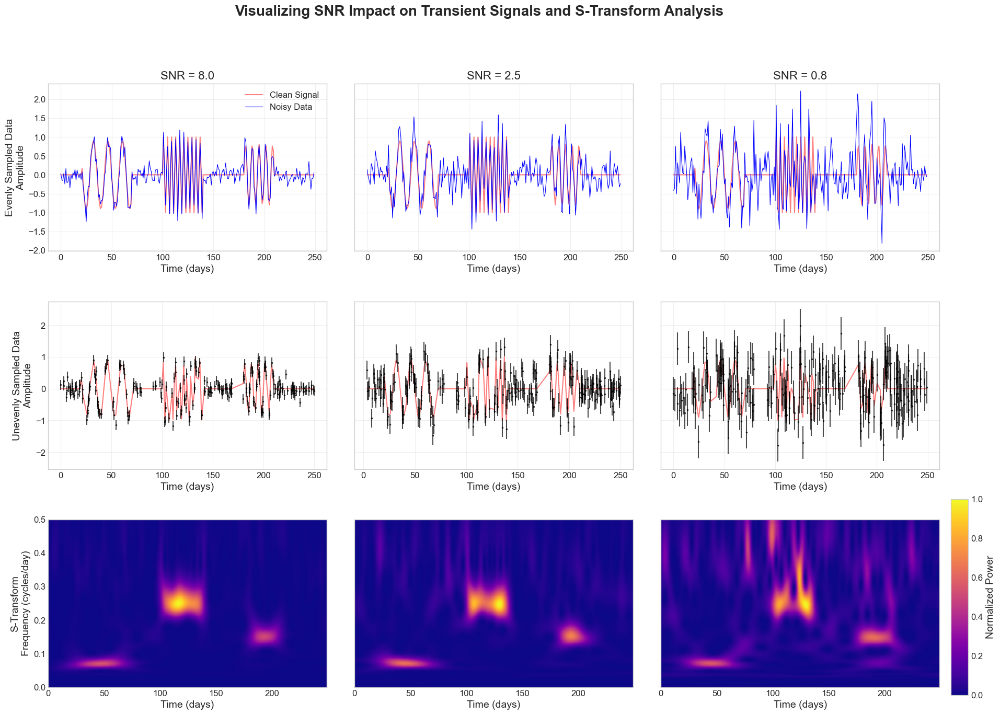

In [ ]:
def clean_signal_func_transient(times):
    signal_clean = np.zeros_like(times)
    
    # Signal 1: Low frequency, early in time
    freq1 = 0.07
    mask1 = (times > 20) & (times < 70)
    if np.any(mask1):
        signal_clean[mask1] = 0.9 * np.sin(2 * np.pi * freq1 * times[mask1])

    # Signal 2: High frequency, in the middle
    freq2 = 0.25
    mask2 = (times > 100) & (times < 140)
    if np.any(mask2):
        signal_clean[mask2] = 1.0 * np.sin(2 * np.pi * freq2 * times[mask2])

    # Signal 3: Medium frequency, late in time
    freq3 = 0.15
    mask3 = (times > 180) & (times < 210)
    if np.any(mask3):
        signal_clean[mask3] = 0.8 * np.sin(2 * np.pi * freq3 * times[mask3])
        
    return signal_clean

def generate_transient_signal_snr(snr, sampling_type='even'):
    # 1. Create the time array based on requested sampling type
    if sampling_type == 'even':
        fs = 1.0
        times = np.arange(0, 250, 1 / fs)
    elif sampling_type == 'uneven':
        fs = None # No fixed sampling rate for uneven data
        times = np.array([])
        # Create structured gaps
        times = np.concatenate([times, np.sort(np.random.uniform(0, 80, 80))])
        times = np.concatenate([times, np.sort(np.random.uniform(90, 170, 80))])
        times = np.concatenate([times, np.sort(np.random.uniform(180, 250, 90))])
        
    # 2. Use the helper to generate the noisy signal
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_transient, snr)
    
    # 3. Package information
    info = {
        'freqs': [0.07, 0.15, 0.25], # Sorted for plotting
        'snr': snr,
        'description': f'3-Transient Signal (SNR={snr}, {sampling_type})'
    }
    
    return times, data, uncertainties, signal_clean, info, fs


def run_transient_snr_visualization():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(3, len(snr_levels), figsize=(22, 15), sharey='row')
    fig.suptitle('Visualizing SNR Impact on Transient Signals and S-Transform Analysis', fontsize=20, fontweight='bold')

    for i, snr in enumerate(snr_levels):
        # --- Generate Data ---
        times_even, data_even, _, clean_even, info_even, fs = generate_transient_signal_snr(snr, 'even')
        times_uneven, data_uneven, uncertainties_uneven, clean_uneven, _, _ = generate_transient_signal_snr(snr, 'uneven')
        
        # --- Row 1: Plot Evenly Sampled Data ---
        ax_even = axes[0, i]
        ax_even.set_title(f"SNR = {snr}", fontsize=16)
        ax_even.plot(times_even, clean_even, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_even.plot(times_even, data_even, 'b-', lw=0.8, label='Noisy Data')
        if i == 0: ax_even.set_ylabel("Evenly Sampled Data\nAmplitude")
        
        # --- Row 2: Plot Unevenly Sampled Data ---
        ax_uneven = axes[1, i]
        ax_uneven.plot(times_uneven, clean_uneven, 'r-', alpha=0.5, lw=1.5)
        ax_uneven.errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_uneven.set_ylabel("Unevenly Sampled Data\nAmplitude")
        
        # --- Row 3: S-Transform of Even Data ---
        ax_st = axes[2, i]
        st_result = st.st(data_even)
        st_power = np.abs(st_result)**2
        st_power_normalized = st_power / np.max(st_power)
        
        st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
        im = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                                shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_st.set_ylabel("S-Transform\nFrequency (cycles/day)")
        
            
    for ax in axes.flat:
        ax.grid(True, alpha=0.3)
        ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.3, wspace=0.1)
    cbar_ax = fig.add_axes([0.91, 0.1, 0.015, 0.25])
    fig.colorbar(im, cax=cbar_ax, label='Normalized Power')
    
    plt.show()

run_transient_snr_visualization()


Running full analysis for SNR = 8.0...
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 2.5...
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 0.8...
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


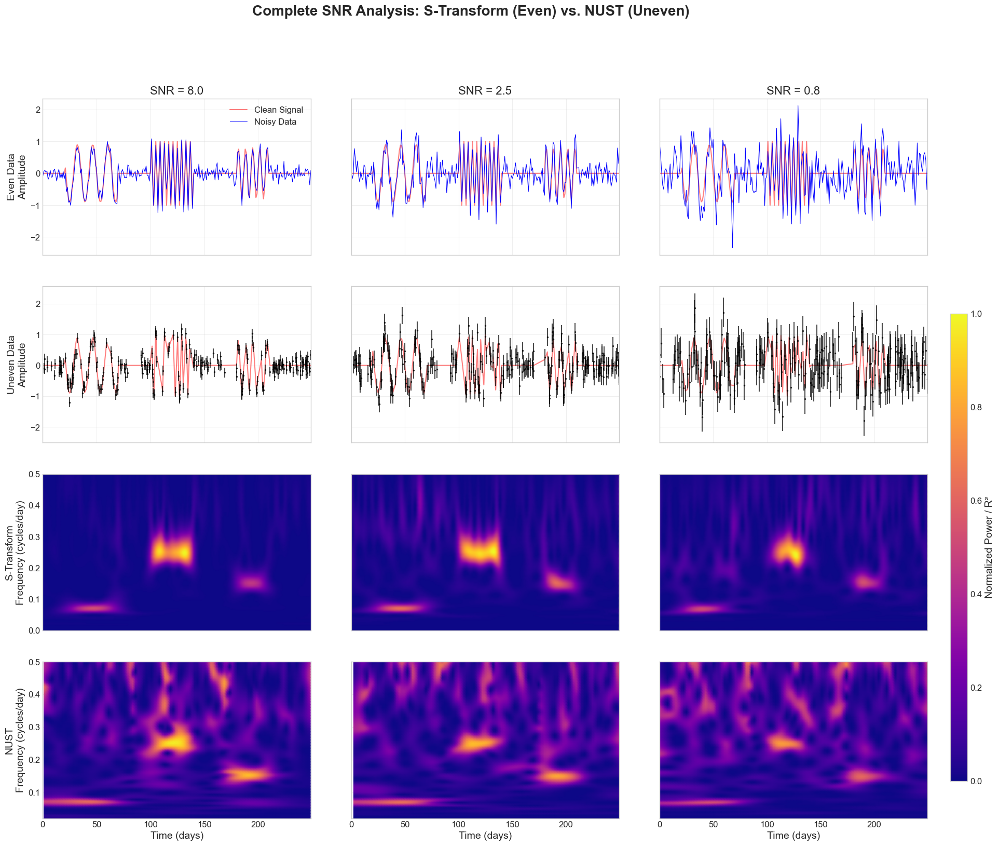

In [ ]:
def run_full_transient_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(4, len(snr_levels), figsize=(22, 18), sharex='col', sharey='row')
    fig.suptitle('Complete SNR Analysis: S-Transform (Even) vs. NUST (Uneven)', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.1, 'gamma': 0.5, 'kde_bandwidth': 20.0
    }

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning full analysis for SNR = {snr}...")
        
        # --- Generate Data ---
        times_even, data_even, _, clean_even, info, fs = generate_transient_signal_snr(snr, 'even')
        times_uneven, data_uneven, uncertainties_uneven, clean_uneven, _, _ = generate_transient_signal_snr(snr, 'uneven')
        
        # --- Row 1: Plot Evenly Sampled Data ---
        ax_even_data = axes[0, i]
        ax_even_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_even_data.plot(times_even, clean_even, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_even_data.plot(times_even, data_even, 'b-', lw=0.8, label='Noisy Data')
        if i == 0: ax_even_data.set_ylabel("Even Data\nAmplitude")
        
        # --- Row 2: Plot Unevenly Sampled Data ---
        ax_uneven_data = axes[1, i]
        ax_uneven_data.plot(times_uneven, clean_uneven, 'r-', alpha=0.5, lw=1.5)
        ax_uneven_data.errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_uneven_data.set_ylabel("Uneven Data\nAmplitude")
        
        # --- Row 3: S-Transform of Even Data ---
        ax_st = axes[2, i]
        st_result = st.st(data_even)
        st_power = np.abs(st_result)**2
        st_power_normalized = st_power / np.max(st_power)
        
        st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
        im_st = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                                 shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_st.set_ylabel("S-Transform\nFrequency (cycles/day)")
        
        # --- Row 4: NUST of Uneven Data ---
        ax_nust = axes[3, i]
        freq_grid = np.linspace(0.02, 0.5, 100) # Define freq grid for NUST
        tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100)
        
        nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, tau_grid, freq_grid, **nust_params)
        
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                     shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST\nFrequency (cycles/day)")
    
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[3,:]: 
        ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.15)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.5])
    fig.colorbar(im_nust, cax=cbar_ax, label='Normalized Power / R²')
    
    plt.show()

run_full_transient_snr_comparison()


Running GLS vs. NUST analysis for SNR = 8.0...
Signal Variance: 0.1880
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running GLS vs. NUST analysis for SNR = 2.5...
Signal Variance: 0.2164
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running GLS vs. NUST analysis for SNR = 0.8...
Signal Variance: 0.1865
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


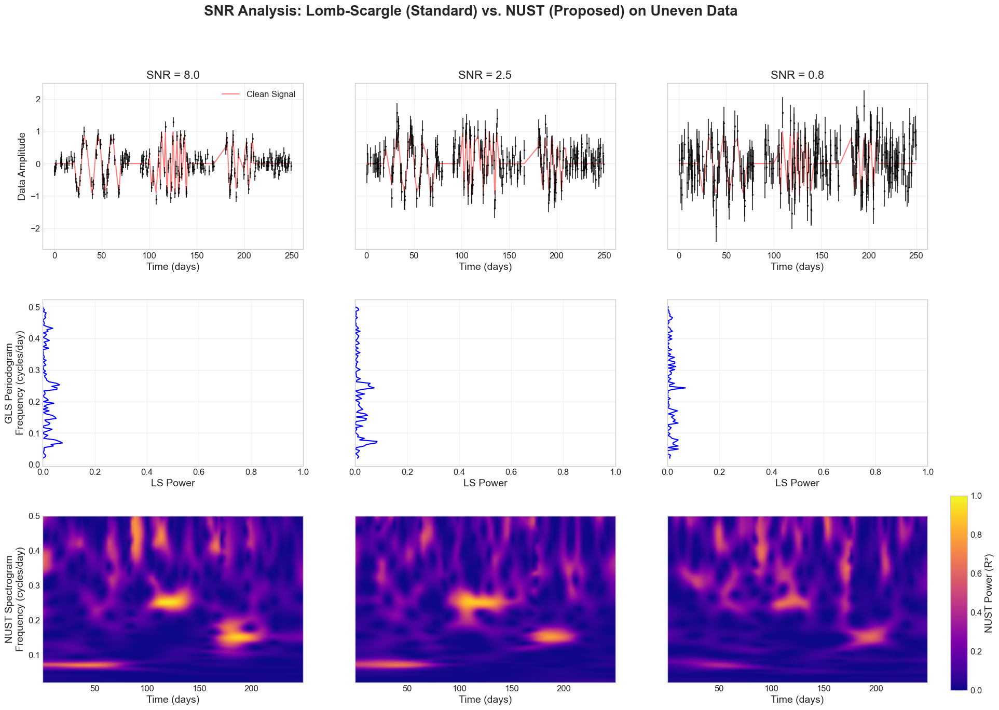

In [ ]:
def run_gls_vs_nust_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(3, len(snr_levels), figsize=(22, 15), sharey='row')
    fig.suptitle('SNR Analysis: Lomb-Scargle (Standard) vs. NUST (Proposed) on Uneven Data', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.18, 'gamma': 0.5, 'kde_bandwidth': 15.0
    }
    freq_grid = np.linspace(0.02, 0.5, 100) # Common frequency grid

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning GLS vs. NUST analysis for SNR = {snr}...")
        
        # --- Generate the challenging unevenly sampled data ---
        times, data, uncertainties, clean_signal, info, _ = generate_transient_signal_snr(snr, 'uneven')
        
        # --- Row 1: Plot Unevenly Sampled Data ---
        ax_data = axes[0, i]
        ax_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_data.plot(times, clean_signal, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_data.errorbar(times, data, yerr=uncertainties, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_data.set_ylabel("Data Amplitude")
        
        # --- Row 2: Lomb-Scargle (GLS) Periodogram ---
        ax_gls = axes[1, i]
        ls_power = compute_lomb_scargle(times, data, uncertainties, freq_grid)
        ax_gls.plot(ls_power, freq_grid, 'b-')
        ax_gls.set_xlim(0, 1)
        if i == 0: ax_gls.set_ylabel("GLS Periodogram\nFrequency (cycles/day)")

        # --- Row 3: NUST Spectrogram ---
        ax_nust = axes[2, i]
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        im = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                  shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST Spectrogram\nFrequency (cycles/day)")
            
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[0,:]: ax.set_xlabel("Time (days)")
    for ax in axes[1,:]: ax.set_xlabel("LS Power")
    for ax in axes[2,:]: ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.3, wspace=0.2)
    cbar_ax = fig.add_axes([0.92, 0.1, 0.015, 0.25])
    fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()
run_gls_vs_nust_snr_comparison()

## SNR test for controlled, sparse randomly sampled chirp signal


Running full analysis for SNR = 8.0...
Signal Variance: 0.2500
Signal Variance: 0.1497
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 2.5...
Signal Variance: 0.2500
Signal Variance: 0.1593
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 0.8...
Signal Variance: 0.2500
Signal Variance: 0.1517
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


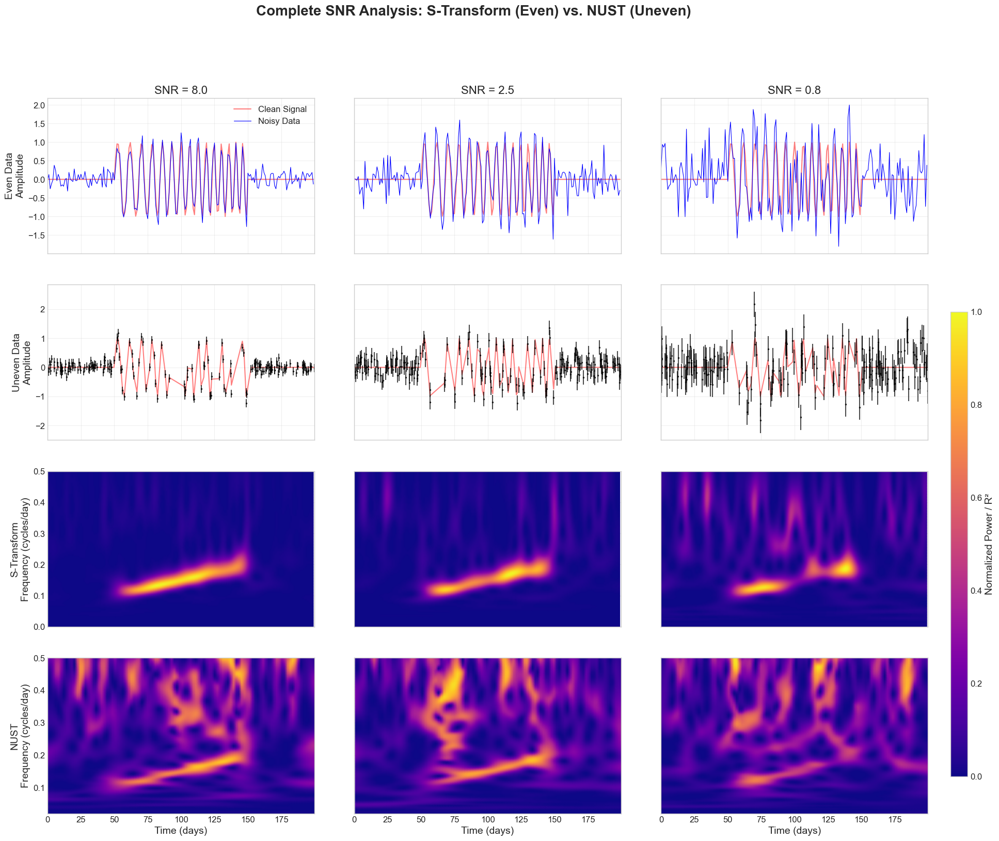

In [ ]:

np.random.seed(2025)

def clean_signal_func_11(times):
    signal_clean = np.zeros_like(times)
    
    # The chirp signal is active only between day 50 and 150
    mask = (times > 50) & (times < 150)
    if np.any(mask):
        t_chirp = times[mask]
        t_norm = (t_chirp - 50) / 100  # Normalize time over the 100-day duration
        f_start, f_end = 0.1, 0.2
        # Correct phase calculation for a linear chirp
        phase = 2 * np.pi * (f_start * t_chirp + 0.5 * (f_end - f_start) * t_norm * (t_chirp - 50))
        signal_clean[mask] = 1.0 * np.sin(phase)
        
    return signal_clean

def generate_signal_11_snr(snr, sampling_type='even'):
    
    # 1. Create the time array based on requested sampling type
    if sampling_type == 'even':
        fs = 1.0
        times = np.arange(0, 200, 1 / fs)
    elif sampling_type == 'uneven':
        fs = None # No fixed sampling rate for uneven data
        times = np.concatenate([
            np.sort(np.random.uniform(0, 50, 70)),
            np.sort(np.random.uniform(50, 150, 60)), # Mid-sparse in chirp region
            np.sort(np.random.uniform(150, 200, 70))
        ])
        
    # 2. Use the helper to generate the noisy signal
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_11, snr)
    
    # 3. Package information
    info = {
        'freq_range': [0.1, 0.2],
        'snr': snr,
        'description': f'Transient Chirp (SNR={snr}, {sampling_type})'
    }
    
    # 4. Return all 6 items in the correct order
    return times, data, uncertainties, signal_clean, info, fs

def run_full_transient_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(4, len(snr_levels), figsize=(22, 18), sharex='col', sharey='row')
    fig.suptitle('Complete SNR Analysis: S-Transform (Even) vs. NUST (Uneven)', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.15, 'gamma': 0.4, 'kde_bandwidth': 20.0
    }

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning full analysis for SNR = {snr}...")
        
        # --- Generate Data ---
        times_even, data_even, _, clean_even, info, fs = generate_signal_11_snr(snr, 'even')
        times_uneven, data_uneven, uncertainties_uneven, clean_uneven, _, _ = generate_signal_11_snr(snr, 'uneven')

        # --- Row 1: Plot Evenly Sampled Data ---
        ax_even_data = axes[0, i]
        ax_even_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_even_data.plot(times_even, clean_even, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_even_data.plot(times_even, data_even, 'b-', lw=0.8, label='Noisy Data')
        if i == 0: ax_even_data.set_ylabel("Even Data\nAmplitude")
        
        # --- Row 2: Plot Unevenly Sampled Data ---
        ax_uneven_data = axes[1, i]
        ax_uneven_data.plot(times_uneven, clean_uneven, 'r-', alpha=0.5, lw=1.5)
        ax_uneven_data.errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_uneven_data.set_ylabel("Uneven Data\nAmplitude")
        
        # --- Row 3: S-Transform of Even Data ---
        ax_st = axes[2, i]
        st_result = st.st(data_even)
        st_power = np.abs(st_result)**2
        st_power_normalized = st_power / np.max(st_power)
        
        st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
        im_st = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                                 shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_st.set_ylabel("S-Transform\nFrequency (cycles/day)")
        
        # --- Row 4: NUST of Uneven Data ---
        ax_nust = axes[3, i]
        freq_grid = np.linspace(0.02, 0.5, 100) # Define freq grid for NUST
        tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100)
        
        nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, tau_grid, freq_grid, **nust_params)
        
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                     shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST\nFrequency (cycles/day)")
    
    # --- Final Formatting ---
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[3,:]: 
        ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.15)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.5])
    fig.colorbar(im_nust, cax=cbar_ax, label='Normalized Power / R²')
    
    plt.show()

run_full_transient_snr_comparison()




Running GLS vs. NUST analysis for SNR = 8.0...
Signal Variance: 0.1218
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running GLS vs. NUST analysis for SNR = 2.5...
Signal Variance: 0.1624
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running GLS vs. NUST analysis for SNR = 0.8...
Signal Variance: 0.1626
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


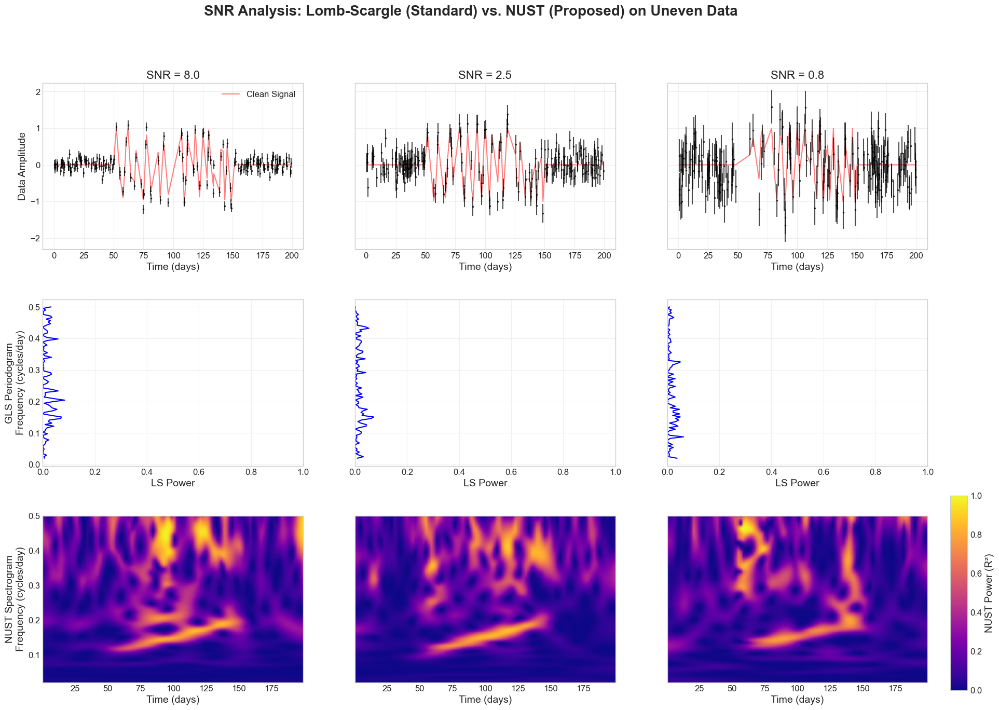

In [ ]:
def run_gls_vs_nust_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(3, len(snr_levels), figsize=(22, 15), sharey='row')
    fig.suptitle('SNR Analysis: Lomb-Scargle (Standard) vs. NUST (Proposed) on Uneven Data', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.15, 'gamma': 0.4, 'kde_bandwidth': 20.0
    }
    freq_grid = np.linspace(0.02, 0.5, 100) # Common frequency grid

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning GLS vs. NUST analysis for SNR = {snr}...")
        
        # --- Generate the challenging unevenly sampled data ---
        times, data, uncertainties, clean_signal, info, _ = generate_signal_11_snr(snr, 'uneven')
        
        # --- Row 1: Plot Unevenly Sampled Data ---
        ax_data = axes[0, i]
        ax_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_data.plot(times, clean_signal, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_data.errorbar(times, data, yerr=uncertainties, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_data.set_ylabel("Data Amplitude")
        
        # --- Row 2: Lomb-Scargle (GLS) Periodogram ---
        ax_gls = axes[1, i]
        ls_power = compute_lomb_scargle(times, data, uncertainties, freq_grid)
        ax_gls.plot(ls_power, freq_grid, 'b-')
        ax_gls.set_xlim(0, 1)
        if i == 0: ax_gls.set_ylabel("GLS Periodogram\nFrequency (cycles/day)")

        # --- Row 3: NUST Spectrogram ---
        ax_nust = axes[2, i]
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        im = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                  shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST Spectrogram\nFrequency (cycles/day)")
            
    # --- Final Formatting ---
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    # Set x-labels
    for ax in axes[0,:]: ax.set_xlabel("Time (days)")
    for ax in axes[1,:]: ax.set_xlabel("LS Power")
    for ax in axes[2,:]: ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.3, wspace=0.2)
    cbar_ax = fig.add_axes([0.92, 0.1, 0.015, 0.25])
    fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()

run_gls_vs_nust_snr_comparison()

## SNR test for controlled, sparse randomly sampled high frequency burst


Running full analysis for SNR = 8.0...
Signal Variance: 0.0250
Signal Variance: 0.0365
Computing NUST (100τ x 101f = 10100 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 2.5...
Signal Variance: 0.0250
Signal Variance: 0.0319
Computing NUST (100τ x 101f = 10100 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 0.8...
Signal Variance: 0.0250
Signal Variance: 0.0366
Computing NUST (100τ x 101f = 10100 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


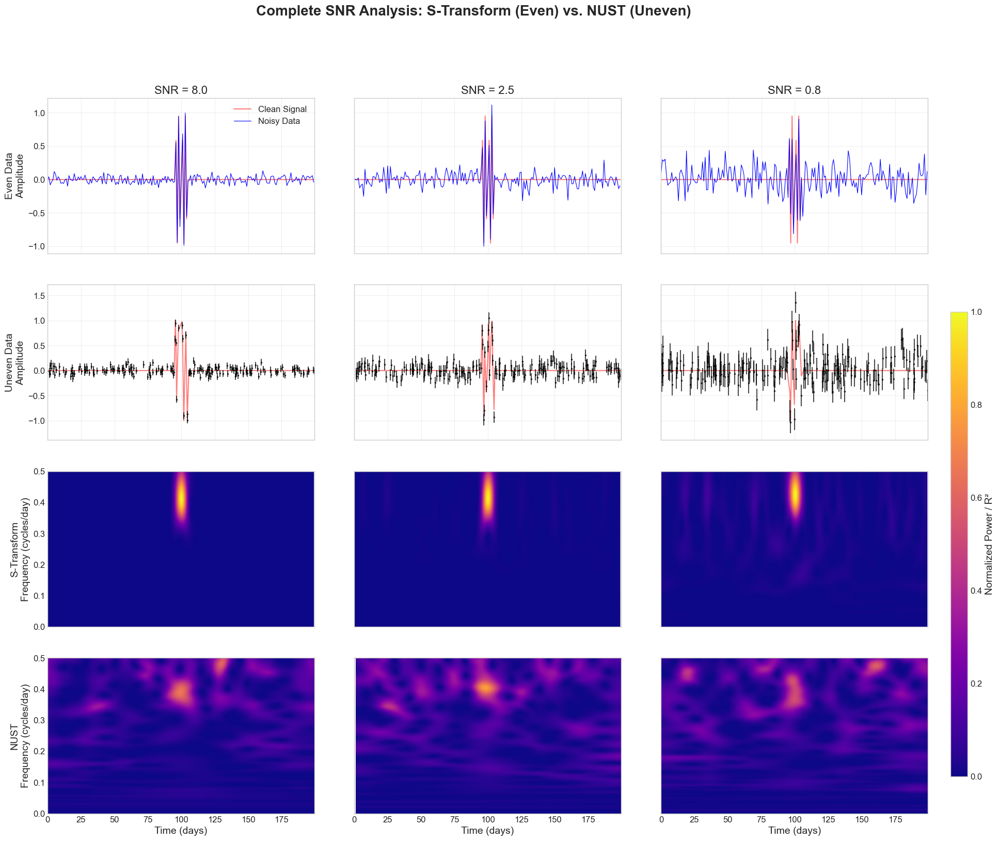

In [ ]:
np.random.seed(2025)

def clean_signal_func_12(times):
    signal_clean = np.zeros_like(times)
    
    # The high-frequency burst is active only between day 95 and 105
    mask = (times > 95) & (times < 105)
    if np.any(mask):
        signal_clean[mask] = 1.0 * np.sin(2 * np.pi * 0.4 * times[mask])
        
    return signal_clean

def generate_signal_12_snr(snr, sampling_type='even'):
   
    if sampling_type == 'even':
        fs = 1.0
        times = np.arange(0, 200, 1 / fs)
    elif sampling_type == 'uneven':
        fs = None # No fixed sampling rate for uneven data
        times = np.concatenate([
            np.sort(np.random.uniform(0, 90, 87)),
            np.sort(np.random.uniform(90, 110, 26)), # Sparse in burst region
            np.sort(np.random.uniform(110, 200, 87))
        ])
        
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_12, snr)
    
    # 3. Package information
    info = {
        'freq': 0.4,
        'snr': snr,
        'description': f'Transient Burst (SNR={snr}, {sampling_type})'
    }
    
    # 4. Return all 6 items in the correct order
    return times, data, uncertainties, signal_clean, info, fs
def run_full_transient_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(4, len(snr_levels), figsize=(22, 18), sharex='col', sharey='row')
    fig.suptitle('Complete SNR Analysis: S-Transform (Even) vs. NUST (Uneven)', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.1, 'gamma': 0.6, 'kde_bandwidth': 8.0
    }

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning full analysis for SNR = {snr}...")
        
        # --- Generate Data ---
        times_even, data_even, _, clean_even, info, fs = generate_signal_12_snr(snr, 'even')
        times_uneven, data_uneven, uncertainties_uneven, clean_uneven, _, _ = generate_signal_12_snr(snr, 'uneven')

        # --- Row 1: Plot Evenly Sampled Data ---
        ax_even_data = axes[0, i]
        ax_even_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_even_data.plot(times_even, clean_even, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_even_data.plot(times_even, data_even, 'b-', lw=0.8, label='Noisy Data')
        if i == 0: ax_even_data.set_ylabel("Even Data\nAmplitude")
        
        # --- Row 2: Plot Unevenly Sampled Data ---
        ax_uneven_data = axes[1, i]
        ax_uneven_data.plot(times_uneven, clean_uneven, 'r-', alpha=0.5, lw=1.5)
        ax_uneven_data.errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_uneven_data.set_ylabel("Uneven Data\nAmplitude")
        
        # --- Row 3: S-Transform of Even Data ---
        ax_st = axes[2, i]
        st_result = st.st(data_even)
        st_power = np.abs(st_result)**2
        st_power_normalized = st_power / np.max(st_power)
        
        st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
        im_st = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                                 shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_st.set_ylabel("S-Transform\nFrequency (cycles/day)")
        
        # --- Row 4: NUST of Uneven Data ---
        ax_nust = axes[3, i]
        #freq_grid = np.linspace(0.02, 0.5, 100) # Define freq grid for NUST
        freq_grid = st_freq_axis
        tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100)
        
        nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, tau_grid, freq_grid, **nust_params)
        
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                     shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST\nFrequency (cycles/day)")
    
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[3,:]: 
        ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.15)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.5])
    fig.colorbar(im_nust, cax=cbar_ax, label='Normalized Power / R²')
    
    plt.show()

run_full_transient_snr_comparison()

## SNR test for controlled, sparse randomly sampled for multi-appearance signal


Running full analysis for SNR = 8.0...
Signal Variance: 0.2400
Signal Variance: 0.2222
Computing NUST (100τ x 63f = 6300 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 2.5...
Signal Variance: 0.2400
Signal Variance: 0.2638
Computing NUST (100τ x 63f = 6300 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 0.8...
Signal Variance: 0.2400
Signal Variance: 0.2209
Computing NUST (100τ x 63f = 6300 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


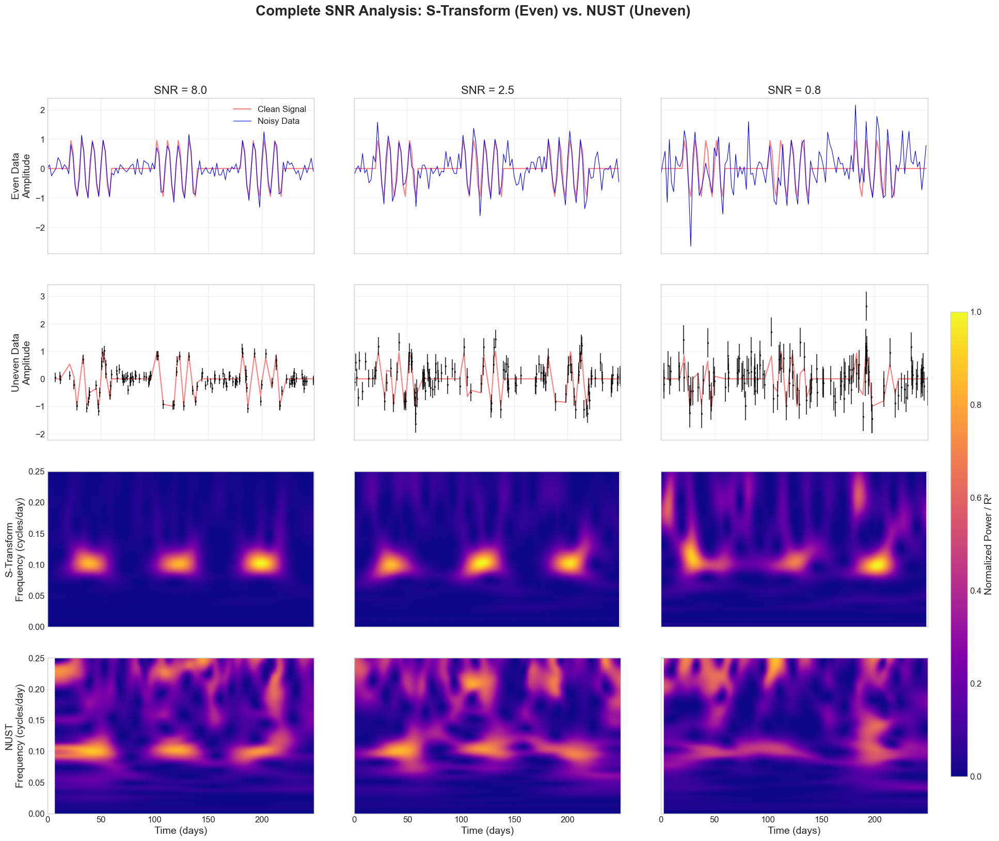

In [ ]:

np.random.seed(2025)

def clean_signal_func_13(times):
    """
    Generates the clean signal for the multi-appearance signal (Case 13).
    """
    signal_clean = np.zeros_like(times)
    freq = 0.1
    
    # Signal is present in three distinct windows
    mask1 = (times > 20) & (times < 60)
    mask2 = (times > 100) & (times < 140)
    mask3 = (times > 180) & (times < 220)
    
    if np.any(mask1):
        signal_clean[mask1] = np.sin(2 * np.pi * freq * times[mask1])
    if np.any(mask2):
        signal_clean[mask2] = np.sin(2 * np.pi * freq * times[mask2])
    if np.any(mask3):
        signal_clean[mask3] = np.sin(2 * np.pi * freq * times[mask3])
        
    return signal_clean

def generate_signal_13_snr(snr, sampling_type='even'):
    
    if sampling_type == 'even':
        fs = 0.5
        times = np.arange(0, 250, 1 / fs)
    elif sampling_type == 'uneven':
        fs = None # No fixed sampling rate for uneven data
        # Mid-sparse sampling everywhere
        times = np.sort(np.random.uniform(0, 250, 125))
        
    # 2. Use the helper to generate the noisy signal
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_13, snr)
    
    # 3. Package information
    info = {
        'freq': 0.1,
        'snr': snr,
        'description': f'Multi-Appearance Signal (SNR={snr}, {sampling_type})'
    }
    
    # 4. Return all 6 items in the correct order
    return times, data, uncertainties, signal_clean, info, fs
def run_full_transient_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(4, len(snr_levels), figsize=(22, 18), sharex='col', sharey='row')
    fig.suptitle('Complete SNR Analysis: S-Transform (Even) vs. NUST (Uneven)', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.08, 'gamma': 0.5, 'kde_bandwidth': 15.0
    }

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning full analysis for SNR = {snr}...")
        
        # --- Generate Data ---
        times_even, data_even, _, clean_even, info, fs = generate_signal_13_snr(snr, 'even')
        times_uneven, data_uneven, uncertainties_uneven, clean_uneven, _, _ = generate_signal_13_snr(snr, 'uneven')

        # --- Row 1: Plot Evenly Sampled Data ---
        ax_even_data = axes[0, i]
        ax_even_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_even_data.plot(times_even, clean_even, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_even_data.plot(times_even, data_even, 'b-', lw=0.8, label='Noisy Data')
        if i == 0: ax_even_data.set_ylabel("Even Data\nAmplitude")
        
        # --- Row 2: Plot Unevenly Sampled Data ---
        ax_uneven_data = axes[1, i]
        ax_uneven_data.plot(times_uneven, clean_uneven, 'r-', alpha=0.5, lw=1.5)
        ax_uneven_data.errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_uneven_data.set_ylabel("Uneven Data\nAmplitude")
        
        # --- Row 3: S-Transform of Even Data ---
        ax_st = axes[2, i]
        st_result = st.st(data_even)
        st_power = np.abs(st_result)**2
        st_power_normalized = st_power / np.max(st_power)
        
        st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
        im_st = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                                 shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_st.set_ylabel("S-Transform\nFrequency (cycles/day)")
        
        # --- Row 4: NUST of Uneven Data ---
        ax_nust = axes[3, i]
        #freq_grid = np.linspace(0.02, 0.5, 60) # Define freq grid for NUST
        freq_grid = st_freq_axis
        tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100)
        
        nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, tau_grid, freq_grid, **nust_params)
        
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                     shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST\nFrequency (cycles/day)")
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[3,:]: # Set xlabel only for the bottom row
        ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.15)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.5])
    fig.colorbar(im_nust, cax=cbar_ax, label='Normalized Power / R²')
    
    plt.show()
run_full_transient_snr_comparison()





Running GLS vs. NUST analysis for SNR = 8.0...
Signal Variance: 0.2555
Computing NUST (100τ x 60f = 6000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running GLS vs. NUST analysis for SNR = 2.5...
Signal Variance: 0.2552
Computing NUST (100τ x 60f = 6000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running GLS vs. NUST analysis for SNR = 0.8...
Signal Variance: 0.3023
Computing NUST (100τ x 60f = 6000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


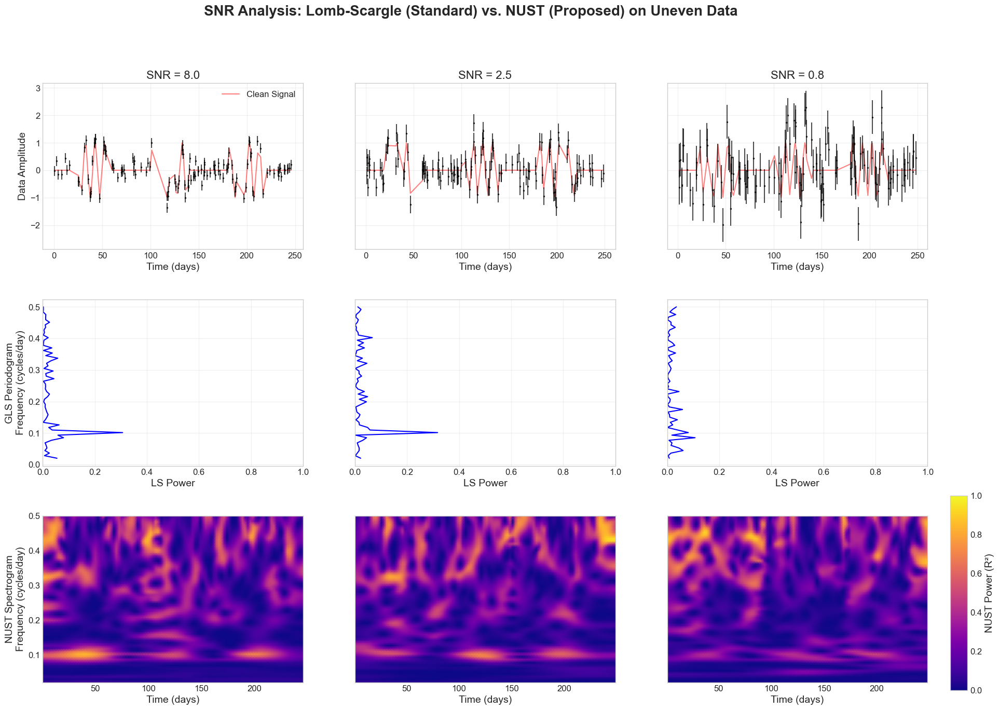

In [ ]:
def run_gls_vs_nust_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(3, len(snr_levels), figsize=(22, 15), sharey='row')
    fig.suptitle('SNR Analysis: Lomb-Scargle (Standard) vs. NUST (Proposed) on Uneven Data', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.11, 'gamma': 0.5, 'kde_bandwidth': 15.0
    }
    freq_grid = np.linspace(0.02, 0.5, 60) # Common frequency grid

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning GLS vs. NUST analysis for SNR = {snr}...")
        
        # --- Generate the challenging unevenly sampled data ---
        times, data, uncertainties, clean_signal, info, _ = generate_signal_13_snr(snr, 'uneven')
        
        # --- Row 1: Plot Unevenly Sampled Data ---
        ax_data = axes[0, i]
        ax_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_data.plot(times, clean_signal, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_data.errorbar(times, data, yerr=uncertainties, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_data.set_ylabel("Data Amplitude")
        
        # --- Row 2: Lomb-Scargle (GLS) Periodogram ---
        ax_gls = axes[1, i]
        ls_power = compute_lomb_scargle(times, data, uncertainties, freq_grid)
        ax_gls.plot(ls_power, freq_grid, 'b-')
        ax_gls.set_xlim(0, 1)
        if i == 0: ax_gls.set_ylabel("GLS Periodogram\nFrequency (cycles/day)")

        # --- Row 3: NUST Spectrogram ---
        ax_nust = axes[2, i]
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        im = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                  shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST Spectrogram\nFrequency (cycles/day)")
            
    # --- Final Formatting ---
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[0,:]: ax.set_xlabel("Time (days)")
    for ax in axes[1,:]: ax.set_xlabel("LS Power")
    for ax in axes[2,:]: ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.3, wspace=0.2)
    cbar_ax = fig.add_axes([0.92, 0.1, 0.015, 0.25])
    fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()
run_gls_vs_nust_snr_comparison()

## SNR test for controlled, sparse randomly sampled for gapped single sinusoid


Running full analysis for SNR = 8.0...
Signal Variance: 0.3251
Signal Variance: 0.2917
Computing NUST (100τ x 41f = 4100 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 2.5...
Signal Variance: 0.3251
Signal Variance: 0.2928
Computing NUST (100τ x 41f = 4100 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running full analysis for SNR = 0.8...
Signal Variance: 0.3251
Signal Variance: 0.3529
Computing NUST (100τ x 41f = 4100 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


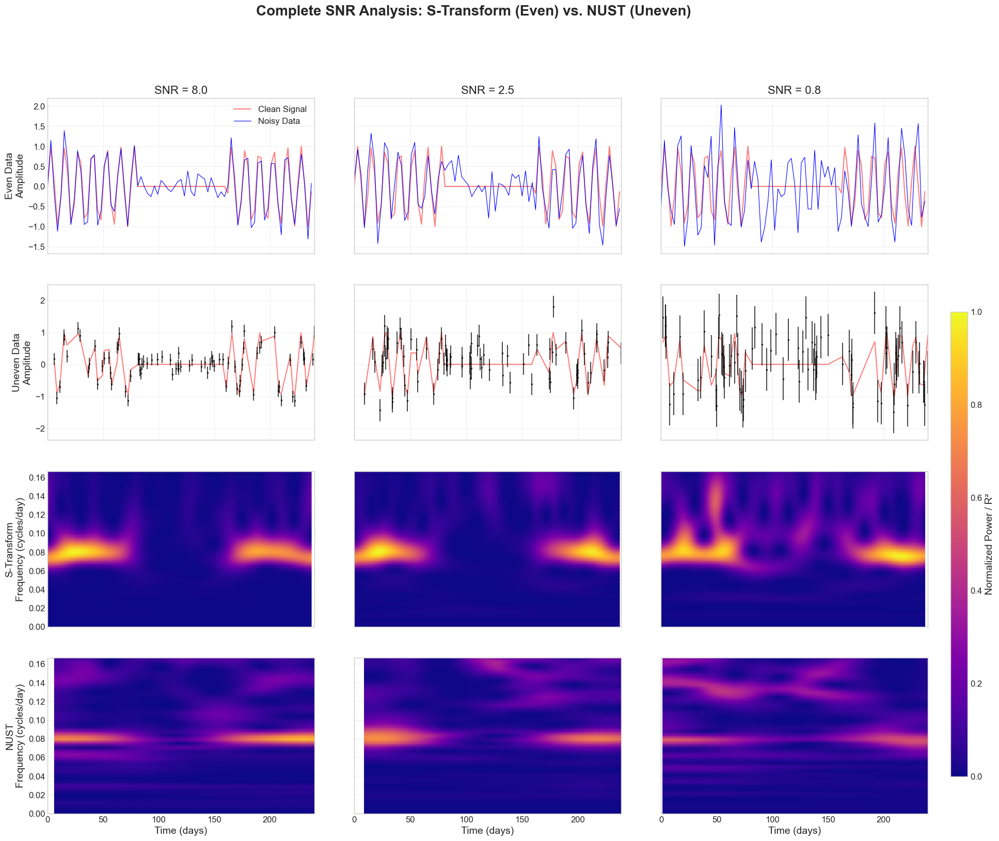

In [ ]:
np.random.seed(2025)
def clean_signal_func_14(times):
    signal_clean = np.zeros_like(times)
    freq = 0.08
    
    # Signal is present at the beginning and end, but not in the middle
    mask = (times < 80) | (times > 160)
    if np.any(mask):
        signal_clean[mask] = np.sin(2 * np.pi * freq * times[mask])
        
    return signal_clean

def generate_signal_14_snr(snr, sampling_type='even'):

    # 1. Create the time array based on requested sampling type
    if sampling_type == 'even':
        fs = 0.333
        times = np.arange(0, 240, 1 / fs)
    elif sampling_type == 'uneven':
        fs = None # No fixed sampling rate for uneven data
        # Mid-low sparse sampling everywhere
        times = np.sort(np.random.uniform(0, 240, 80))
        
    # 2. Use the helper to generate the noisy signal
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_14, snr)
    
    # 3. Package information
    info = {
        'freq': 0.08,
        'snr': snr,
        'description': f'Signal with Central Gap (SNR={snr}, {sampling_type})'
    }
    
    # 4. Return all 6 items in the correct order
    return times, data, uncertainties, signal_clean, info, fs
def run_full_transient_snr_comparison():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    fig, axes = plt.subplots(4, len(snr_levels), figsize=(22, 18), sharex='col', sharey='row')
    fig.suptitle('Complete SNR Analysis: S-Transform (Even) vs. NUST (Uneven)', fontsize=20, fontweight='bold')

    # NUST parameters will be the same for all SNR levels
    nust_params = {
        'use_voronoi_weights': False, 'use_adaptive_window': True,
        'alpha': 0.18, 'gamma': 0.5, 'kde_bandwidth': 20.0
    }

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning full analysis for SNR = {snr}...")
        
        # --- Generate Data ---
        times_even, data_even, _, clean_even, info, fs = generate_signal_14_snr(snr, 'even')
        times_uneven, data_uneven, uncertainties_uneven, clean_uneven, _, _ = generate_signal_14_snr(snr, 'uneven')

        # --- Row 1: Plot Evenly Sampled Data ---
        ax_even_data = axes[0, i]
        ax_even_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_even_data.plot(times_even, clean_even, 'r-', alpha=0.5, lw=1.5, label='Clean Signal')
        ax_even_data.plot(times_even, data_even, 'b-', lw=0.8, label='Noisy Data')
        if i == 0: ax_even_data.set_ylabel("Even Data\nAmplitude")
        
        # --- Row 2: Plot Unevenly Sampled Data ---
        ax_uneven_data = axes[1, i]
        ax_uneven_data.plot(times_uneven, clean_uneven, 'r-', alpha=0.5, lw=1.5)
        ax_uneven_data.errorbar(times_uneven, data_uneven, yerr=uncertainties_uneven, fmt='.', color='k', markersize=3, alpha=0.7)
        if i == 0: ax_uneven_data.set_ylabel("Uneven Data\nAmplitude")
        
        # --- Row 3: S-Transform of Even Data ---
        ax_st = axes[2, i]
        st_result = st.st(data_even)
        st_power = np.abs(st_result)**2
        st_power_normalized = st_power / np.max(st_power)
        
        st_freq_axis = np.linspace(0, fs / 2, st_power_normalized.shape[0])
        im_st = ax_st.pcolormesh(times_even, st_freq_axis, st_power_normalized, 
                                 shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_st.set_ylabel("S-Transform\nFrequency (cycles/day)")
        
        # --- Row 4: NUST of Uneven Data ---
        ax_nust = axes[3, i]
        #freq_grid = np.linspace(0.02, 0.5, 100) # Define freq grid for NUST
        freq_grid = st_freq_axis
        tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100)
        
        nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, tau_grid, freq_grid, **nust_params)
        
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, 
                                     shading='gouraud', cmap='plasma', vmin=0, vmax=1)
        if i == 0: ax_nust.set_ylabel("NUST\nFrequency (cycles/day)")
    
    for ax_row in axes:
        for ax in ax_row:
            ax.grid(True, alpha=0.3)
    
    for ax in axes[3,:]: 
        ax.set_xlabel("Time (days)")
        
    axes[0,0].legend()
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.15)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.015, 0.5])
    fig.colorbar(im_nust, cax=cbar_ax, label='Normalized Power / R²')
    
    plt.show()


run_full_transient_snr_comparison()

## Test for different Kernels

Running NUST with 'Gaussian' kernel...
Running NUST with 'Uniform (Tophat)' kernel...
Running NUST with 'Epanechnikov' kernel...
Running NUST with 'Linear (Triangle)' kernel...
Running NUST with 'Cosine' kernel...
Running NUST with 'Exponential' kernel...


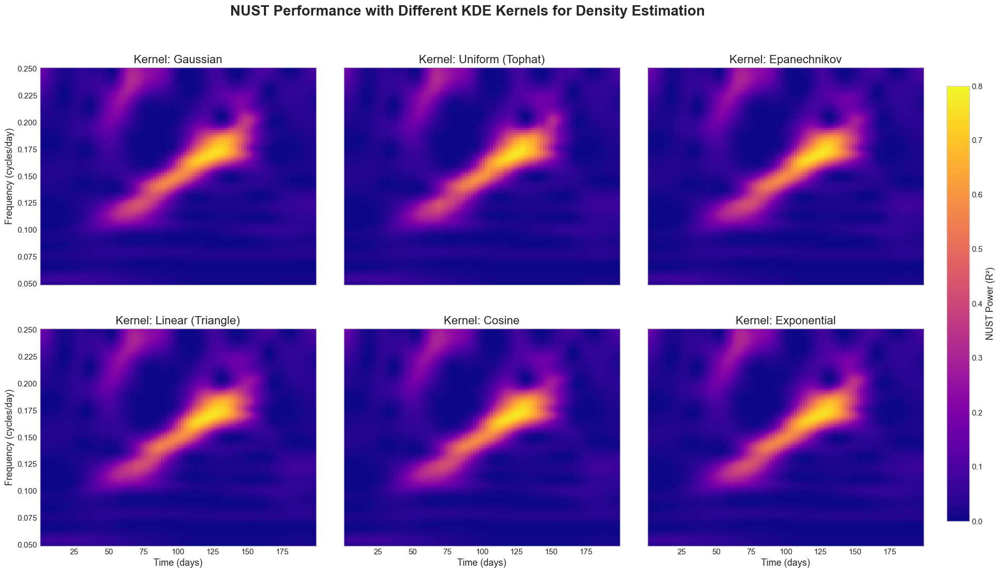

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from stockwell import st

from sklearn.neighbors import KernelDensity

np.random.seed(2023)

def generate_signal_with_snr(times, clean_signal_func, snr):
    signal_clean = clean_signal_func(times)
    signal_variance = np.var(signal_clean)
    if signal_variance == 0: noise_std = 1.0
    else: noise_std = np.sqrt(signal_variance / snr)
    noise = np.random.normal(0, noise_std, len(times))
    data = signal_clean + noise
    uncertainties = np.full_like(data, noise_std)
    return data, uncertainties, signal_clean

def estimate_density_sklearn(times, bandwidth, kernel='gaussian'):
    """A new KDE estimator using scikit-learn for kernel flexibility."""
    times_reshaped = times[:, np.newaxis]
    kde = KernelDensity(kernel=kernel, bandwidth=bandwidth).fit(times_reshaped)
    def density_func(eval_points):
        eval_points_reshaped = eval_points[:, np.newaxis]
        log_density = kde.score_samples(eval_points_reshaped)
        return np.exp(log_density)
    return density_func

def nust_flexible_kde(times, data, uncertainties, tau_grid, freq_grid, **nust_params):
    """A modified NUST that accepts a kernel argument."""
    N_tau, N_freq = len(tau_grid), len(freq_grid)
    nust_result = np.zeros((N_tau, N_freq))
    measurement_weights = 1.0 / uncertainties**2
    use_voronoi = nust_params.get('use_voronoi_weights', True); use_adaptive = nust_params.get('use_adaptive_window', True)
    alpha = nust_params.get('alpha', 1.0); gamma = nust_params.get('gamma', 0.5)
    kde_bandwidth = nust_params.get('kde_bandwidth', 15.0); kernel = nust_params.get('kernel', 'gaussian')

    voronoi_weights = compute_voronoi_weights_1d(times) if use_voronoi else np.ones_like(times)
    density_evaluator = None
    if use_adaptive:
        density_evaluator = estimate_density_sklearn(times, bandwidth=kde_bandwidth, kernel=kernel)

    for i, tau in enumerate(tau_grid):
        for j, freq in enumerate(freq_grid):
            if freq <= 0: continue
            sigma_t = alpha / abs(freq)
            if use_adaptive and density_evaluator is not None:
                local_density = max(density_evaluator(np.array([tau]))[0], 1e-10)
                sigma_t *= (local_density ** (-gamma))
            gaussian_weights = np.exp(-0.5 * ((times - tau) / sigma_t)**2)
            total_weights = measurement_weights * voronoi_weights * gaussian_weights
            significant_mask = gaussian_weights > 0.001
            if np.sum(significant_mask) < 5: continue
            t_local, y_local, w_local = times[significant_mask], data[significant_mask], total_weights[significant_mask]
            omega = 2 * np.pi * freq
            try:
                A = np.vstack([np.cos(omega*t_local), np.sin(omega*t_local), np.ones_like(t_local)]).T
                W = np.diag(w_local)
                theta = np.linalg.solve(A.T @ W @ A, A.T @ W @ y_local)
                y_pred = A @ theta
                ss_res = np.sum(w_local * (y_local - y_pred)**2)
                y_mean_weighted = np.sum(w_local * y_local) / np.sum(w_local)
                ss_tot = np.sum(w_local * (y_local - y_mean_weighted)**2)
                if ss_tot > 0: nust_result[i, j] = max(0, 1 - (ss_res / ss_tot))
            except (np.linalg.LinAlgError, ValueError): continue
    return nust_result

def run_kernel_comparison():
    """
    Generates a signal and runs NUST with different KDE kernels, plotting the results.
    """
    # --- A. Signal Generation (Using Case 11: Transient Chirp) ---
    def clean_signal_func(times):
        signal = np.zeros_like(times); mask = (times > 50) & (times < 150)
        if not np.any(mask): return signal
        t_chirp = times[mask]; t_norm = (t_chirp - 50) / 100; f_start, f_end = 0.1, 0.2
        phase = 2 * np.pi * (f_start * t_chirp + 0.5 * (f_end - f_start) * t_norm * (t_chirp-50))
        signal[mask] = 1.0 * np.sin(phase)
        return signal

    times = np.concatenate([np.sort(np.random.uniform(0, 50, 70)), np.sort(np.random.uniform(50, 150, 90)), np.sort(np.random.uniform(150, 200, 40))])
    data, uncertainties, _ = generate_signal_with_snr(times, clean_signal_func, snr=5.0)

    kernels = ['gaussian', 'tophat', 'epanechnikov', 'linear', 'cosine', 'exponential']
    plot_titles = ['Gaussian', 'Uniform (Tophat)', 'Epanechnikov', 'Linear (Triangle)', 'Cosine', 'Exponential']
    
    fig, axes = plt.subplots(2, 3, figsize=(22, 12), sharex=True, sharey=True)
    fig.suptitle('NUST Performance with Different KDE Kernels for Density Estimation', fontsize=20, fontweight='bold')
    
    nust_params = {'use_voronoi_weights': False, 'use_adaptive_window': True, 'alpha': 0.25, 'gamma': 0.4, 'kde_bandwidth': 20.0}
    freq_grid = np.linspace(0.05, 0.25, 100)
    tau_grid = np.linspace(times.min(), times.max(), 100)
    im = None

    for i, (kernel, title) in enumerate(zip(kernels, plot_titles)):
        print(f"Running NUST with '{title}' kernel...")
        ax = axes.flat[i]
        
        nust_params['kernel'] = kernel
        nust_power = nust_flexible_kde(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        im = ax.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=0.8)
        ax.set_title(f"Kernel: {title}", fontsize=16)
        
        if i % 3 == 0: ax.set_ylabel("Frequency (cycles/day)")
        if i >= 3: ax.set_xlabel("Time (days)")
            
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.1)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    if im: fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    plt.savefig("kerneltest.png", dpi=300, bbox_inches="tight")
    plt.show()

run_kernel_comparison()

Running NUST with 'Uniform (Tophat)' kernel...
Running NUST with 'Epanechnikov' kernel...
Running NUST with 'Linear (Triangle)' kernel...
Running NUST with 'Cosine' kernel...
Running NUST with 'Exponential' kernel...


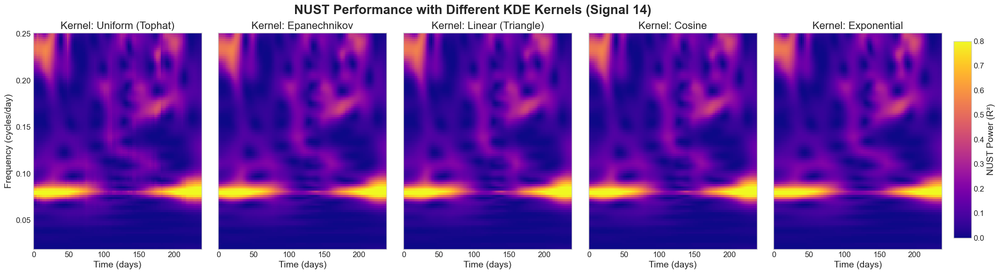

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from stockwell import st
from sklearn.neighbors import KernelDensity

np.random.seed(2025)

def generate_signal_with_snr(times, clean_signal_func, snr):
    signal_clean = clean_signal_func(times)
    signal_variance = np.var(signal_clean)
    if signal_variance == 0: noise_std = 1.0
    else: noise_std = np.sqrt(signal_variance / snr)
    noise = np.random.normal(0, noise_std, len(times))
    data = signal_clean + noise
    uncertainties = np.full_like(data, noise_std)
    return data, uncertainties, signal_clean


def estimate_density_sklearn(times, bandwidth, kernel='gaussian'):
    """A new KDE estimator using scikit-learn for kernel flexibility."""
    times_reshaped = times[:, np.newaxis]
    kde = KernelDensity(kernel=kernel, bandwidth=bandwidth).fit(times_reshaped)
    def density_func(eval_points):
        eval_points_reshaped = eval_points[:, np.newaxis]
        log_density = kde.score_samples(eval_points_reshaped)
        return np.exp(log_density)
    return density_func

def nust_flexible_kde(times, data, uncertainties, tau_grid, freq_grid, **nust_params):
    """A modified NUST that accepts a kernel argument."""
    N_tau, N_freq = len(tau_grid), len(freq_grid)
    nust_result = np.zeros((N_tau, N_freq))
    measurement_weights = 1.0 / uncertainties**2
    use_voronoi = nust_params.get('use_voronoi_weights', True); use_adaptive = nust_params.get('use_adaptive_window', True)
    alpha = nust_params.get('alpha', 1.0); gamma = nust_params.get('gamma', 0.5)
    kde_bandwidth = nust_params.get('kde_bandwidth', 15.0); kernel = nust_params.get('kernel', 'gaussian')

    voronoi_weights = compute_voronoi_weights_1d(times) if use_voronoi else np.ones_like(times)
    density_evaluator = None
    if use_adaptive:
        density_evaluator = estimate_density_sklearn(times, bandwidth=kde_bandwidth, kernel=kernel)

    for i, tau in enumerate(tau_grid):
        for j, freq in enumerate(freq_grid):
            if freq <= 0: continue
            sigma_t = alpha / abs(freq)
            if use_adaptive and density_evaluator is not None:
                local_density = max(density_evaluator(np.array([tau]))[0], 1e-10)
                sigma_t *= (local_density ** (-gamma))
            gaussian_weights = np.exp(-0.5 * ((times - tau) / sigma_t)**2)
            total_weights = measurement_weights * voronoi_weights * gaussian_weights
            significant_mask = gaussian_weights > 0.001
            if np.sum(significant_mask) < 5: continue
            t_local, y_local, w_local = times[significant_mask], data[significant_mask], total_weights[significant_mask]
            omega = 2 * np.pi * freq
            try:
                A = np.vstack([np.cos(omega*t_local), np.sin(omega*t_local), np.ones_like(t_local)]).T
                W = np.diag(w_local)
                theta = np.linalg.solve(A.T @ W @ A, A.T @ W @ y_local)
                y_pred = A @ theta
                ss_res = np.sum(w_local * (y_local - y_pred)**2)
                y_mean_weighted = np.sum(w_local * y_local) / np.sum(w_local)
                ss_tot = np.sum(w_local * (y_local - y_mean_weighted)**2)
                if ss_tot > 0: nust_result[i, j] = max(0, 1 - (ss_res / ss_tot))
            except (np.linalg.LinAlgError, ValueError): continue
    return nust_result

def run_kernel_comparison_signal14():
    """
    Generates Signal 14 and runs NUST with different KDE kernels, plotting the results.
    """
    # --- A. Signal Generation (Using Case 14: Signal with Central Gap) ---
    def clean_signal_func_14(times):
        signal = np.zeros_like(times); freq = 0.08; mask = (times < 80) | (times > 160)
        if np.any(mask): signal[mask] = np.sin(2 * np.pi * freq * times[mask])
        return signal

    times = np.sort(np.random.uniform(0, 240, 120))
    data, uncertainties, _ = generate_signal_with_snr(times, clean_signal_func_14, snr=5.0)

    # --- B. Analysis Setup (Excluding Gaussian) ---
    kernels = ['tophat', 'epanechnikov', 'linear', 'cosine', 'exponential']
    plot_titles = ['Uniform (Tophat)', 'Epanechnikov', 'Linear (Triangle)', 'Cosine', 'Exponential']
    
    fig, axes = plt.subplots(1, 5, figsize=(25, 6), sharex=True, sharey=True)
    fig.suptitle('NUST Performance with Different KDE Kernels (Signal 14)', fontsize=20, fontweight='bold')
    
    nust_params = {'use_voronoi_weights': False, 'use_adaptive_window': True, 'alpha': 0.13, 'gamma': 0.5, 'kde_bandwidth': 20.0}
    freq_grid = np.linspace(0.02, 0.25, 100)
    tau_grid = np.linspace(times.min(), times.max(), 100)
    im = None

    # --- C. Loop, Analyze, and Plot ---
    for i, (kernel, title) in enumerate(zip(kernels, plot_titles)):
        print(f"Running NUST with '{title}' kernel...")
        ax = axes.flat[i]
        
        nust_params['kernel'] = kernel
        nust_power = nust_flexible_kde(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        im = ax.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=0.8)
        ax.set_title(f"Kernel: {title}", fontsize=16)
        #ax.axhline(0.08, color='white', linestyle='--', alpha=0.7)
        ax.set_xlabel("Time (days)")
        
        if i == 0:
            ax.set_ylabel("Frequency (cycles/day)")
            
    # --- D. Final Formatting ---
    fig.subplots_adjust(right=0.9, wspace=0.1)
    cbar_ax = fig.add_axes([0.91, 0.15, 0.015, 0.7])
    if im: fig.colorbar(im, cax=cbar_ax, label='NUST Power (R²)')
    plt.savefig("varying_window.pdf", dpi=300, bbox_inches="tight")
    plt.show()

run_kernel_comparison_signal14()

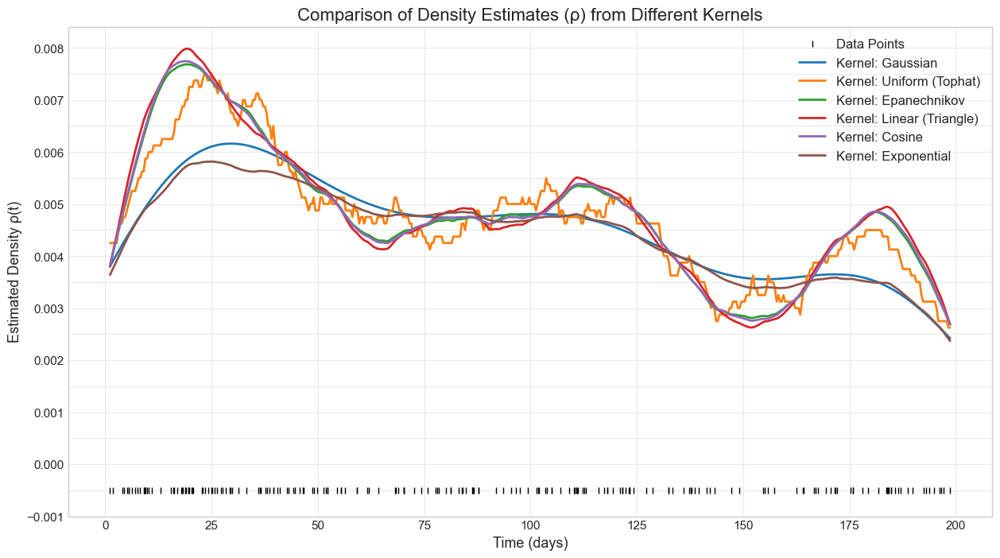

In [ ]:
from matplotlib.ticker import MultipleLocator
def visualize_kernel_density_curves():
    # 1. Generate the time stamps for Signal 14
    np.random.seed(2023)
    times = np.concatenate([np.sort(np.random.uniform(0, 50, 70)), np.sort(np.random.uniform(50, 150, 90)), np.sort(np.random.uniform(150, 200, 40))])
    
    # 2. Define the kernels to test
    kernels = ['gaussian', 'tophat', 'epanechnikov', 'linear', 'cosine', 'exponential']
    plot_titles = ['Gaussian', 'Uniform (Tophat)', 'Epanechnikov', 'Linear (Triangle)', 'Cosine', 'Exponential']

    # 3. Create the plot
    plt.figure(figsize=(15, 8))
    plt.title("Comparison of Density Estimates (ρ) from Different Kernels", fontsize=16)
    
    # Plot the actual data points as a reference
    plt.plot(times, np.zeros_like(times) - 0.0005, '|', color='k', label='Data Points')
    
    t_grid = np.linspace(times.min(), times.max(), 500)
    bandwidth = 20.0 # Use the same bandwidth as our NUST test

    # 4. Loop through kernels and plot each density curve
    for kernel, title in zip(kernels, plot_titles):
        density_func = estimate_density_sklearn(times, bandwidth=bandwidth, kernel=kernel)
        plt.plot(t_grid, density_func(t_grid), label=f'Kernel: {title}', lw=2)
        
    plt.xlabel("Time (days)")
    plt.ylabel("Estimated Density ρ(t)")
    plt.legend()
    ax = plt.gca()
    ax.yaxis.set_major_locator(MultipleLocator(0.001))    # ticks every 0.001
    ax.yaxis.set_minor_locator(MultipleLocator(0.0005))   # finer ticks
    plt.grid(True, which='both', alpha=0.4)               # grid for both
    plt.ylim(bottom=-0.001)
    plt.savefig("density_plot_varying_window_chirp.png", dpi=300, bbox_inches="tight")

    plt.show()

visualize_kernel_density_curves()

## SNR test for random uncontrolled sampling of multi-transient signal


Running analysis for SNR = 8.0...
Signal Variance: 0.2195
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running analysis for SNR = 2.5...
Signal Variance: 0.1879
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running analysis for SNR = 0.8...
Signal Variance: 0.2153
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


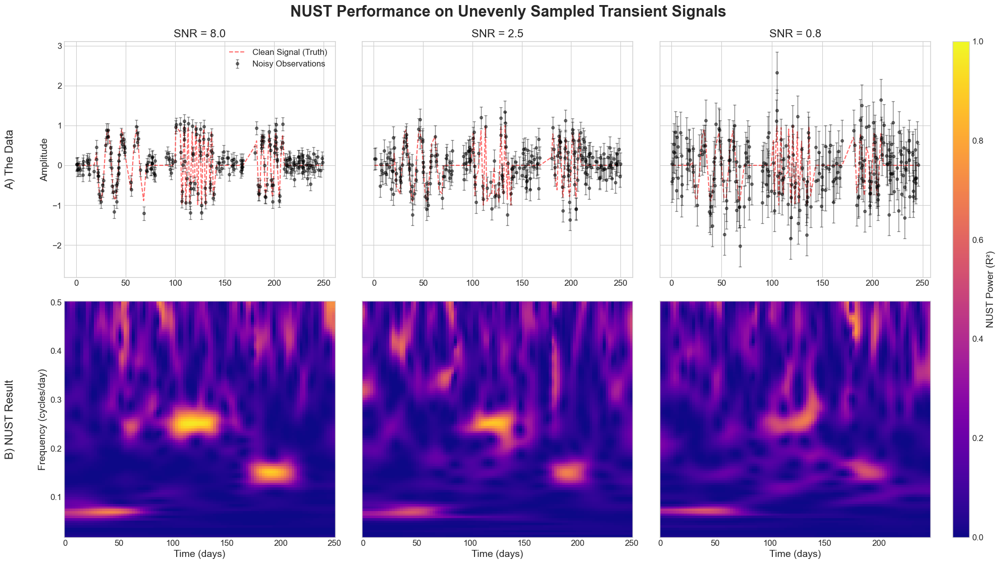

In [ ]:
def clean_signal_func_transient(times):
    signal_clean = np.zeros_like(times)
    freq1=0.07; mask1=(times > 20)&(times < 70)
    if np.any(mask1): signal_clean[mask1] = 0.9 * np.sin(2 * np.pi * freq1 * times[mask1])
    freq2=0.25; mask2=(times > 100)&(times < 140)
    if np.any(mask2): signal_clean[mask2] = 1.0 * np.sin(2 * np.pi * freq2 * times[mask2])
    freq3=0.15; mask3=(times > 180)&(times < 210)
    if np.any(mask3): signal_clean[mask3] = 0.8 * np.sin(2 * np.pi * freq3 * times[mask3])
    return signal_clean

def generate_transient_signal_snr(snr):
    # This function generates the uneven data needed for the plot
    times = np.array([])
    times = np.concatenate([times, np.sort(np.random.uniform(0, 80, 80))])
    times = np.concatenate([times, np.sort(np.random.uniform(90, 170, 80))])
    times = np.concatenate([times, np.sort(np.random.uniform(180, 250, 90))])
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_transient, snr)
    info = {'freqs': [0.07, 0.15, 0.25], 'snr': snr}
    return times, data, uncertainties, signal_clean, info

def create_final_publication_plot_2rows():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    # Create a 2x3 grid. Rows are Data/NUST, columns are SNR.
    fig, axes = plt.subplots(2, 3, figsize=(22, 12), sharey='row')
    fig.suptitle('NUST Performance on Unevenly Sampled Transient Signals', fontsize=22, fontweight='bold')

    nust_params = {'use_voronoi_weights': False, 'use_adaptive_window': True, 'alpha': 0.1, 'gamma': 0.5, 'kde_bandwidth': 20.0}
    freq_grid = np.linspace(0.02, 0.5, 100)
    im_nust = None

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning analysis for SNR = {snr}...")
        
        times, data, uncertainties, clean_signal, info = generate_transient_signal_snr(snr)
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)

        # --- Plotting for the current SNR column ---
        
        # Top Row: The Challenge Data
        ax_data = axes[0, i]
        ax_data.set_title(f"SNR = {snr}", fontsize=16)
        ax_data.plot(times, clean_signal, 'r--', alpha=0.6, lw=1.5, label='Clean Signal (Truth)')
        ax_data.errorbar(times, data, yerr=uncertainties, 
                         fmt='o', color='k', markersize=4, alpha=0.5,
                         elinewidth=1, capsize=2, label='Noisy Observations')
        
        # Bottom Row: The NUST Result
        ax_nust = axes[1, i]
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=1)
        

    # --- Final Formatting for a Compact, Professional Look ---
    axes[0, 0].set_ylabel("Amplitude", fontsize=14)
    axes[1, 0].set_ylabel("Frequency (cycles/day)", fontsize=14)
    
    # Set titles for the rows
    axes[0, 0].text(-0.2, 0.5, "A) The Data", transform=axes[0, 0].transAxes, 
                    ha="center", va="center", rotation=90, fontsize=16)
    axes[1, 0].text(-0.2, 0.5, "B) NUST Result", transform=axes[1, 0].transAxes, 
                    ha="center", va="center", rotation=90, fontsize=16)
    
    # Set labels only for the bottom row
    for ax in axes[1, :]:
        ax.set_xlabel("Time (days)", fontsize=14)
    
    axes[0, 0].legend(loc='upper right')
    
    # Adjust subplot spacing to be tight and add a shared colorbar
    fig.subplots_adjust(left=0.1, right=0.88, top=0.92, bottom=0.1, hspace=0.1, wspace=0.1)
    cbar_ax = fig.add_axes([0.9, 0.1, 0.015, 0.82])
    if im_nust: fig.colorbar(im_nust, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()
create_final_publication_plot_2rows()


Running analysis for SNR = 8.0...
Signal Variance: 0.2101
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running analysis for SNR = 2.5...
Signal Variance: 0.1807
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!

Running analysis for SNR = 0.8...
Signal Variance: 0.2417
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


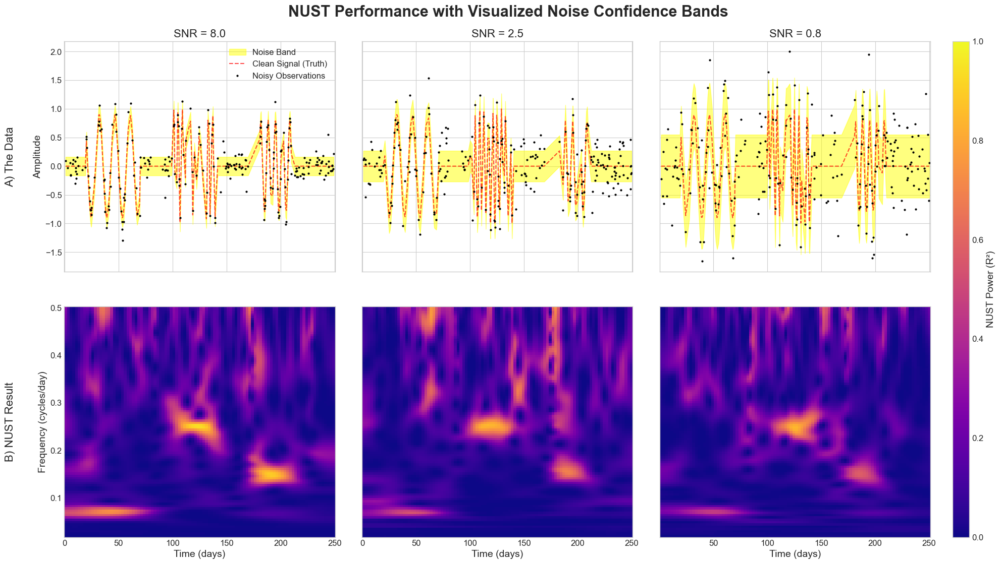

In [ ]:
def clean_signal_func_transient(times):
    signal_clean = np.zeros_like(times)
    freq1=0.07; mask1=(times > 20)&(times < 70)
    if np.any(mask1): signal_clean[mask1] = 0.9 * np.sin(2 * np.pi * freq1 * times[mask1])
    freq2=0.25; mask2=(times > 100)&(times < 140)
    if np.any(mask2): signal_clean[mask2] = 1.0 * np.sin(2 * np.pi * freq2 * times[mask2])
    freq3=0.15; mask3=(times > 180)&(times < 210)
    if np.any(mask3): signal_clean[mask3] = 0.8 * np.sin(2 * np.pi * freq3 * times[mask3])
    return signal_clean

def generate_transient_signal_snr(snr):
    times = np.array([])
    times = np.concatenate([times, np.sort(np.random.uniform(0, 80, 80))])
    times = np.concatenate([times, np.sort(np.random.uniform(90, 170, 80))])
    times = np.concatenate([times, np.sort(np.random.uniform(180, 250, 90))])
    data, uncertainties, signal_clean = generate_signal_with_snr(times, clean_signal_func_transient, snr)
    info = {'freqs': [0.07, 0.15, 0.25], 'snr': snr}
    return times, data, uncertainties, signal_clean, info

def create_confidence_band_plot():
    snr_levels = [8.0, 2.5, 0.8]  # High, Medium, Low
    
    
    fig, axes = plt.subplots(2, 3, figsize=(22, 12), sharey='row', sharex='col')
    fig.suptitle('NUST Performance with Visualized Noise Confidence Bands', fontsize=22, fontweight='bold')

    nust_params = {'use_voronoi_weights': False, 'use_adaptive_window': True, 'alpha': 0.1, 'gamma': 0.5, 'kde_bandwidth': 20.0}
    freq_grid = np.linspace(0.02, 0.5, 100)
    im_nust = None

    for i, snr in enumerate(snr_levels):
        print(f"\nRunning analysis for SNR = {snr}...")
        
        # --- Generate Data & Run NUST Analysis ---
        times, data, uncertainties, clean_signal, info = generate_transient_signal_snr(snr)
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        noise_std = uncertainties[0] # The uncertainty is the noise standard deviation

        
        # Top Row: The Challenge Data with Confidence Bands
        ax_data = axes[0, i]
        ax_data.set_title(f"SNR = {snr}", fontsize=16)
        # Create the shaded confidence band
        ax_data.fill_between(times, clean_signal - noise_std, clean_signal + noise_std, 
                             color='yellow', alpha=0.5, label='Noise Band')
        # Plot the true signal and noisy points on top
        ax_data.plot(times, clean_signal, 'r--', alpha=0.7, lw=1.5, label='Clean Signal (Truth)')
        ax_data.plot(times, data, 'k.', markersize=4, label='Noisy Observations')
        
        # Bottom Row: The NUST Result
        ax_nust = axes[1, i]
        im_nust = ax_nust.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=1)
        

    axes[0, 0].set_ylabel("Amplitude", fontsize=14)
    axes[1, 0].set_ylabel("Frequency (cycles/day)", fontsize=14)
    
    axes[0, 0].text(-0.2, 0.5, "A) The Data", transform=axes[0, 0].transAxes, 
                    ha="center", va="center", rotation=90, fontsize=16)
    axes[1, 0].text(-0.2, 0.5, "B) NUST Result", transform=axes[1, 0].transAxes, 
                    ha="center", va="center", rotation=90, fontsize=16)
    
    for ax in axes[1, :]:
        ax.set_xlabel("Time (days)", fontsize=14)
    
    axes[0, 0].legend(loc='upper right')
    
    fig.subplots_adjust(left=0.1, right=0.88, top=0.92, bottom=0.1, hspace=0.15, wspace=0.1)
    cbar_ax = fig.add_axes([0.9, 0.1, 0.015, 0.82])
    if im_nust: fig.colorbar(im_nust, cax=cbar_ax, label='NUST Power (R²)')
    
    plt.show()

create_confidence_band_plot()

## Robustness test for randomness with multiple runs

Running simulation 1 of 4...
Signal Variance: 0.0250
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!
Running simulation 2 of 4...
Signal Variance: 0.0168
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!
Running simulation 3 of 4...
Signal Variance: 0.0313
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!
Running simulation 4 of 4...
Signal Variance: 0.0222
Computing NUST (100τ x 100f = 10000 points)...
  Progress: 20%
  Progress: 40%
  Progress: 60%
  Progress: 80%
  Progress: 100%
NUST computation complete!


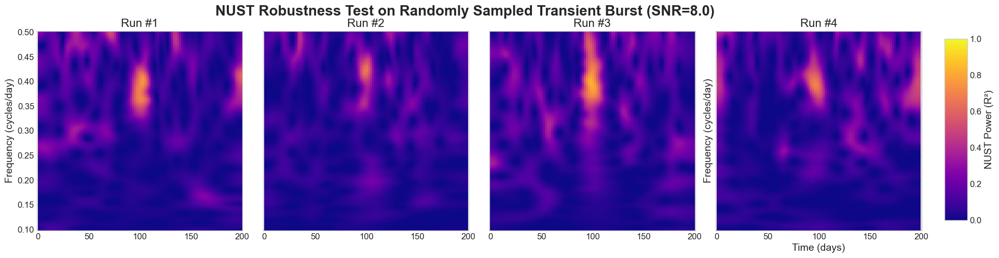

In [ ]:
def run_robustness_test_signal12():
    np.random.seed(2021)
    
    # --- 1. Signal Definition ---
    def clean_signal_func_12(times):
        """Generates the clean signal for the transient burst."""
        signal_clean = np.zeros_like(times)
        mask = (times > 95) & (times < 105)
        if np.any(mask):
            signal_clean[mask] = 1.0 * np.sin(2 * np.pi * 0.4 * times[mask])
        return signal_clean
    def generate_randomly_sampled_signal(snr):
        duration = 200.0
        num_points = 200 # Keep the total number of points the same as the even case
        
        times = np.sort(np.random.uniform(0, duration, num_points))
        
        data, uncertainties, clean_signal = generate_signal_with_snr(times, clean_signal_func_12, snr)
        return times, data, uncertainties, clean_signal

    num_runs = 4
    snr_for_test = 8.0 # A moderately high SNR for a clear signal

    fig, axes = plt.subplots(1, 4, figsize=(22, 5), sharex=True, sharey=True)
    fig.suptitle(f'NUST Robustness Test on Randomly Sampled Transient Burst (SNR={snr_for_test})', fontsize=20, fontweight='bold')

    nust_params = {'use_voronoi_weights': False, 'use_adaptive_window': True, 'alpha': 0.15, 'gamma': 0.5, 'kde_bandwidth': 8.0}
    freq_grid = np.linspace(0.1, 0.5, 100)
    im_nust = None

    # This loop runs the entire simulation 4 times
    for i in range(num_runs):
        print(f"Running simulation {i + 1} of {num_runs}...")
        
        # Each iteration generates a NEW random sampling
        times, data, uncertainties, _ = generate_randomly_sampled_signal(snr_for_test)
        
        # Run NUST on this new random sample
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        # Plot the result
        ax = axes.flat[i]
        ax.set_title(f"Run #{i + 1}", fontsize=16)
        im_nust = ax.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=1)
        
        
        if i % 3 == 0: # If it's the first plot in a row
            ax.set_ylabel("Frequency (cycles/day)")
        if i >= 3: # If it's a plot in the bottom row
            ax.set_xlabel("Time (days)")

    # --- Final Formatting ---
    fig.subplots_adjust(right=0.9, hspace=0.2, wspace=0.1)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    if im_nust: fig.colorbar(im_nust, cax=cbar_ax, label='NUST Power (R²)')
    plt.savefig("random_sampling_robustness_test.pdf", dpi=300, bbox_inches="tight")
    plt.show()

run_robustness_test_signal12()

## final signals for the paper

## signal representation

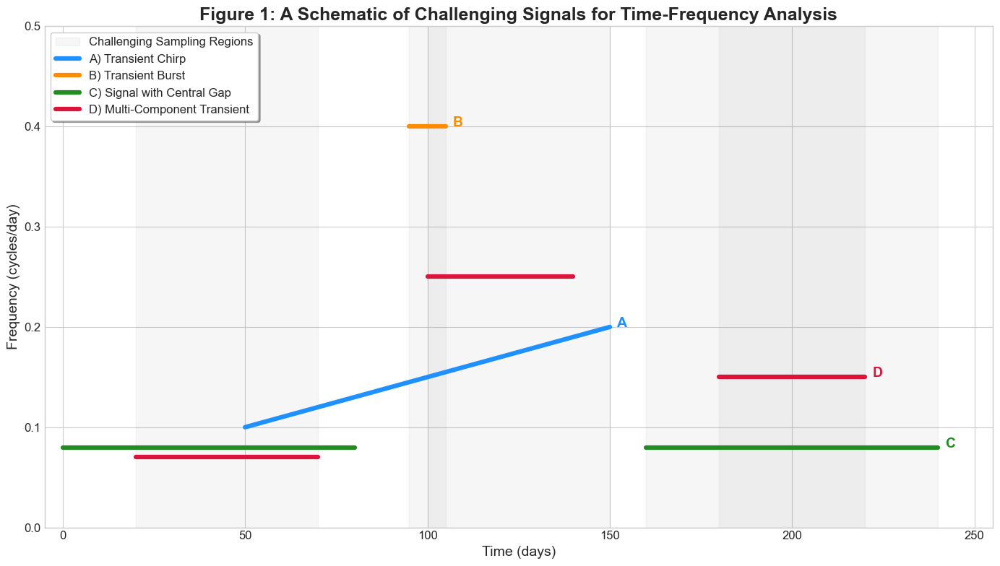

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def create_schematic_figure():
    plt.style.use('seaborn-v0_8-whitegrid')
    
    fig, ax = plt.subplots(figsize=(14, 8))
    
    # --- 1. Represent the Sampling Challenge ---
    # We use faint vertical bands to indicate the regions where signals are
    # present and where sampling is sparse/challenging.
    ax.axvspan(20, 70, color='gray', alpha=0.07, label='Challenging Sampling Regions')
    ax.axvspan(95, 105, color='gray', alpha=0.07)
    ax.axvspan(100, 150, color='gray', alpha=0.07)
    ax.axvspan(160, 240, color='gray', alpha=0.07)
    ax.axvspan(180, 220, color='gray', alpha=0.07)
    
    # --- 2. Plot the "Ground Truth" for each Signal Type ---
    
    # Signal A: Transient Chirp (Sloped Line)
    t_chirp = np.linspace(50, 150, 100)
    f_chirp = np.linspace(0.1, 0.2, 100)
    ax.plot(t_chirp, f_chirp, color='dodgerblue', lw=4.5, solid_capstyle='round', label='A) Transient Chirp')
    ax.text(152, 0.2, 'A', color='dodgerblue', fontsize=14, fontweight='bold')

    # Signal B: Transient Burst (Short, High-Frequency Line)
    t_burst = np.linspace(95, 105, 20)
    f_burst = np.full_like(t_burst, 0.4)
    ax.plot(t_burst, f_burst, color='darkorange', lw=4.5, solid_capstyle='round', label='B) Transient Burst')
    ax.text(107, 0.4, 'B', color='darkorange', fontsize=14, fontweight='bold')

    # Signal C: Signal with Central Gap (Two Disconnected Lines)
    t_gap1 = np.linspace(0, 80, 100)
    t_gap2 = np.linspace(160, 240, 100)
    f_gap = 0.08
    ax.plot(t_gap1, np.full_like(t_gap1, f_gap), color='forestgreen', lw=4.5, solid_capstyle='round', label='C) Signal with Central Gap')
    ax.plot(t_gap2, np.full_like(t_gap2, f_gap), color='forestgreen', lw=4.5, solid_capstyle='round')
    ax.text(242, f_gap, 'C', color='forestgreen', fontsize=14, fontweight='bold')

    # Signal D: Multi-Component Transient (Three Separate Lines)
    t_multi1 = np.linspace(20, 70, 50)
    f_multi1 = 0.07
    t_multi2 = np.linspace(100, 140, 50)
    f_multi2 = 0.25
    t_multi3 = np.linspace(180, 220, 50)
    f_multi3 = 0.15
    ax.plot(t_multi1, np.full_like(t_multi1, f_multi1), color='crimson', lw=4.5, solid_capstyle='round', label='D) Multi-Component Transient')
    ax.plot(t_multi2, np.full_like(t_multi2, f_multi2), color='crimson', lw=4.5, solid_capstyle='round')
    ax.plot(t_multi3, np.full_like(t_multi3, f_multi3), color='crimson', lw=4.5, solid_capstyle='round')
    ax.text(222, f_multi3, 'D', color='crimson', fontsize=14, fontweight='bold')

    # --- 3. Final Formatting ---
    ax.set_title('Figure 1: A Schematic of Challenging Signals for Time-Frequency Analysis', fontsize=18, fontweight='bold')
    ax.set_xlabel('Time (days)', fontsize=14)
    ax.set_ylabel('Frequency (cycles/day)', fontsize=14)
    ax.set_xlim(-5, 255)
    ax.set_ylim(0, 0.5)
    
    ax.legend(loc='upper left', fontsize=12, frameon=True, shadow=True)
    
    ax.tick_params(axis='both', which='major', labelsize=12)
    
    plt.tight_layout()
    plt.savefig("figure1_schematic.png", dpi=300) 
    plt.show()

if __name__ == '__main__':
    create_schematic_figure()


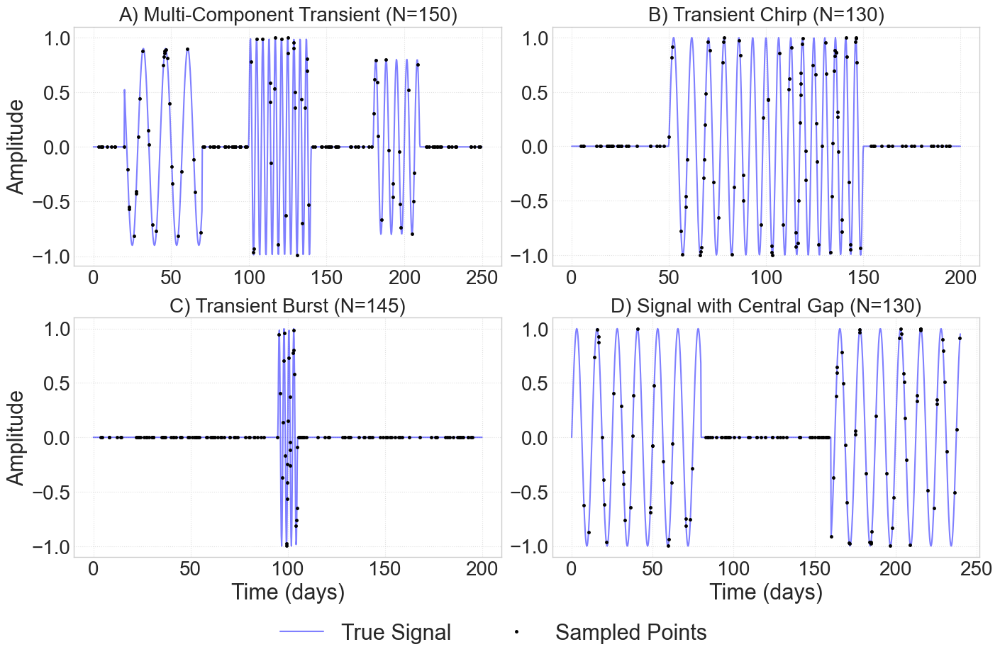

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

plt.style.use('seaborn-v0_8-whitegrid')
np.random.seed(2023)
def clean_signal_func_multi_transient(times):
    """Signal 1: Three separate transient sinusoids."""
    signal_clean = np.zeros_like(times)
    freq1=0.07; mask1=(times > 20)&(times < 70);
    if np.any(mask1): signal_clean[mask1] = 0.9 * np.sin(2*np.pi*freq1*times[mask1])
    freq2=0.25; mask2=(times > 100)&(times < 140);
    if np.any(mask2): signal_clean[mask2] = 1.0 * np.sin(2*np.pi*freq2*times[mask2])
    freq3=0.15; mask3=(times > 180)&(times < 210);
    if np.any(mask3): signal_clean[mask3] = 0.8 * np.sin(2*np.pi*freq3*times[mask3])
    return signal_clean

def clean_signal_func_chirp(times):
    """Signal 2: A transient signal with linearly increasing frequency."""
    signal_clean = np.zeros_like(times)
    mask = (times > 50) & (times < 150)
    if np.any(mask):
        t_chirp = times[mask]
        t_norm = (t_chirp - 50) / 100
        f_start, f_end = 0.1, 0.2
        phase = 2 * np.pi * (f_start * t_chirp + 0.5 * (f_end - f_start) * t_norm * (t_chirp - 50))
        signal_clean[mask] = 1.0 * np.sin(phase)
    return signal_clean

def clean_signal_func_burst(times):
    """Signal 3: A short, high-frequency transient burst."""
    signal_clean = np.zeros_like(times)
    mask = (times > 95) & (times < 105)
    if np.any(mask):
        signal_clean[mask] = 1.0 * np.sin(2 * np.pi * 0.4 * times[mask])
    return signal_clean

def clean_signal_func_gap(times):
    """Signal 4: A persistent signal with a large central gap."""
    signal_clean = np.zeros_like(times)
    freq = 0.08
    mask = (times < 80) | (times > 160)
    if np.any(mask):
        signal_clean[mask] = np.sin(2 * np.pi * freq * times[mask])
    return signal_clean


def create_introductory_signal_plot():
    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    #fig.suptitle('Four Challenging Signals for Time-Frequency Analysis', fontsize=20, fontweight='bold')
    
    # --- Panel A: Multi-Component Transient Signal ---
    ax1 = axes[0, 0]
    duration1, num_points1 = 250.0, 150
    times1 = np.sort(np.random.uniform(0, duration1, num_points1))
    clean_y1 = clean_signal_func_multi_transient(times1)
    t_dense1 = np.linspace(0, duration1, 1000)
    ax1.plot(t_dense1, clean_signal_func_multi_transient(t_dense1), 'b-', alpha=0.5, lw=1.5)
    ax1.plot(times1, clean_y1, 'k.', markersize=5)
    ax1.set_title(f'A) Multi-Component Transient (N={num_points1})', fontsize=20)

    # --- Panel B: Transient Chirp Signal ---
    ax2 = axes[0, 1]
    duration2, num_points2 = 200.0, 130
    times2 = np.sort(np.random.uniform(0, duration2, num_points2))
    clean_y2 = clean_signal_func_chirp(times2)
    t_dense2 = np.linspace(0, duration2, 1000)
    ax2.plot(t_dense2, clean_signal_func_chirp(t_dense2), 'b-', alpha=0.5, lw=1.5)
    ax2.plot(times2, clean_y2, 'k.', markersize=5)
    ax2.set_title(f'B) Transient Chirp (N={num_points2})', fontsize=20)

    # --- Panel C: Transient Burst Signal ---
    ax3 = axes[1, 0]
    duration3, num_points3 = 200.0, 150
    # Controlled sampling to ensure points fall within the burst
    points_in_burst = 26
    points_outside_burst = num_points3 - points_in_burst
    times3_burst = np.sort(np.random.uniform(95, 105, points_in_burst))
    times3_outside = np.sort(np.random.uniform(0, duration3, points_outside_burst))
    # Filter out points that accidentally fell in the burst window
    times3_outside = times3_outside[(times3_outside < 95) | (times3_outside > 105)]
    times3 = np.sort(np.concatenate([times3_burst, times3_outside]))
    
    clean_y3 = clean_signal_func_burst(times3)
    t_dense3 = np.linspace(0, duration3, 1000)
    ax3.plot(t_dense3, clean_signal_func_burst(t_dense3), 'b-', alpha=0.5, lw=1.5)
    ax3.plot(times3, clean_y3, 'k.', markersize=5)
    ax3.set_title(f'C) Transient Burst (N={len(times3)})', fontsize=20)
    
    # --- Panel D: Signal with Central Gap ---
    ax4 = axes[1, 1]
    duration4, num_points4 = 240.0, 130
    times4 = np.sort(np.random.uniform(0, duration4, num_points4))
    clean_y4 = clean_signal_func_gap(times4)
    t_dense4 = np.linspace(0, duration4, 1000)
    ax4.plot(t_dense4, clean_signal_func_gap(t_dense4), 'b-', alpha=0.5, lw=1.5, label='True Signal')
    ax4.plot(times4, clean_y4, 'k.', markersize=5, label='Sampled Points')
    ax4.set_title(f'D) Signal with Central Gap (N={num_points4})', fontsize=20)

    for i, ax in enumerate(axes.flat):
        if i % 2 == 0:
            ax.set_ylabel('Amplitude', fontsize=22)
        else:
            ax.set_ylabel('')
        

        if i // 2 == 1:
            ax.set_xlabel('Time (days)', fontsize=22)
        else:
            ax.set_xlabel('')
        
        ax.tick_params(axis='both', which='major', labelsize=20)
        ax.grid(True, linestyle=':', alpha=0.6)

    handles, labels = ax4.get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=2, bbox_to_anchor=(0.5, 0.01), fontsize=22)

    plt.tight_layout(rect=[0, 0.08, 1, 0.95], pad=1.0, w_pad=0.8, h_pad=1.0)
    plt.savefig("timseries42nn.pdf", dpi=300, bbox_inches="tight")
    plt.show()

if __name__ == '__main__':
    create_introductory_signal_plot()



## Comparision-S transform, GLS and NUST for the four signals

Processing ...
Processing ...
Processing ...
Processing ...


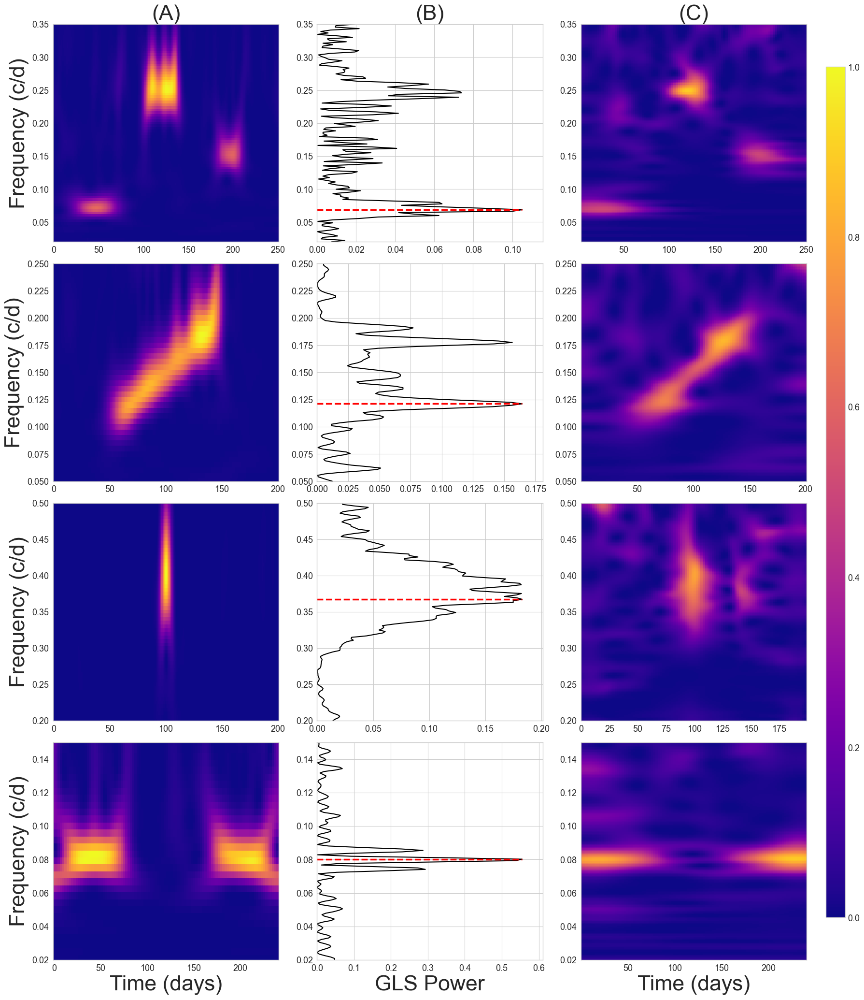

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
# Use the robust astropy LombScargle for a true GLS
from astropy.timeseries import LombScargle
from stockwell import st

plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams.update({
    'xtick.labelsize': 13, 'ytick.labelsize': 13,
    'axes.labelsize': 34, 'axes.titlesize': 32, 
    'legend.fontsize': 20
})
np.random.seed(2023)

def generate_signal_with_snr(times, clean_signal_func, snr):
    signal_clean = clean_signal_func(times)
    signal_variance = np.var(signal_clean)
    if signal_variance == 0: noise_std = 1.0 
    else: noise_std = np.sqrt(signal_variance / snr)
    noise = np.random.normal(0, noise_std, len(times))
    data = signal_clean + noise
    uncertainties = np.full_like(data, noise_std)
    return data, uncertainties, signal_clean

def estimate_sampling_density_kde(times, bandwidth=None):
    if len(times) < 2: return None, None
    n = len(times); std_dev = np.std(times)
    if bandwidth is None: bandwidth = 1.06 * std_dev * (n ** (-1/5))
    bw_method = bandwidth / std_dev if std_dev > 0 else 0.1
    kde = gaussian_kde(times, bw_method=bw_method)
    return kde, bandwidth

def adaptive_window_std(tau, frequency, kde, alpha=1.0, gamma=0.5):
    if frequency <= 0 or kde is None: return np.inf
    sigma_base = alpha / abs(frequency)
    if gamma == 0: return sigma_base
    local_density = max(kde(tau)[0], 1e-10)
    sigma_adaptive = sigma_base * (local_density ** (-gamma))
    return sigma_adaptive

def nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params):
    N_tau, N_freq = len(tau_grid), len(freq_grid); nust_result = np.zeros((N_tau, N_freq))
    measurement_weights = 1.0 / uncertainties**2
    use_voronoi = nust_params.get('use_voronoi_weights', False); use_adaptive = nust_params.get('use_adaptive_window', True)
    alpha = nust_params.get('alpha', 1.0); gamma = nust_params.get('gamma', 0.5); kde_bandwidth = nust_params.get('kde_bandwidth', None)
    voronoi_weights = compute_voronoi_weights_1d(times) if use_voronoi else np.ones_like(times)
    kde = None
    if use_adaptive: kde, _ = estimate_sampling_density_kde(times, bandwidth=kde_bandwidth)
    for i, tau in enumerate(tau_grid):
        for j, freq in enumerate(freq_grid):
            if freq <= 0: continue
            sigma_t = adaptive_window_std(tau, freq, kde, alpha, gamma) if use_adaptive and kde else alpha / abs(freq)
            gaussian_weights = np.exp(-0.5 * ((times - tau) / sigma_t)**2)
            total_weights = measurement_weights * voronoi_weights * gaussian_weights
            significant_mask = gaussian_weights > 0.001
            if np.sum(significant_mask) < 5: continue
            t_local, y_local, w_local = times[significant_mask], data[significant_mask], total_weights[significant_mask]
            omega = 2 * np.pi * freq
            try:
                A = np.vstack([np.cos(omega*t_local), np.sin(omega*t_local), np.ones_like(t_local)]).T
                W = np.diag(w_local)
                theta = np.linalg.solve(A.T @ W @ A, A.T @ W @ y_local)
                y_pred = A @ theta; ss_res = np.sum(w_local * (y_local - y_pred)**2)
                y_mean_weighted = np.sum(w_local * y_local) / np.sum(w_local)
                ss_tot = np.sum(w_local * (y_local - y_mean_weighted)**2)
                if ss_tot > 0: nust_result[i, j] = max(0, 1 - (ss_res / ss_tot))
            except (np.linalg.LinAlgError, ValueError): continue
    return nust_result


# --- 3. SIGNAL-SPECIFIC GENERATION FUNCTIONS ---

# Signal 1: Multi-Component Transient
def clean_signal_func_multi_transient(times):
    s = np.zeros_like(times); f1=0.07; m1=(times > 20)&(times < 70);
    if np.any(m1): s[m1] = 0.9*np.sin(2*np.pi*f1*times[m1])
    f2=0.25; m2=(times > 100)&(times < 140);
    if np.any(m2): s[m2] = 1.0*np.sin(2*np.pi*f2*times[m2])
    f3=0.15; m3=(times > 180)&(times < 210);
    if np.any(m3): s[m3] = 0.8*np.sin(2*np.pi*f3*times[m3])
    return s
def generate_1_even(snr):
    d, n = 250.0, 180; t = np.linspace(0, d, n); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_multi_transient, snr); return t, dt, n/d
def generate_1_uneven(snr):
    d, n = 250.0, 180; t = np.sort(np.random.uniform(0, d, n)); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_multi_transient, snr); return t, dt, ut

# Signal 2: Transient Chirp
def clean_signal_func_chirp(times):
    s = np.zeros_like(times); m = (times > 50)&(times < 150)
    if np.any(m):
        t_c = times[m]; t_n = (t_c - 50)/100; f_s, f_e = 0.1, 0.2
        p = 2*np.pi*(f_s*t_c + 0.5*(f_e - f_s)*t_n*(t_c - 50)); s[m] = 1.0*np.sin(p)
    return s
def generate_2_even(snr):
    d, n = 200.0, 150; t = np.linspace(0, d, n); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_chirp, snr); return t, dt, n/d
def generate_2_uneven(snr):
    d, n = 200.0, 150; t = np.sort(np.random.uniform(0, d, n)); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_chirp, snr); return t, dt, ut

# Signal 3: Transient Burst (Controlled Sampling)
def clean_signal_func_burst(times):
    s = np.zeros_like(times); m = (times > 95)&(times < 105)
    if np.any(m): s[m] = 1.0*np.sin(2*np.pi*0.4*times[m])
    return s
def generate_3_even(snr):
    d, n = 200.0, 200; t = np.linspace(0, d, n); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_burst, snr); return t, dt, n/d
def generate_3_uneven(snr):
    d, n = 200.0, 150; n_b = 26; n_o = n - n_b
    t_b = np.sort(np.random.uniform(95, 105, n_b))
    t_o = np.sort(np.random.uniform(0, d, n_o)); t_o = t_o[(t_o < 95)|(t_o > 105)]
    t = np.sort(np.concatenate([t_b, t_o])); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_burst, snr); return t, dt, ut

# Signal 4: Signal with Central Gap
def clean_signal_func_gap(times):
    s = np.zeros_like(times); f = 0.08; m = (times < 80)|(times > 160)
    if np.any(m): s[m] = np.sin(2*np.pi*f*times[m])
    return s
def generate_4_even(snr):
    d, n = 240.0, 100; t = np.linspace(0, d, n); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_gap, snr); return t, dt, n/d
def generate_4_uneven(snr):
    d, n = 240.0, 100; t = np.sort(np.random.uniform(0, d, n)); dt, ut, _ = generate_signal_with_snr(t, clean_signal_func_gap, snr); return t, dt, ut


def create_all_comparisons(signal_definitions, fixed_snr=10.0):
    """
    Creates a single, compact 4x3 figure for all signal comparisons.
    """
    fig, axes = plt.subplots(4, 3, figsize=(20, 22))
    #fig.suptitle('Comparison of S-Transform, GLS, and NUST for Challenging Signals', fontsize=22, fontweight='bold')
    im_nust = None

    for i, sig_def in enumerate(signal_definitions):
        print(f"Processing {sig_def['name']}...")
        # --- Generate Data ---
        times_even, data_even, fs = sig_def['even_gen'](fixed_snr)
        times_uneven, data_uneven, uncertainties_uneven = sig_def['uneven_gen'](fixed_snr)
        
        # --- Run Analyses ---
        st_result = st.st(data_even); st_power = np.abs(st_result)**2; st_power_norm = st_power / np.max(st_power)
        ls = LombScargle(times_uneven, data_uneven, dy=uncertainties_uneven); ls_power = ls.power(sig_def['freq_grid'])
        tau_grid = np.linspace(times_uneven.min(), times_uneven.max(), 100)
        nust_power = nust(times_uneven, data_uneven, uncertainties_uneven, tau_grid, sig_def['freq_grid'], **sig_def['nust_params'])

        # --- Plotting ---
        # S-Transform
        ax_st = axes[i, 0]
        st_freq_axis = np.linspace(0, fs / 2, st_power_norm.shape[0])
        ax_st.pcolormesh(times_even, st_freq_axis, st_power_norm, cmap='plasma', vmin=0, vmax=1)
        ax_st.set_ylim(sig_def['freq_grid'].min(), sig_def['freq_grid'].max())
        
        # GLS
        ax_ls = axes[i, 1]
        ax_ls.plot(ls_power, sig_def['freq_grid'], 'k-')
        ax_ls.set_xlim(0, max(0.1, np.max(ls_power) * 1.1))
        # peak_idx = np.argmax(ls_power)
        # peak_freq = sig_def['freq_grid'][peak_idx]
        # xlim = ax_ls.get_xlim()
        # ax_ls.annotate('', xy=(xlim[0], peak_freq), xytext=(xlim[0] - (xlim[1] - xlim[0]) * 0.05, peak_freq),
        #        arrowprops=dict(arrowstyle='->', color='red', lw=2))

        peak_idx = np.argmax(ls_power)
        peak_freq = sig_def['freq_grid'][peak_idx]
        peak_power = ls_power[peak_idx]
        ax_ls.plot([0, peak_power], [peak_freq, peak_freq],
                   linestyle='--', color='red', linewidth=2.5)
        
        #ax_ls.plot(peak_power, peak_freq, 'ro')

        # ax_ls.annotate('', xy=(peak_power, peak_freq), xytext=(peak_power * 0.7, peak_freq),
        #        arrowprops=dict(arrowstyle='->', color='red', lw=2))
        
        # NUST
        ax_nust = axes[i, 2]
        im_nust = ax_nust.pcolormesh(tau_grid, sig_def['freq_grid'], nust_power.T, cmap='plasma', vmin=0, vmax=1)
        for ax in axes.flat:
            ax.tick_params(axis='x', pad=6)  # move x-tick labels down
            ax.tick_params(axis='y', pad=6)  # move y-tick labels left

        # Formatting for the row
        ax_st.set_ylabel('Frequency (c/d)', fontsize = 32); ax_ls.sharey(ax_st); ax_nust.sharey(ax_st)
        ax_st.text(-0.25, 0.5, sig_def['name'], transform=ax_st.transAxes, ha="center", va="center", rotation=90, fontsize=18)

    # --- Final Global Formatting ---
    axes[0, 0].set_title('(A)'); axes[0, 1].set_title('(B)'); axes[0, 2].set_title('(C)')
    for ax in axes[-1,:]: ax.set_xlabel("Time (days)", fontsize=32)
    axes[-1, 1].set_xlabel("GLS Power", fontsize=32)

    fig.subplots_adjust(left=0.1, right=0.88, top=0.94, bottom=0.06, hspace=0.1, wspace=0.17)
    #fig.subplots_adjust(left=0.08, right=0.9, top=0.95, bottom=0.05, hspace=0.1, wspace=0.1)
    cbar_ax = fig.add_axes([0.9, 0.1, 0.02, 0.8])
    if im_nust is not None: fig.colorbar(im_nust, cax=cbar_ax)
    plt.savefig("all_foursigtestnnnn.png", dpi=600, bbox_inches="tight")
    plt.show()

# --- 5. EXECUTION BLOCK ---
if __name__ == '__main__':
    
    # Define the unique parameters for each signal analysis
    SIGNAL_DEFINITIONS = [
        {
            "name": "", "even_gen": generate_1_even, "uneven_gen": generate_1_uneven,
            "freq_grid": np.linspace(0.02, 0.35, 150),
            "nust_params": {'alpha': 0.18, 'gamma': 0.5, 'kde_bandwidth': 20.0}
        },
        {
            "name": "", "even_gen": generate_2_even, "uneven_gen": generate_2_uneven,
            "freq_grid": np.linspace(0.05, 0.25, 150),
            "nust_params": {'alpha': 0.25, 'gamma': 0.4, 'kde_bandwidth': 20.0}
        },
        {
            "name": "", "even_gen": generate_3_even, "uneven_gen": generate_3_uneven,
            "freq_grid": np.linspace(0.2, 0.5, 150),
            "nust_params": {'alpha': 0.1, 'gamma': 0.7, 'kde_bandwidth': 8.0}
        },
        {
            "name": "", "even_gen": generate_4_even, "uneven_gen": generate_4_uneven,
            "freq_grid": np.linspace(0.02, 0.15, 150),
            "nust_params": {'alpha': 0.18, 'gamma': 0.5, 'kde_bandwidth': 20.0}
        }
    ]
    
    create_all_comparisons(SIGNAL_DEFINITIONS)



## SNR test for multi-transient signal

Running simulation for SNR = 8.0...
Running simulation for SNR = 2.5...
Running simulation for SNR = 0.8...


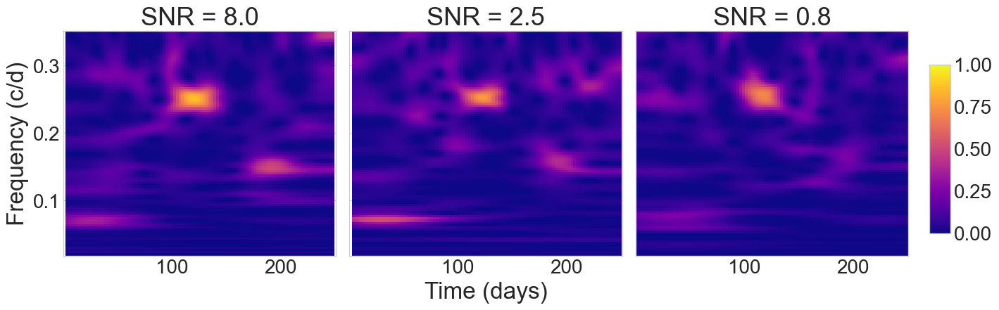

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams.update({
    'xtick.labelsize': 20, 'ytick.labelsize': 20,
    'axes.labelsize': 22, 'axes.titlesize': 22,
})
np.random.seed(2023)

def generate_signal_with_snr(times, clean_signal_func, snr):
    signal_clean = clean_signal_func(times)
    signal_variance = np.var(signal_clean)
    if signal_variance == 0: noise_std = 1.0 
    else: noise_std = np.sqrt(signal_variance / snr)
    noise = np.random.normal(0, noise_std, len(times))
    data = signal_clean + noise
    uncertainties = np.full_like(data, noise_std)
    return data, uncertainties, signal_clean

def compute_voronoi_weights_1d(times):
    if len(times) < 2: return np.ones_like(times)
    sorted_indices = np.argsort(times); sorted_times = times[sorted_indices]
    midpoints = (sorted_times[1:] + sorted_times[:-1]) / 2.0
    start_bound = sorted_times[0] - (midpoints[0] - sorted_times[0]); end_bound = sorted_times[-1] + (sorted_times[-1] - midpoints[-1])
    bounds = np.concatenate(([start_bound], midpoints, [end_bound])); voronoi_lengths = np.diff(bounds)
    original_order_lengths = np.zeros_like(voronoi_lengths); original_order_lengths[sorted_indices] = voronoi_lengths
    return original_order_lengths

def estimate_sampling_density_kde(times, bandwidth=None):
    if len(times) < 2: return None, None
    n = len(times); std_dev = np.std(times)
    if bandwidth is None: bandwidth = 1.06 * std_dev * (n ** (-1/5))
    bw_method = bandwidth / std_dev if std_dev > 0 else 0.1
    kde = gaussian_kde(times, bw_method=bw_method)
    return kde, bandwidth

def adaptive_window_std(tau, frequency, kde, alpha=1.0, gamma=0.5):
    if frequency <= 0 or kde is None: return np.inf
    sigma_base = alpha / abs(frequency)
    if gamma == 0: return sigma_base
    local_density = max(kde(tau)[0], 1e-10)
    sigma_adaptive = sigma_base * (local_density ** (-gamma))
    return sigma_adaptive

def nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params):
    N_tau, N_freq = len(tau_grid), len(freq_grid); nust_result = np.zeros((N_tau, N_freq))
    measurement_weights = 1.0 / uncertainties**2
    use_voronoi = nust_params.get('use_voronoi_weights', True); use_adaptive = nust_params.get('use_adaptive_window', True)
    alpha = nust_params.get('alpha', 1.0); gamma = nust_params.get('gamma', 0.5); kde_bandwidth = nust_params.get('kde_bandwidth', None)
    voronoi_weights = compute_voronoi_weights_1d(times) if use_voronoi else np.ones_like(times)
    kde = None
    if use_adaptive: kde, _ = estimate_sampling_density_kde(times, bandwidth=kde_bandwidth)
    for i, tau in enumerate(tau_grid):
        for j, freq in enumerate(freq_grid):
            if freq <= 0: continue
            sigma_t = adaptive_window_std(tau, freq, kde, alpha, gamma) if use_adaptive and kde else alpha / abs(freq)
            gaussian_weights = np.exp(-0.5 * ((times - tau) / sigma_t)**2)
            total_weights = measurement_weights * voronoi_weights * gaussian_weights
            significant_mask = gaussian_weights > 0.001
            if np.sum(significant_mask) < 5: continue
            t_local, y_local, w_local = times[significant_mask], data[significant_mask], total_weights[significant_mask]
            omega = 2 * np.pi * freq
            try:
                A = np.vstack([np.cos(omega*t_local), np.sin(omega*t_local), np.ones_like(t_local)]).T
                W = np.diag(w_local)
                theta = np.linalg.solve(A.T @ W @ A, A.T @ W @ y_local)
                y_pred = A @ theta; ss_res = np.sum(w_local * (y_local - y_pred)**2)
                y_mean_weighted = np.sum(w_local * y_local) / np.sum(w_local)
                ss_tot = np.sum(w_local * (y_local - y_mean_weighted)**2)
                if ss_tot > 0: nust_result[i, j] = max(0, 1 - (ss_res / ss_tot))
            except (np.linalg.LinAlgError, ValueError): continue
    return nust_result

def run_snr_robustness_test_multi_transient():
    """
    Performs a robustness test for the multi-transient signal across four
    different SNR levels, plotting the NUST results in a compact 2x2 grid.
    """
    # --- A. Signal Definition and Generator ---
    def clean_signal_func_multi_transient(times):
        s = np.zeros_like(times); f1=0.07; m1=(times > 20)&(times < 70);
        if np.any(m1): s[m1] = 0.9*np.sin(2*np.pi*f1*times[m1])
        f2=0.25; m2=(times > 100)&(times < 140);
        if np.any(m2): s[m2] = 1.0*np.sin(2*np.pi*f2*times[m2])
        f3=0.15; m3=(times > 180)&(times < 210);
        if np.any(m3): s[m3] = 0.8*np.sin(2*np.pi*f3*times[m3])
        return s
        
    def generate_randomly_sampled_signal(snr):
        """Generates the signal with purely random sampling."""
        duration = 250.0; num_points = 180 # As requested
        times = np.sort(np.random.uniform(0, duration, num_points))
        data, uncertainties, _ = generate_signal_with_snr(times, clean_signal_func_multi_transient, snr)
        return times, data, uncertainties

    # --- B. Analysis and Plotting ---
    snr_levels = [8.0, 2.5, 0.8]
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 4), sharex=True, sharey=True)
    #fig.suptitle('NUST Robustness to SNR for a Randomly Sampled Multi-Transient Signal', fontsize=22, fontweight='bold')

    nust_params = {'use_voronoi_weights': False, 'use_adaptive_window': True, 'alpha': 0.1, 'gamma': 0.6, 'kde_bandwidth': 20.0}
    freq_grid = np.linspace(0.02, 0.35, 100)
    im_nust = None
    true_freqs = [0.07, 0.15, 0.25]

    for i, snr in enumerate(snr_levels):
        print(f"Running simulation for SNR = {snr}...")
        
        times, data, uncertainties = generate_randomly_sampled_signal(snr)
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        ax = axes.flat[i]
        ax.set_title(f"SNR = {snr}", fontsize=26)
        im_nust = ax.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=1)
        
        if i == 0: # If it's the first plot in a row (0 or 2)
            ax.set_ylabel("Frequency (c/d)", fontsize=24)
        if i == 1: # If it's a plot in the bottom row (2 or 3)
            ax.set_xlabel("Time (days)", fontsize=24)


    fig.subplots_adjust(left=0.08, right=0.88, top=0.92, bottom=0.12, wspace=0.05)
    cbar_ax = fig.add_axes([0.9, 0.2, 0.02, 0.6])
    if im_nust: fig.colorbar(im_nust, cax=cbar_ax)
    plt.savefig("SNRtestnew.png", dpi=300, bbox_inches="tight")
    plt.show()


run_snr_robustness_test_multi_transient()


## Gaussian Window widths dependency test on hyperparameters

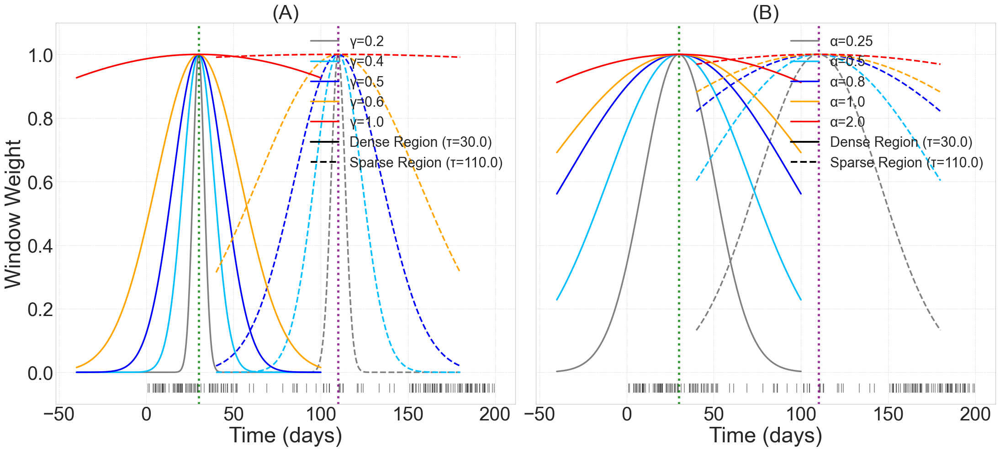

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

# --- 1. PLOTTING STYLE AND REPRODUCIBILITY ---
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams.update({
    'xtick.labelsize': 30, 'ytick.labelsize': 30,
    'axes.labelsize': 34, 'axes.titlesize': 34,
    'legend.fontsize': 22
})
np.random.seed(2023)

# --- 2. HELPER FUNCTIONS ---
def estimate_sampling_density_kde(times, bandwidth=None):
    if len(times) < 2: return None, None
    n = len(times); std_dev = np.std(times)
    if bandwidth is None: bandwidth = 1.06 * std_dev * (n ** (-1/5))
    bw_method = bandwidth / std_dev if std_dev > 0 else 0.1
    kde = gaussian_kde(times, bw_method=bw_method)
    return kde, bandwidth

def adaptive_window_std(tau, frequency, kde, alpha=1.0, gamma=0.5):
    if frequency <= 0 or kde is None: return np.inf
    sigma_base = alpha / abs(frequency)
    if gamma == 0: return sigma_base
    local_density = max(kde(tau)[0], 1e-10)
    return sigma_base * (local_density ** (-gamma))

# --- 3. MAIN PLOTTING FUNCTION ---
def create_hyperparameter_mechanism_plot():
    # Generate synthetic sampling
    times = np.concatenate([
        np.sort(np.random.uniform(0, 50, 70)),    # Dense
        np.sort(np.random.uniform(50, 150, 30)),  # Sparse
        np.sort(np.random.uniform(150, 200, 70))  # Dense
    ])
    
    tau_dense, tau_sparse, test_freq = 30.0, 110.0, 0.15
    time_axis = np.linspace(-70, 70, 500)
    colors = ['gray', 'deepskyblue', 'blue', 'orange', 'red']

    # --- Create a 1x2 figure ---
    fig, axes = plt.subplots(1, 2, figsize=(22, 10), sharey=True)

    # --- Panel A: Effect of gamma ---
    ax1 = axes[0]
    ax1.set_title('(A)', fontsize=32)
    fixed_alpha, fixed_h = 0.18, 20.0
    kde_A, _ = estimate_sampling_density_kde(times, bandwidth=fixed_h)
    gamma_values = [0.2, 0.4, 0.5, 0.6, 1.0, 2.0]
    for g, c in zip(gamma_values, colors):
        sigma_d = adaptive_window_std(tau_dense, test_freq, kde_A, fixed_alpha, g)
        sigma_s = adaptive_window_std(tau_sparse, test_freq, kde_A, fixed_alpha, g)
        ax1.plot(tau_dense + time_axis, np.exp(-0.5*(time_axis/sigma_d)**2),
                 color=c, lw=2.5, label=f'γ={g}')
        ax1.plot(tau_sparse + time_axis, np.exp(-0.5*(time_axis/sigma_s)**2),
                 color=c, lw=2.5, ls='--')

    # --- Panel B: Effect of alpha ---
    ax2 = axes[1]
    ax2.set_title('(B)', fontsize=32)
    fixed_gamma, fixed_h = 0.5, 20.0
    kde_B, _ = estimate_sampling_density_kde(times, bandwidth=fixed_h)
    alpha_values = [0.25, 0.5, 0.8, 1.0, 2.0, 5.0]
    for a, c in zip(alpha_values, colors):
        sigma_d = adaptive_window_std(tau_dense, test_freq, kde_B, a, fixed_gamma)
        sigma_s = adaptive_window_std(tau_sparse, test_freq, kde_B, a, fixed_gamma)
        ax2.plot(tau_dense + time_axis, np.exp(-0.5*(time_axis/sigma_d)**2),
                 color=c, lw=2.5, label=f'α={a}')
        ax2.plot(tau_sparse + time_axis, np.exp(-0.5*(time_axis/sigma_s)**2),
                 color=c, lw=2.5, ls='--')

    from matplotlib.lines import Line2D
    for ax in axes:
        ax.plot(times, np.zeros_like(times)-0.05, '|', color='k', markersize=15,
                markeredgewidth=1.5, alpha=0.4)
        ax.axvline(tau_dense, color='green', lw=3.5, ls=':', alpha=0.8)
        ax.axvline(tau_sparse, color='purple', lw=3.5, ls=':', alpha=0.8)
        ax.set_ylim(-0.1, 1.1)
        ax.grid(True, linestyle=':')

        handles, labels = ax.get_legend_handles_labels()
        solid_line = Line2D([0], [0], color='black', lw=2.8, ls='-',
                            label=f'Dense Region (τ={tau_dense})')
        dashed_line = Line2D([0], [0], color='black', lw=2.8, ls='--',
                             label=f'Sparse Region (τ={tau_sparse})')
        handles.extend([solid_line, dashed_line])
        ax.legend(handles=handles, loc='upper right')

    axes[0].set_ylabel('Window Weight', fontsize=34)
    for ax in axes: ax.set_xlabel('Time (days)', fontsize=34)

    plt.tight_layout()
    plt.savefig("hyperparameter_mechanism_ABnn.pdf", dpi=300, bbox_inches="tight")
    plt.show()
if __name__ == '__main__':
    create_hyperparameter_mechanism_plot()


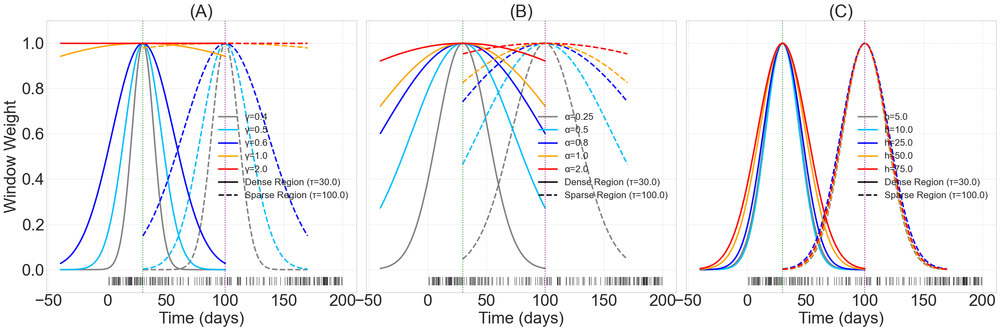

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams.update({
    'xtick.labelsize': 28, 'ytick.labelsize': 28,
    'axes.labelsize': 28, 'axes.titlesize': 30,
    'figure.titlesize': 30, 'legend.fontsize': 16
})
np.random.seed(2023)


def estimate_sampling_density_kde(times, bandwidth=None):
    """Estimates sampling density using Kernel Density Estimation."""
    if len(times) < 2: return None, None
    n = len(times); std_dev = np.std(times)
    if bandwidth is None: bandwidth = 1.06 * std_dev * (n ** (-1/5))
    bw_method = bandwidth / std_dev if std_dev > 0 else 0.1
    kde = gaussian_kde(times, bw_method=bw_method)
    return kde, bandwidth

def adaptive_window_std(tau, frequency, kde, alpha=1.0, gamma=0.5):
    """Calculates the doubly adaptive window size sigma."""
    if frequency <= 0 or kde is None: return np.inf
    sigma_base = alpha / abs(frequency)
    if gamma == 0: return sigma_base
    local_density = max(kde(tau)[0], 1e-10)
    sigma_adaptive = sigma_base * (local_density ** (-gamma))
    return sigma_adaptive


def create_hyperparameter_mechanism_plot():
    # --- A. Generate a signal sampling with a clear sparse/dense pattern ---
    times = np.concatenate([
        np.sort(np.random.uniform(0, 50, 70)),   # Dense region
        np.sort(np.random.uniform(50, 150, 60)),  # Sparse/Mid-dense region
        np.sort(np.random.uniform(150, 200, 70)) # Dense region
    ])
    
    # Define fixed points and parameters for the demonstration
    tau_dense = 30.0    # A point in the first dense region
    tau_sparse = 100.0   # A point in the central sparse region
    test_freq = 0.15    # A representative frequency
    
    # --- B. Create the 1x3 plot ---
    fig, axes = plt.subplots(1, 3, figsize=(24, 8), sharey=True)
    ax1 = axes[0]
    ax1.set_title('(A)')
    fixed_alpha_A = 0.18; fixed_h_A = 20.0
    kde_A, _ = estimate_sampling_density_kde(times, bandwidth=fixed_h_A)
    gamma_values = [0.4, 0.5, 0.6, 1.0, 2.0]
    colors = ['gray', 'deepskyblue', 'blue', 'orange', 'red']
    time_axis = np.linspace(-70, 70, 500)
    for g, c, in zip(gamma_values, colors):
        # Dense region window
        sigma_d = adaptive_window_std(tau_dense, test_freq, kde_A, fixed_alpha_A, g)
        win_d = np.exp(-0.5 * (time_axis / sigma_d)**2)
        ax1.plot(tau_dense + time_axis, win_d, color=c, lw=2.5, label=f'γ={g}')
        # Sparse region window
        sigma_s = adaptive_window_std(tau_sparse, test_freq, kde_A, fixed_alpha_A, g)
        win_s = np.exp(-0.5 * (time_axis / sigma_s)**2)
        ax1.plot(tau_sparse + time_axis, win_s, color=c, lw=2.5, ls='--')

    ax2 = axes[1]
    ax2.set_title('(B)')
    fixed_gamma_B = 0.5; fixed_h_B = 20.0
    kde_B, _ = estimate_sampling_density_kde(times, bandwidth=fixed_h_B)
    alpha_values = [0.25, 0.5, 0.8, 1.0, 2.0]
    for a, c in zip(alpha_values, colors):
        sigma_d = adaptive_window_std(tau_dense, test_freq, kde_B, a, fixed_gamma_B)
        win_d = np.exp(-0.5 * (time_axis / sigma_d)**2)
        ax2.plot(tau_dense + time_axis, win_d, color=c, lw=2.5, label=f'α={a}')
        sigma_s = adaptive_window_std(tau_sparse, test_freq, kde_B, a, fixed_gamma_B)
        win_s = np.exp(-0.5 * (time_axis / sigma_s)**2)
        ax2.plot(tau_sparse + time_axis, win_s, color=c, lw=2.5, ls='--')

    ax3 = axes[2]
    ax3.set_title('(C)')
    fixed_gamma_C = 0.5; fixed_alpha_C = 0.18
    
    h_values = [5.0, 10.0, 25.0, 50.0, 75.0]
    for h, c in zip(h_values, colors):
        kde_C, _ = estimate_sampling_density_kde(times, bandwidth=h)
        sigma_d = adaptive_window_std(tau_dense, test_freq, kde_C, fixed_alpha_C, fixed_gamma_C)
        win_d = np.exp(-0.5 * (time_axis / sigma_d)**2)
        ax3.plot(tau_dense + time_axis, win_d, color=c, lw=2.5, label=f'h={h:.1f}')
        sigma_s = adaptive_window_std(tau_sparse, test_freq, kde_C, fixed_alpha_C, fixed_gamma_C)
        win_s = np.exp(-0.5 * (time_axis / sigma_s)**2)
        ax3.plot(tau_sparse + time_axis, win_s, color=c, lw=2.5, ls='--')

    from matplotlib.lines import Line2D
    for ax in axes:
        ax.plot(times, np.zeros_like(times) - 0.05, '|', color='k', markersize=15, markeredgewidth=1.5, alpha=0.4)
        ax.axvline(tau_dense, color='green', ls=':', alpha=0.8)
        ax.axvline(tau_sparse, color='purple', ls=':', alpha=0.8)
        ax.set_xlabel('Time (days)')
        ax.set_ylim(-0.1, 1.1)
        ax.grid(True, linestyle=':')
        
        handles, labels = ax.get_legend_handles_labels()
        solid_line = Line2D([0], [0], color='black', lw=2.5, linestyle='-', label=f'Dense Region (τ={tau_dense})')
        dashed_line = Line2D([0], [0], color='black', lw=2.5, linestyle='--', label=f'Sparse Region (τ={tau_sparse})')
        handles.extend([solid_line, dashed_line])
        ax.legend(handles=handles)

    axes[0].set_ylabel('Window Weight')
    plt.tight_layout(rect=[0, 0, 1, 1])
    plt.savefig("hyperparameter_mechanism4.pdf", dpi=300, bbox_inches="tight")  
    plt.show()


if __name__ == '__main__':
    create_hyperparameter_mechanism_plot()



## Robustness test for randomness, for uncontrolled randomly sampled frequency hop signal

Running simulation 1 of 6...
Running simulation 2 of 6...
Running simulation 3 of 6...
Running simulation 4 of 6...
Running simulation 5 of 6...
Running simulation 6 of 6...


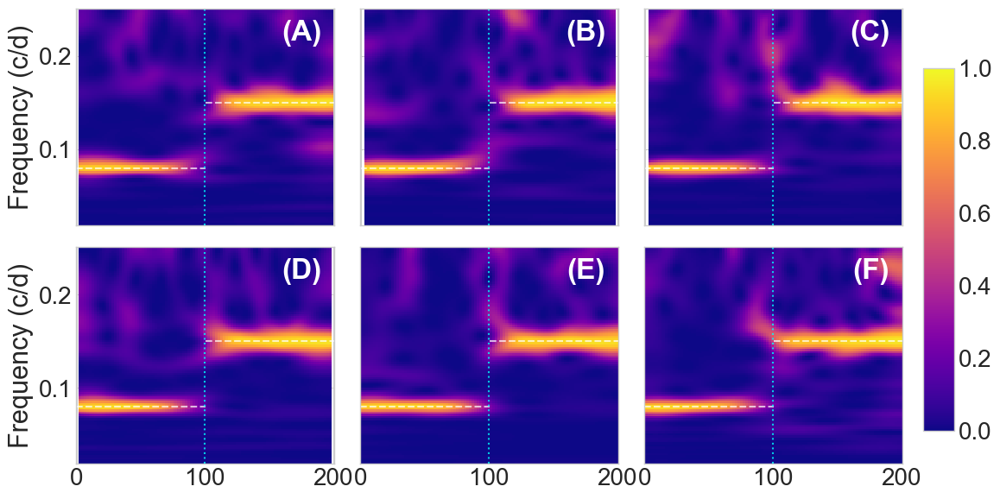

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from stockwell import st
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams.update({
    'xtick.labelsize': 20, 'ytick.labelsize': 20,
    'axes.labelsize': 22, 'axes.titlesize': 24,
})
np.random.seed(2023)


def generate_signal_with_snr(times, clean_signal_func, snr):
    signal_clean = clean_signal_func(times)
    signal_variance = np.var(signal_clean)
    if signal_variance == 0: noise_std = 1.0 
    else: noise_std = np.sqrt(signal_variance / snr)
    noise = np.random.normal(0, noise_std, len(times))
    data = signal_clean + noise
    uncertainties = np.full_like(data, noise_std)
    return data, uncertainties, signal_clean

def compute_voronoi_weights_1d(times):
    if len(times) < 2: return np.ones_like(times)
    sorted_indices = np.argsort(times); sorted_times = times[sorted_indices]
    midpoints = (sorted_times[1:] + sorted_times[:-1]) / 2.0
    start_bound = sorted_times[0] - (midpoints[0] - sorted_times[0]); end_bound = sorted_times[-1] + (sorted_times[-1] - midpoints[-1])
    bounds = np.concatenate(([start_bound], midpoints, [end_bound])); voronoi_lengths = np.diff(bounds)
    original_order_lengths = np.zeros_like(voronoi_lengths); original_order_lengths[sorted_indices] = voronoi_lengths
    return original_order_lengths

def estimate_sampling_density_kde(times, bandwidth=None):
    if len(times) < 2: return None, None
    n = len(times); std_dev = np.std(times)
    if bandwidth is None: bandwidth = 1.06 * std_dev * (n ** (-1/5))
    bw_method = bandwidth / std_dev if std_dev > 0 else 0.1
    kde = gaussian_kde(times, bw_method=bw_method)
    return kde, bandwidth

def adaptive_window_std(tau, frequency, kde, alpha=1.0, gamma=0.5):
    if frequency <= 0 or kde is None: return np.inf
    sigma_base = alpha / abs(frequency)
    if gamma == 0: return sigma_base
    local_density = max(kde(tau)[0], 1e-10)
    sigma_adaptive = sigma_base * (local_density ** (-gamma))
    return sigma_adaptive

def nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params):
    N_tau, N_freq = len(tau_grid), len(freq_grid); nust_result = np.zeros((N_tau, N_freq))
    measurement_weights = 1.0 / uncertainties**2
    use_voronoi = nust_params.get('use_voronoi_weights', True); use_adaptive = nust_params.get('use_adaptive_window', True)
    alpha = nust_params.get('alpha', 1.0); gamma = nust_params.get('gamma', 0.5); kde_bandwidth = nust_params.get('kde_bandwidth', None)
    voronoi_weights = compute_voronoi_weights_1d(times) if use_voronoi else np.ones_like(times)
    kde = None
    if use_adaptive: kde, _ = estimate_sampling_density_kde(times, bandwidth=kde_bandwidth)
    for i, tau in enumerate(tau_grid):
        for j, freq in enumerate(freq_grid):
            if freq <= 0: continue
            sigma_t = adaptive_window_std(tau, freq, kde, alpha, gamma) if use_adaptive and kde else alpha / abs(freq)
            gaussian_weights = np.exp(-0.5 * ((times - tau) / sigma_t)**2)
            total_weights = measurement_weights * voronoi_weights * gaussian_weights
            significant_mask = gaussian_weights > 0.001
            if np.sum(significant_mask) < 5: continue
            t_local, y_local, w_local = times[significant_mask], data[significant_mask], total_weights[significant_mask]
            omega = 2 * np.pi * freq
            try:
                A = np.vstack([np.cos(omega*t_local), np.sin(omega*t_local), np.ones_like(t_local)]).T
                W = np.diag(w_local)
                theta = np.linalg.solve(A.T @ W @ A, A.T @ W @ y_local)
                y_pred = A @ theta; ss_res = np.sum(w_local * (y_local - y_pred)**2)
                y_mean_weighted = np.sum(w_local * y_local) / np.sum(w_local)
                ss_tot = np.sum(w_local * (y_local - y_mean_weighted)**2)
                if ss_tot > 0: nust_result[i, j] = max(0, 1 - (ss_res / ss_tot))
            except (np.linalg.LinAlgError, ValueError): continue
    return nust_result

def run_robustness_test_hop_signal():
    def clean_signal_func(times):
        signal_clean = np.zeros_like(times)
        freq_before = 0.08; freq_after = 0.15; hop_time = 100.0
        mask_before = times < hop_time; mask_after = times >= hop_time
        if np.any(mask_before): signal_clean[mask_before] = 0.8 * np.sin(2 * np.pi * freq_before * times[mask_before])
        if np.any(mask_after): signal_clean[mask_after] = 0.8 * np.sin(2 * np.pi * freq_after * times[mask_after])
        return signal_clean

    # --- B. Generator with PURELY RANDOM Sampling ---
    def generate_randomly_sampled_signal(snr):
        duration = 200.0; num_points = 150
        times = np.sort(np.random.uniform(0, duration, num_points))
        data, uncertainties, _ = generate_signal_with_snr(times, clean_signal_func, snr)
        return times, data, uncertainties

    # --- C. Analysis and Plotting ---
    num_runs = 6; snr_for_test = 10.0

    fig, axes = plt.subplots(2, 3, figsize=(12, 6), sharex=True, sharey=True)

    nust_params = {'use_voronoi_weights': True, 'use_adaptive_window': True, 'alpha': 0.13, 'gamma': 0.5, 'kde_bandwidth': 15.0}
    freq_grid = np.linspace(0.02, 0.25, 100)
    im_nust = None

    for i in range(num_runs):
        print(f"Running simulation {i + 1} of {num_runs}...")
        
        times, data, uncertainties = generate_randomly_sampled_signal(snr_for_test)
        tau_grid = np.linspace(times.min(), times.max(), 100)
        nust_power = nust(times, data, uncertainties, tau_grid, freq_grid, **nust_params)
        
        ax = axes.flat[i]
        # The ax.set_title() line has been removed as requested.
        
        im_nust = ax.pcolormesh(tau_grid, freq_grid, nust_power.T, cmap='plasma', vmin=0, vmax=1)
        
    
        ax.text(0.95, 0.95, f'({chr(65+i)})', transform=ax.transAxes, 
                fontsize=24, color='white', ha='right', va='top', fontweight='bold')
        
        # Add guide lines
        ax.axhline(0.08, color='white', linestyle='--', alpha=0.7, xmax=0.5)
        ax.axhline(0.15, color='white', linestyle='--', alpha=0.7, xmin=0.5)
        ax.axvline(100.0, color='cyan', linestyle=':', alpha=0.8)
        
        # Corrected logic for placing axis labels on a 3x3 grid
        if i % 3 == 0:
            ax.set_ylabel("Frequency (c/d)")
        if i >= 6:
            ax.set_xlabel("Time (days)")

    plt.tight_layout(pad=1.5) 
    fig.subplots_adjust(right=0.88, hspace=0.1, wspace=0.1)
    
    cbar_ax = fig.add_axes([0.9, 0.15, 0.03, 0.7])
    if im_nust: fig.colorbar(im_nust, cax=cbar_ax)
        
    plt.savefig("sig5_robustness_test42.png", dpi=300, bbox_inches="tight")
    plt.show()

run_robustness_test_hop_signal()
